# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

하위 디렉터리 또는 파일 data이(가) 이미 있습니다.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

In [5]:
print(type(trainset))
print(type(testset))

<class 'dict'>
<class 'dict'>


In [6]:
for k, v in trainset.items():
    print(k)
for k, v in testset.items():
    print(k)

X
__header__
y
__globals__
__version__
X
__header__
y
__globals__
__version__


In [7]:
for k, v in trainset.items():
    print('{}: type {}'.format(k, type(v)))

X: type <class 'numpy.ndarray'>
__header__: type <class 'bytes'>
y: type <class 'numpy.ndarray'>
__globals__: type <class 'list'>
__version__: type <class 'str'>


In [8]:
print('trainset_X shape: {}'.format(trainset['X'].shape))
print('trainset_y shape: {}'.format(trainset['y'].shape))
print('testset_X shape: {}'.format(testset['X'].shape))
print('testset_y shape: {}'.format(testset['y'].shape))

trainset_X shape: (32, 32, 3, 73257)
trainset_y shape: (73257, 1)
testset_X shape: (32, 32, 3, 26032)
testset_y shape: (26032, 1)


Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

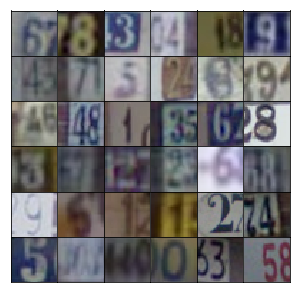

In [9]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [10]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [11]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [12]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [13]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # starting variables
        feature_map_size = 1024
        # kernel_size = 5
        # strides = 2
        
        # 1. Fully connected layer (make 4x4x1024)
        first_layer_units = 4 * 4 * feature_map_size
        x1 = tf.layers.dense(inputs=z, units=first_layer_units, activation=None, use_bias=True)
        # reshape as convolutional layer
        x1 = tf.reshape(tensor=x1, shape=[-1, 4, 4, feature_map_size])
        # add batch normalization
        x1 = tf.layers.batch_normalization(inputs=x1, training=training)
        # add reaky relu activation
        x1 = tf.maximum(alpha * x1, x1)        
        
        # 2. convolutional layer (make 8x8x512)
        feature_map_size = feature_map_size // 2
        x2 = tf.layers.conv2d_transpose(inputs=x1, filters=feature_map_size, kernel_size=5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(inputs=x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        # 3. convolutional layer (make 16x16x256)
        feature_map_size = feature_map_size // 2
        x3 = tf.layers.conv2d_transpose(inputs=x2, filters=feature_map_size, kernel_size=5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(inputs=x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
#         # 4. convolutional layer (make 32x32x128)
#         feature_map_size = feature_map_size // 2
#         x4 = tf.layers.conv2d_transpose(inputs=x3, filters=feature_map_size, kernel_size=5, strides=2, padding='same')
#         x4 = tf.layers.batch_normalization(inputs=x4, training=training)
#         x4 = tf.maximum(alpha * x4, x4)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(inputs=x3, filters=output_dim, kernel_size=5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [14]:
def discriminator(x, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('discriminator', reuse=reuse):
        # starting variable
        filters = 64
        # Input layer is 32x32x3
        
        # make 16x16x64
        x1 = tf.layers.conv2d(inputs=x, filters=filters, kernel_size=5, strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        
        # make 8x8x128
        filters = filters * 2
        x2 = tf.layers.conv2d(inputs=x1, filters=filters, kernel_size=5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(inputs=x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        # make 4x4x256
        filters = filters * 2
        x3 = tf.layers.conv2d(inputs=x2, filters=filters, kernel_size=5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(inputs=x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        # flatten the layer
        flattened_layer = tf.reshape(tensor=x3, shape=[-1, 4*4*filters])
        logits = tf.layers.dense(inputs=flattened_layer, units=1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [15]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [16]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [17]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [18]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
    
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [19]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [20]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 30
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/30... Discriminator Loss: 2.0315... Generator Loss: 0.3621
Epoch 1/30... Discriminator Loss: 0.5581... Generator Loss: 1.4257
Epoch 1/30... Discriminator Loss: 0.5874... Generator Loss: 0.9753
Epoch 1/30... Discriminator Loss: 0.3385... Generator Loss: 1.5795
Epoch 1/30... Discriminator Loss: 0.3402... Generator Loss: 1.7059
Epoch 1/30... Discriminator Loss: 0.1608... Generator Loss: 2.2973
Epoch 1/30... Discriminator Loss: 0.1058... Generator Loss: 3.2996
Epoch 1/30... Discriminator Loss: 0.1757... Generator Loss: 2.5101
Epoch 1/30... Discriminator Loss: 0.1996... Generator Loss: 2.1918
Epoch 1/30... Discriminator Loss: 0.2144... Generator Loss: 2.3511


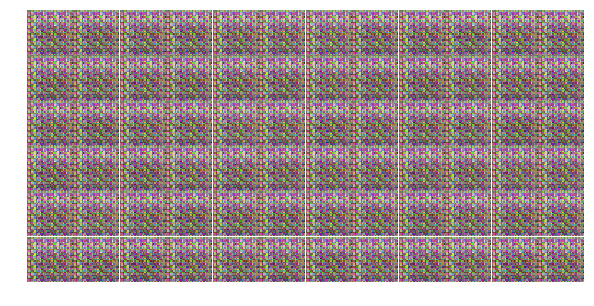

Epoch 1/30... Discriminator Loss: 0.1864... Generator Loss: 2.5938
Epoch 1/30... Discriminator Loss: 0.1909... Generator Loss: 3.7297
Epoch 1/30... Discriminator Loss: 0.0859... Generator Loss: 3.1895
Epoch 1/30... Discriminator Loss: 0.3530... Generator Loss: 2.0098
Epoch 1/30... Discriminator Loss: 1.3036... Generator Loss: 1.2537
Epoch 1/30... Discriminator Loss: 1.2725... Generator Loss: 0.7270
Epoch 1/30... Discriminator Loss: 0.5684... Generator Loss: 1.8094
Epoch 1/30... Discriminator Loss: 0.4718... Generator Loss: 2.1894
Epoch 1/30... Discriminator Loss: 0.6197... Generator Loss: 1.9388
Epoch 1/30... Discriminator Loss: 0.8085... Generator Loss: 0.9694


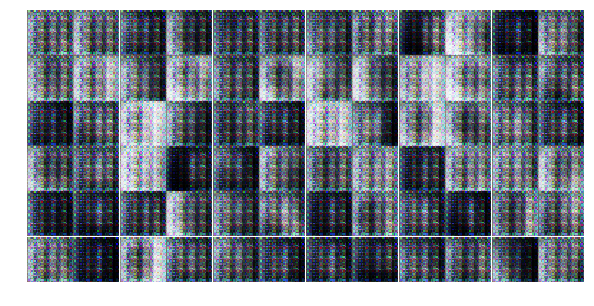

Epoch 1/30... Discriminator Loss: 0.5112... Generator Loss: 1.2349
Epoch 1/30... Discriminator Loss: 0.1406... Generator Loss: 3.4062
Epoch 1/30... Discriminator Loss: 0.5387... Generator Loss: 1.0741
Epoch 1/30... Discriminator Loss: 0.3134... Generator Loss: 4.3559
Epoch 1/30... Discriminator Loss: 0.7541... Generator Loss: 5.2229
Epoch 1/30... Discriminator Loss: 1.6544... Generator Loss: 0.4728
Epoch 1/30... Discriminator Loss: 0.3984... Generator Loss: 1.8104
Epoch 1/30... Discriminator Loss: 1.0473... Generator Loss: 2.3471
Epoch 1/30... Discriminator Loss: 0.4299... Generator Loss: 2.3070
Epoch 1/30... Discriminator Loss: 0.3713... Generator Loss: 1.9792


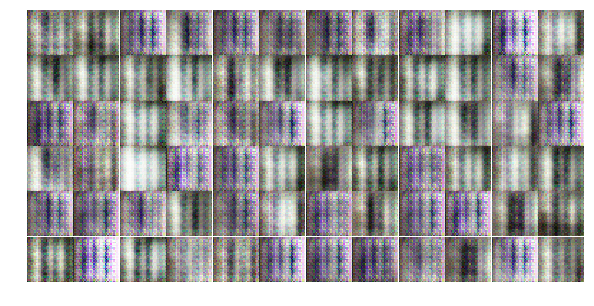

Epoch 1/30... Discriminator Loss: 1.3173... Generator Loss: 0.4610
Epoch 1/30... Discriminator Loss: 0.4522... Generator Loss: 2.4463
Epoch 1/30... Discriminator Loss: 0.9753... Generator Loss: 1.0261
Epoch 1/30... Discriminator Loss: 1.0364... Generator Loss: 1.5889
Epoch 1/30... Discriminator Loss: 0.7704... Generator Loss: 1.8900
Epoch 1/30... Discriminator Loss: 0.5352... Generator Loss: 1.4523
Epoch 1/30... Discriminator Loss: 0.9076... Generator Loss: 0.8519
Epoch 1/30... Discriminator Loss: 1.0844... Generator Loss: 2.6556
Epoch 1/30... Discriminator Loss: 0.7147... Generator Loss: 2.3963
Epoch 1/30... Discriminator Loss: 0.6630... Generator Loss: 1.9169


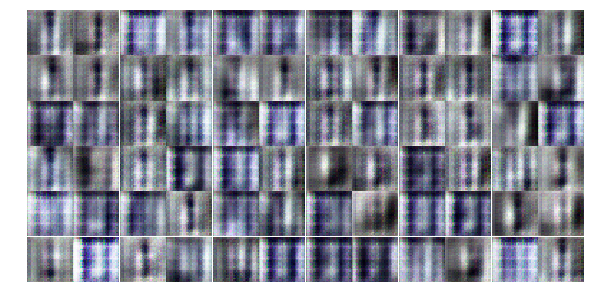

Epoch 1/30... Discriminator Loss: 0.5251... Generator Loss: 1.2347
Epoch 1/30... Discriminator Loss: 1.1886... Generator Loss: 2.8366
Epoch 1/30... Discriminator Loss: 1.6229... Generator Loss: 0.5869
Epoch 1/30... Discriminator Loss: 0.9623... Generator Loss: 1.2415
Epoch 1/30... Discriminator Loss: 1.3204... Generator Loss: 0.8173
Epoch 1/30... Discriminator Loss: 0.9361... Generator Loss: 1.3584
Epoch 1/30... Discriminator Loss: 1.0602... Generator Loss: 0.9893
Epoch 1/30... Discriminator Loss: 0.5504... Generator Loss: 2.1383
Epoch 1/30... Discriminator Loss: 1.0195... Generator Loss: 0.8574
Epoch 1/30... Discriminator Loss: 2.1710... Generator Loss: 0.1805


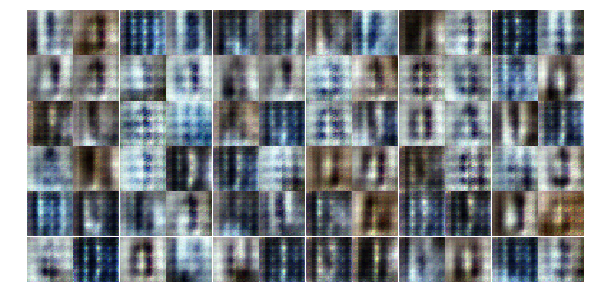

Epoch 1/30... Discriminator Loss: 1.1986... Generator Loss: 0.8537
Epoch 1/30... Discriminator Loss: 1.3169... Generator Loss: 0.7525
Epoch 1/30... Discriminator Loss: 0.9834... Generator Loss: 1.0643
Epoch 1/30... Discriminator Loss: 0.9703... Generator Loss: 0.9548
Epoch 1/30... Discriminator Loss: 0.5949... Generator Loss: 2.3216
Epoch 1/30... Discriminator Loss: 1.2577... Generator Loss: 0.5601
Epoch 1/30... Discriminator Loss: 1.1895... Generator Loss: 0.5500
Epoch 2/30... Discriminator Loss: 0.6887... Generator Loss: 1.4726
Epoch 2/30... Discriminator Loss: 0.2636... Generator Loss: 2.4346
Epoch 2/30... Discriminator Loss: 0.8125... Generator Loss: 1.1553


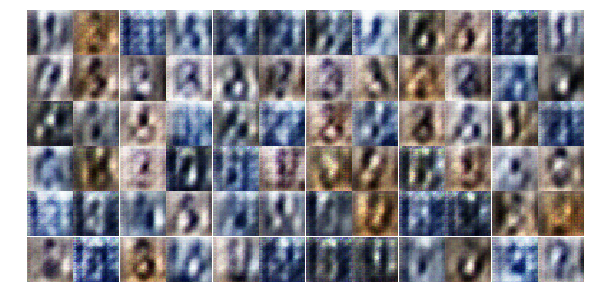

Epoch 2/30... Discriminator Loss: 0.6429... Generator Loss: 2.0776
Epoch 2/30... Discriminator Loss: 1.5377... Generator Loss: 3.6388
Epoch 2/30... Discriminator Loss: 1.5131... Generator Loss: 0.8040
Epoch 2/30... Discriminator Loss: 2.1334... Generator Loss: 0.1813
Epoch 2/30... Discriminator Loss: 1.4922... Generator Loss: 0.6966
Epoch 2/30... Discriminator Loss: 0.5608... Generator Loss: 2.0377
Epoch 2/30... Discriminator Loss: 0.8511... Generator Loss: 1.3248
Epoch 2/30... Discriminator Loss: 0.7249... Generator Loss: 2.8627
Epoch 2/30... Discriminator Loss: 1.1092... Generator Loss: 0.6204
Epoch 2/30... Discriminator Loss: 1.2443... Generator Loss: 1.0777


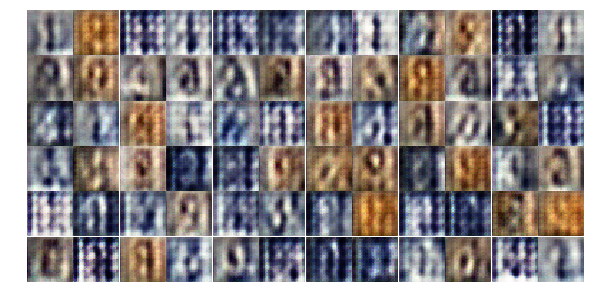

Epoch 2/30... Discriminator Loss: 1.0825... Generator Loss: 0.9387
Epoch 2/30... Discriminator Loss: 0.9259... Generator Loss: 1.3869
Epoch 2/30... Discriminator Loss: 1.2750... Generator Loss: 0.5376
Epoch 2/30... Discriminator Loss: 1.0579... Generator Loss: 1.0497
Epoch 2/30... Discriminator Loss: 1.0937... Generator Loss: 1.2848
Epoch 2/30... Discriminator Loss: 1.0189... Generator Loss: 1.1078
Epoch 2/30... Discriminator Loss: 1.5654... Generator Loss: 0.4136
Epoch 2/30... Discriminator Loss: 0.7651... Generator Loss: 1.6860
Epoch 2/30... Discriminator Loss: 0.8896... Generator Loss: 0.9669
Epoch 2/30... Discriminator Loss: 0.7013... Generator Loss: 1.1122


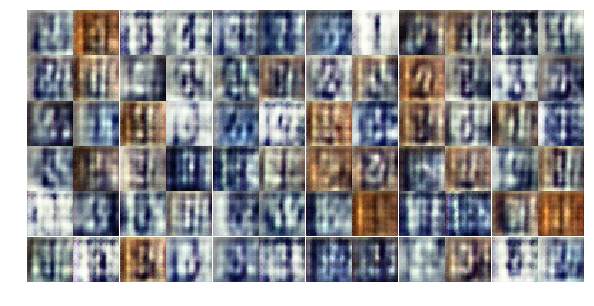

Epoch 2/30... Discriminator Loss: 1.3699... Generator Loss: 0.7944
Epoch 2/30... Discriminator Loss: 2.2041... Generator Loss: 0.4156
Epoch 2/30... Discriminator Loss: 0.7687... Generator Loss: 1.4779
Epoch 2/30... Discriminator Loss: 1.0724... Generator Loss: 0.9389
Epoch 2/30... Discriminator Loss: 0.9927... Generator Loss: 1.0569
Epoch 2/30... Discriminator Loss: 1.0315... Generator Loss: 1.0900
Epoch 2/30... Discriminator Loss: 1.1380... Generator Loss: 1.0684
Epoch 2/30... Discriminator Loss: 1.0683... Generator Loss: 0.9778
Epoch 2/30... Discriminator Loss: 1.3501... Generator Loss: 0.9313
Epoch 2/30... Discriminator Loss: 1.2674... Generator Loss: 0.8209


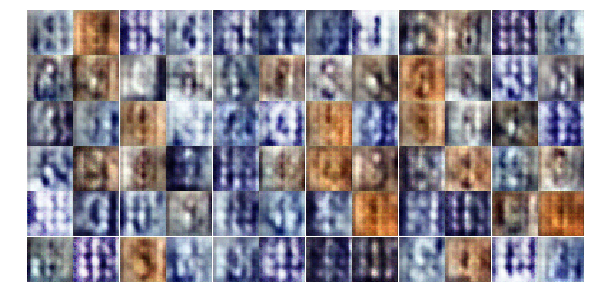

Epoch 2/30... Discriminator Loss: 1.1817... Generator Loss: 0.8209
Epoch 2/30... Discriminator Loss: 1.0916... Generator Loss: 1.0935
Epoch 2/30... Discriminator Loss: 1.1345... Generator Loss: 1.0426
Epoch 2/30... Discriminator Loss: 0.9948... Generator Loss: 0.9849
Epoch 2/30... Discriminator Loss: 0.8737... Generator Loss: 1.0185
Epoch 2/30... Discriminator Loss: 0.7365... Generator Loss: 1.5013
Epoch 2/30... Discriminator Loss: 1.1288... Generator Loss: 1.4052
Epoch 2/30... Discriminator Loss: 0.9356... Generator Loss: 0.8860
Epoch 2/30... Discriminator Loss: 0.7960... Generator Loss: 1.4058
Epoch 2/30... Discriminator Loss: 1.1920... Generator Loss: 0.8271


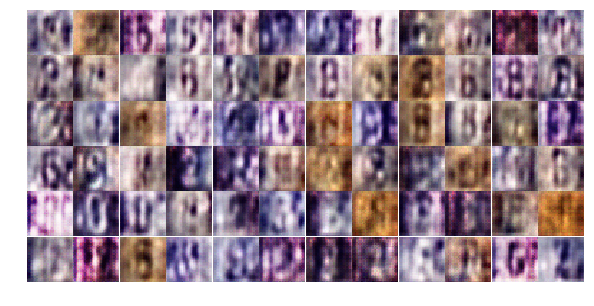

Epoch 2/30... Discriminator Loss: 0.9056... Generator Loss: 1.2855
Epoch 2/30... Discriminator Loss: 1.3529... Generator Loss: 0.7702
Epoch 2/30... Discriminator Loss: 0.6780... Generator Loss: 1.2799
Epoch 2/30... Discriminator Loss: 0.6869... Generator Loss: 1.6575
Epoch 2/30... Discriminator Loss: 1.0733... Generator Loss: 2.3028
Epoch 2/30... Discriminator Loss: 1.3469... Generator Loss: 0.8442
Epoch 2/30... Discriminator Loss: 1.1540... Generator Loss: 2.1232
Epoch 2/30... Discriminator Loss: 1.1050... Generator Loss: 0.9390
Epoch 2/30... Discriminator Loss: 0.6676... Generator Loss: 1.4882
Epoch 2/30... Discriminator Loss: 0.6628... Generator Loss: 3.5301


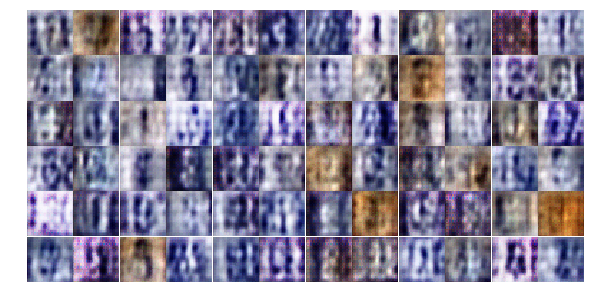

Epoch 2/30... Discriminator Loss: 0.7741... Generator Loss: 0.9794
Epoch 2/30... Discriminator Loss: 0.7097... Generator Loss: 1.3139
Epoch 2/30... Discriminator Loss: 1.2630... Generator Loss: 1.2656
Epoch 2/30... Discriminator Loss: 1.2186... Generator Loss: 0.9715
Epoch 3/30... Discriminator Loss: 0.8087... Generator Loss: 1.9029
Epoch 3/30... Discriminator Loss: 0.4612... Generator Loss: 3.1230
Epoch 3/30... Discriminator Loss: 1.3078... Generator Loss: 0.4801
Epoch 3/30... Discriminator Loss: 1.4343... Generator Loss: 0.6542
Epoch 3/30... Discriminator Loss: 1.4721... Generator Loss: 0.7843
Epoch 3/30... Discriminator Loss: 1.4376... Generator Loss: 0.9265


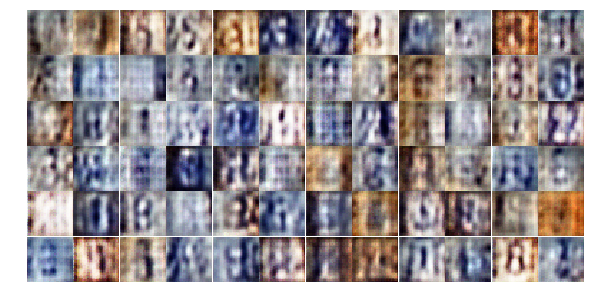

Epoch 3/30... Discriminator Loss: 0.5998... Generator Loss: 1.6352
Epoch 3/30... Discriminator Loss: 0.5437... Generator Loss: 1.5850
Epoch 3/30... Discriminator Loss: 1.3059... Generator Loss: 0.6716
Epoch 3/30... Discriminator Loss: 0.6349... Generator Loss: 1.1827
Epoch 3/30... Discriminator Loss: 1.5988... Generator Loss: 2.0433
Epoch 3/30... Discriminator Loss: 1.0765... Generator Loss: 1.0459
Epoch 3/30... Discriminator Loss: 1.4954... Generator Loss: 3.2926
Epoch 3/30... Discriminator Loss: 1.1146... Generator Loss: 0.8668
Epoch 3/30... Discriminator Loss: 1.6569... Generator Loss: 0.3613
Epoch 3/30... Discriminator Loss: 1.9158... Generator Loss: 0.5467


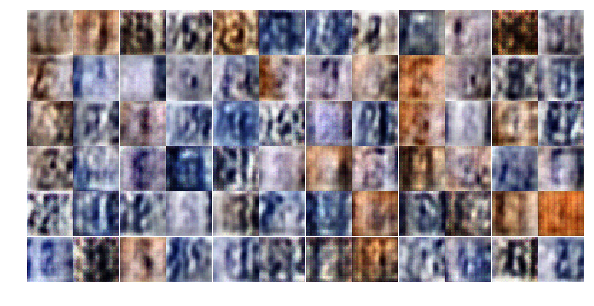

Epoch 3/30... Discriminator Loss: 1.4803... Generator Loss: 0.6342
Epoch 3/30... Discriminator Loss: 1.1647... Generator Loss: 0.8226
Epoch 3/30... Discriminator Loss: 0.8681... Generator Loss: 1.6177
Epoch 3/30... Discriminator Loss: 2.0762... Generator Loss: 0.2226
Epoch 3/30... Discriminator Loss: 0.7548... Generator Loss: 1.2675
Epoch 3/30... Discriminator Loss: 0.6768... Generator Loss: 1.6242
Epoch 3/30... Discriminator Loss: 1.5882... Generator Loss: 0.3486
Epoch 3/30... Discriminator Loss: 1.0434... Generator Loss: 0.9052
Epoch 3/30... Discriminator Loss: 0.9193... Generator Loss: 0.8017
Epoch 3/30... Discriminator Loss: 1.5232... Generator Loss: 0.7999


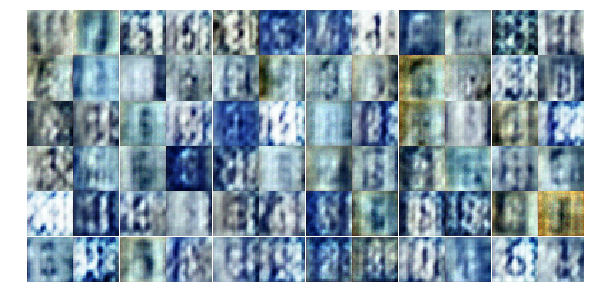

Epoch 3/30... Discriminator Loss: 1.4951... Generator Loss: 0.6413
Epoch 3/30... Discriminator Loss: 1.0522... Generator Loss: 1.0169
Epoch 3/30... Discriminator Loss: 1.4617... Generator Loss: 0.6742
Epoch 3/30... Discriminator Loss: 1.4312... Generator Loss: 0.7666
Epoch 3/30... Discriminator Loss: 1.2468... Generator Loss: 0.8572
Epoch 3/30... Discriminator Loss: 1.0277... Generator Loss: 1.1041
Epoch 3/30... Discriminator Loss: 1.2964... Generator Loss: 0.5503
Epoch 3/30... Discriminator Loss: 1.1037... Generator Loss: 0.7789
Epoch 3/30... Discriminator Loss: 1.5065... Generator Loss: 0.4846
Epoch 3/30... Discriminator Loss: 1.0854... Generator Loss: 0.7505


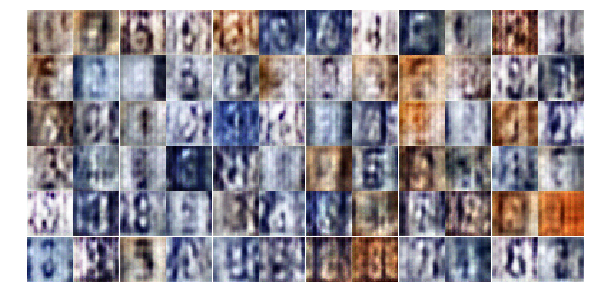

Epoch 3/30... Discriminator Loss: 0.6496... Generator Loss: 1.4210
Epoch 3/30... Discriminator Loss: 0.6771... Generator Loss: 1.4505
Epoch 3/30... Discriminator Loss: 1.1797... Generator Loss: 1.5234
Epoch 3/30... Discriminator Loss: 1.6727... Generator Loss: 1.6317
Epoch 3/30... Discriminator Loss: 1.3972... Generator Loss: 0.9745
Epoch 3/30... Discriminator Loss: 1.2792... Generator Loss: 0.7631
Epoch 3/30... Discriminator Loss: 0.8149... Generator Loss: 1.4106
Epoch 3/30... Discriminator Loss: 1.0729... Generator Loss: 1.1330
Epoch 3/30... Discriminator Loss: 1.0956... Generator Loss: 1.2394
Epoch 3/30... Discriminator Loss: 1.2989... Generator Loss: 0.5703


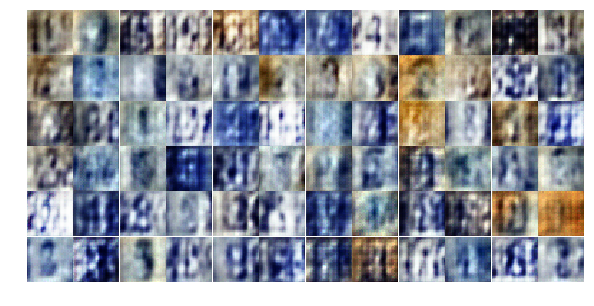

Epoch 3/30... Discriminator Loss: 1.1241... Generator Loss: 1.2807
Epoch 3/30... Discriminator Loss: 1.4900... Generator Loss: 1.2485
Epoch 3/30... Discriminator Loss: 1.2539... Generator Loss: 0.5374
Epoch 3/30... Discriminator Loss: 1.2638... Generator Loss: 1.0412
Epoch 3/30... Discriminator Loss: 0.9910... Generator Loss: 0.8350
Epoch 3/30... Discriminator Loss: 0.4878... Generator Loss: 1.6001
Epoch 3/30... Discriminator Loss: 1.3668... Generator Loss: 0.7355
Epoch 3/30... Discriminator Loss: 1.1805... Generator Loss: 0.8512
Epoch 3/30... Discriminator Loss: 0.5844... Generator Loss: 2.4330
Epoch 3/30... Discriminator Loss: 1.3097... Generator Loss: 0.7695


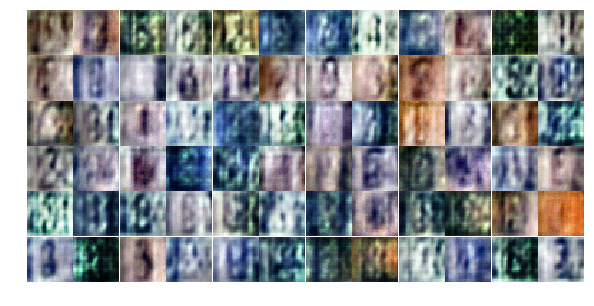

Epoch 3/30... Discriminator Loss: 1.7151... Generator Loss: 0.5075
Epoch 4/30... Discriminator Loss: 1.3403... Generator Loss: 0.7481
Epoch 4/30... Discriminator Loss: 1.2969... Generator Loss: 0.8749
Epoch 4/30... Discriminator Loss: 1.2300... Generator Loss: 0.7198
Epoch 4/30... Discriminator Loss: 0.7950... Generator Loss: 1.7399
Epoch 4/30... Discriminator Loss: 1.1948... Generator Loss: 0.9683
Epoch 4/30... Discriminator Loss: 1.1176... Generator Loss: 0.9520
Epoch 4/30... Discriminator Loss: 1.4498... Generator Loss: 0.4567
Epoch 4/30... Discriminator Loss: 1.2602... Generator Loss: 0.4577
Epoch 4/30... Discriminator Loss: 0.9356... Generator Loss: 1.1982


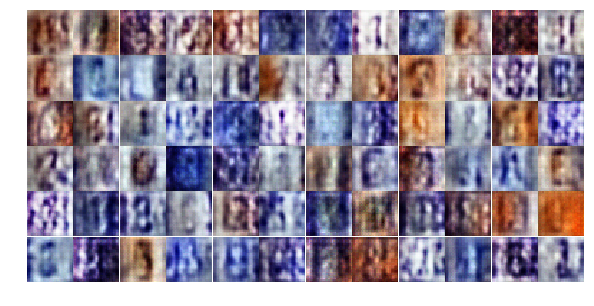

Epoch 4/30... Discriminator Loss: 0.8729... Generator Loss: 0.7299
Epoch 4/30... Discriminator Loss: 0.9837... Generator Loss: 1.0917
Epoch 4/30... Discriminator Loss: 1.3377... Generator Loss: 0.8103
Epoch 4/30... Discriminator Loss: 1.2993... Generator Loss: 0.8476
Epoch 4/30... Discriminator Loss: 1.1120... Generator Loss: 0.7214
Epoch 4/30... Discriminator Loss: 1.0614... Generator Loss: 0.6451
Epoch 4/30... Discriminator Loss: 0.8498... Generator Loss: 1.0632
Epoch 4/30... Discriminator Loss: 0.4841... Generator Loss: 2.1386
Epoch 4/30... Discriminator Loss: 0.8731... Generator Loss: 1.3412
Epoch 4/30... Discriminator Loss: 1.0935... Generator Loss: 0.8527


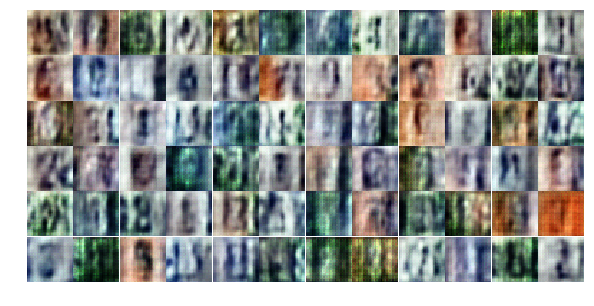

Epoch 4/30... Discriminator Loss: 1.2306... Generator Loss: 0.8802
Epoch 4/30... Discriminator Loss: 1.3473... Generator Loss: 0.8343
Epoch 4/30... Discriminator Loss: 0.6450... Generator Loss: 1.4003
Epoch 4/30... Discriminator Loss: 1.1212... Generator Loss: 0.9941
Epoch 4/30... Discriminator Loss: 0.2370... Generator Loss: 1.8219
Epoch 4/30... Discriminator Loss: 0.1546... Generator Loss: 2.6288
Epoch 4/30... Discriminator Loss: 1.1258... Generator Loss: 0.8876
Epoch 4/30... Discriminator Loss: 1.1901... Generator Loss: 0.8496
Epoch 4/30... Discriminator Loss: 1.3881... Generator Loss: 0.9575
Epoch 4/30... Discriminator Loss: 1.4236... Generator Loss: 0.8283


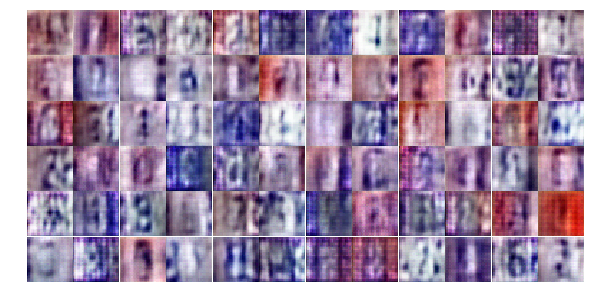

Epoch 4/30... Discriminator Loss: 0.5384... Generator Loss: 1.1276
Epoch 4/30... Discriminator Loss: 0.1772... Generator Loss: 2.5577
Epoch 4/30... Discriminator Loss: 0.9858... Generator Loss: 0.7386
Epoch 4/30... Discriminator Loss: 0.8798... Generator Loss: 1.0011
Epoch 4/30... Discriminator Loss: 1.1150... Generator Loss: 0.9643
Epoch 4/30... Discriminator Loss: 1.2443... Generator Loss: 0.7627
Epoch 4/30... Discriminator Loss: 0.9144... Generator Loss: 0.6993
Epoch 4/30... Discriminator Loss: 1.2456... Generator Loss: 0.7407
Epoch 4/30... Discriminator Loss: 1.5199... Generator Loss: 0.6975
Epoch 4/30... Discriminator Loss: 1.5007... Generator Loss: 0.7134


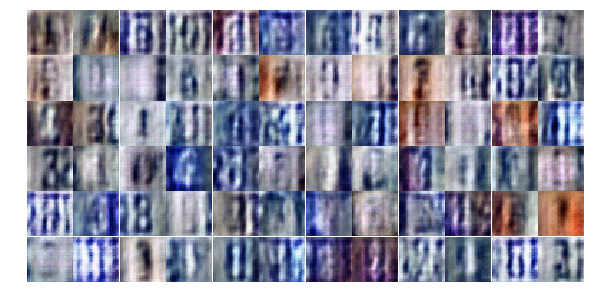

Epoch 4/30... Discriminator Loss: 1.2300... Generator Loss: 0.8580
Epoch 4/30... Discriminator Loss: 1.1537... Generator Loss: 0.9086
Epoch 4/30... Discriminator Loss: 1.3580... Generator Loss: 0.7338
Epoch 4/30... Discriminator Loss: 1.0426... Generator Loss: 0.5907
Epoch 4/30... Discriminator Loss: 1.1452... Generator Loss: 0.8057
Epoch 4/30... Discriminator Loss: 1.0207... Generator Loss: 1.1025
Epoch 4/30... Discriminator Loss: 0.9304... Generator Loss: 0.9147
Epoch 4/30... Discriminator Loss: 1.2621... Generator Loss: 0.6255
Epoch 4/30... Discriminator Loss: 1.0743... Generator Loss: 0.8746
Epoch 4/30... Discriminator Loss: 0.9836... Generator Loss: 0.9872


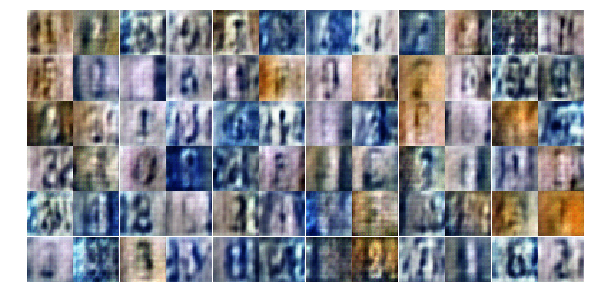

Epoch 4/30... Discriminator Loss: 0.6315... Generator Loss: 1.0558
Epoch 4/30... Discriminator Loss: 0.5641... Generator Loss: 1.4467
Epoch 4/30... Discriminator Loss: 0.9255... Generator Loss: 0.9847
Epoch 4/30... Discriminator Loss: 0.8642... Generator Loss: 1.3969
Epoch 4/30... Discriminator Loss: 1.3087... Generator Loss: 0.5426
Epoch 4/30... Discriminator Loss: 0.8290... Generator Loss: 0.8684
Epoch 4/30... Discriminator Loss: 1.1600... Generator Loss: 0.9090
Epoch 4/30... Discriminator Loss: 1.5017... Generator Loss: 0.5228
Epoch 4/30... Discriminator Loss: 1.2421... Generator Loss: 0.8792
Epoch 5/30... Discriminator Loss: 1.3475... Generator Loss: 0.8208


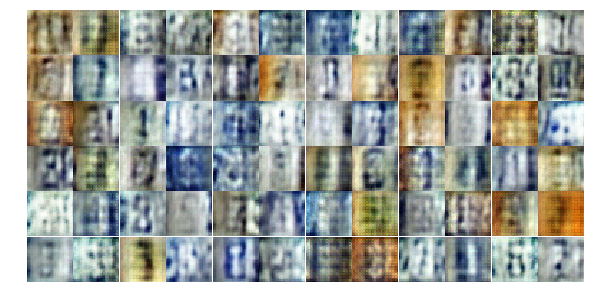

Epoch 5/30... Discriminator Loss: 1.1869... Generator Loss: 0.8251
Epoch 5/30... Discriminator Loss: 1.0983... Generator Loss: 0.7543
Epoch 5/30... Discriminator Loss: 0.6722... Generator Loss: 0.8991
Epoch 5/30... Discriminator Loss: 0.7170... Generator Loss: 0.9254
Epoch 5/30... Discriminator Loss: 0.7902... Generator Loss: 1.2616
Epoch 5/30... Discriminator Loss: 1.1099... Generator Loss: 0.8521
Epoch 5/30... Discriminator Loss: 1.1886... Generator Loss: 0.7637
Epoch 5/30... Discriminator Loss: 1.4144... Generator Loss: 0.3722
Epoch 5/30... Discriminator Loss: 1.3565... Generator Loss: 2.0528
Epoch 5/30... Discriminator Loss: 1.1667... Generator Loss: 1.0394


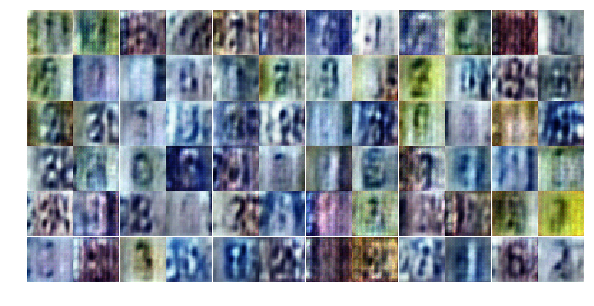

Epoch 5/30... Discriminator Loss: 1.0401... Generator Loss: 0.9698
Epoch 5/30... Discriminator Loss: 1.1121... Generator Loss: 0.9666
Epoch 5/30... Discriminator Loss: 0.8506... Generator Loss: 1.1277
Epoch 5/30... Discriminator Loss: 1.0077... Generator Loss: 0.6011
Epoch 5/30... Discriminator Loss: 0.3654... Generator Loss: 3.8363
Epoch 5/30... Discriminator Loss: 0.9780... Generator Loss: 1.4715
Epoch 5/30... Discriminator Loss: 0.9354... Generator Loss: 0.9919
Epoch 5/30... Discriminator Loss: 0.9628... Generator Loss: 0.9744
Epoch 5/30... Discriminator Loss: 0.9155... Generator Loss: 1.3623
Epoch 5/30... Discriminator Loss: 1.2529... Generator Loss: 0.6886


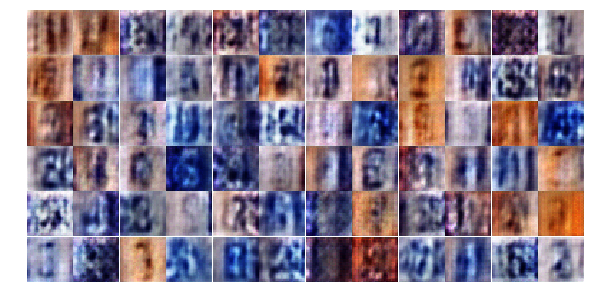

Epoch 5/30... Discriminator Loss: 0.8693... Generator Loss: 1.2571
Epoch 5/30... Discriminator Loss: 1.0488... Generator Loss: 0.8537
Epoch 5/30... Discriminator Loss: 1.1281... Generator Loss: 0.9950
Epoch 5/30... Discriminator Loss: 0.5819... Generator Loss: 1.2159
Epoch 5/30... Discriminator Loss: 1.0384... Generator Loss: 0.8402
Epoch 5/30... Discriminator Loss: 1.0863... Generator Loss: 0.8669
Epoch 5/30... Discriminator Loss: 1.0702... Generator Loss: 0.8472
Epoch 5/30... Discriminator Loss: 0.8536... Generator Loss: 0.7810
Epoch 5/30... Discriminator Loss: 1.1368... Generator Loss: 0.6683
Epoch 5/30... Discriminator Loss: 0.3344... Generator Loss: 3.1906


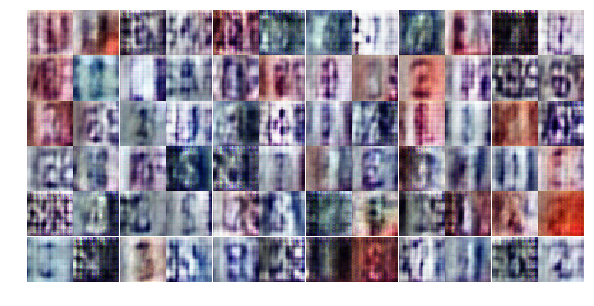

Epoch 5/30... Discriminator Loss: 0.5641... Generator Loss: 1.2052
Epoch 5/30... Discriminator Loss: 0.1757... Generator Loss: 3.1974
Epoch 5/30... Discriminator Loss: 1.0342... Generator Loss: 0.9513
Epoch 5/30... Discriminator Loss: 0.6797... Generator Loss: 1.1175
Epoch 5/30... Discriminator Loss: 0.9369... Generator Loss: 0.9891
Epoch 5/30... Discriminator Loss: 0.6256... Generator Loss: 3.9553
Epoch 5/30... Discriminator Loss: 0.7411... Generator Loss: 1.1241
Epoch 5/30... Discriminator Loss: 0.3480... Generator Loss: 2.1563
Epoch 5/30... Discriminator Loss: 0.5203... Generator Loss: 1.3087
Epoch 5/30... Discriminator Loss: 1.4428... Generator Loss: 2.0077


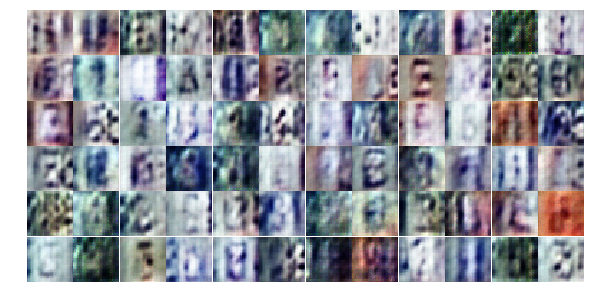

Epoch 5/30... Discriminator Loss: 0.7839... Generator Loss: 1.6078
Epoch 5/30... Discriminator Loss: 0.6794... Generator Loss: 1.3654
Epoch 5/30... Discriminator Loss: 0.8456... Generator Loss: 1.2277
Epoch 5/30... Discriminator Loss: 0.5799... Generator Loss: 1.0691
Epoch 5/30... Discriminator Loss: 0.5425... Generator Loss: 1.4767
Epoch 5/30... Discriminator Loss: 1.0635... Generator Loss: 1.0419
Epoch 5/30... Discriminator Loss: 0.8372... Generator Loss: 1.8581
Epoch 5/30... Discriminator Loss: 1.1383... Generator Loss: 0.5229
Epoch 5/30... Discriminator Loss: 1.1265... Generator Loss: 1.9947
Epoch 5/30... Discriminator Loss: 0.8449... Generator Loss: 1.2073


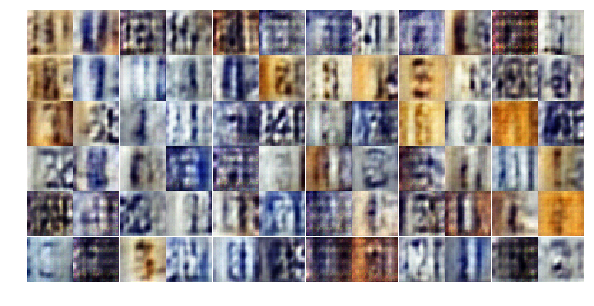

Epoch 5/30... Discriminator Loss: 0.9496... Generator Loss: 0.9904
Epoch 5/30... Discriminator Loss: 0.5467... Generator Loss: 1.4750
Epoch 5/30... Discriminator Loss: 0.8265... Generator Loss: 1.0177
Epoch 5/30... Discriminator Loss: 0.4660... Generator Loss: 3.3912
Epoch 5/30... Discriminator Loss: 1.3909... Generator Loss: 0.6359
Epoch 5/30... Discriminator Loss: 1.1444... Generator Loss: 0.8018
Epoch 6/30... Discriminator Loss: 1.1561... Generator Loss: 0.7047
Epoch 6/30... Discriminator Loss: 0.6181... Generator Loss: 1.3656
Epoch 6/30... Discriminator Loss: 0.8585... Generator Loss: 1.3075
Epoch 6/30... Discriminator Loss: 0.9606... Generator Loss: 1.0350


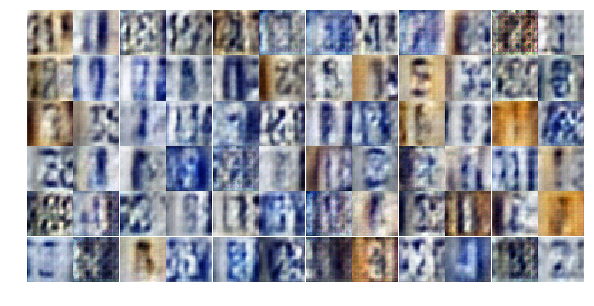

Epoch 6/30... Discriminator Loss: 0.9803... Generator Loss: 0.9969
Epoch 6/30... Discriminator Loss: 0.9395... Generator Loss: 0.9327
Epoch 6/30... Discriminator Loss: 0.4760... Generator Loss: 1.4342
Epoch 6/30... Discriminator Loss: 0.8306... Generator Loss: 1.6099
Epoch 6/30... Discriminator Loss: 0.8596... Generator Loss: 1.1616
Epoch 6/30... Discriminator Loss: 1.5078... Generator Loss: 0.3782
Epoch 6/30... Discriminator Loss: 1.1126... Generator Loss: 1.2618
Epoch 6/30... Discriminator Loss: 1.1969... Generator Loss: 0.6792
Epoch 6/30... Discriminator Loss: 0.9007... Generator Loss: 0.7574
Epoch 6/30... Discriminator Loss: 0.5060... Generator Loss: 1.6525


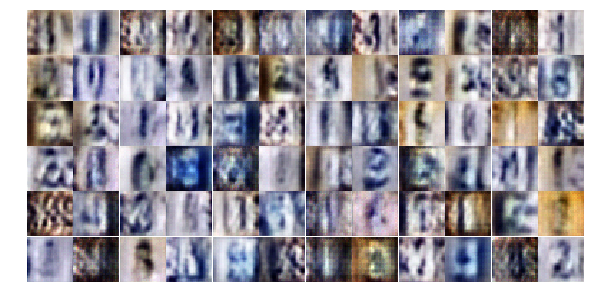

Epoch 6/30... Discriminator Loss: 0.9520... Generator Loss: 0.8506
Epoch 6/30... Discriminator Loss: 1.0863... Generator Loss: 0.9306
Epoch 6/30... Discriminator Loss: 1.6021... Generator Loss: 0.3673
Epoch 6/30... Discriminator Loss: 0.3723... Generator Loss: 2.3615
Epoch 6/30... Discriminator Loss: 0.3406... Generator Loss: 2.4717
Epoch 6/30... Discriminator Loss: 0.8984... Generator Loss: 1.2505
Epoch 6/30... Discriminator Loss: 1.0372... Generator Loss: 0.6534
Epoch 6/30... Discriminator Loss: 1.3372... Generator Loss: 2.0866
Epoch 6/30... Discriminator Loss: 1.0016... Generator Loss: 0.9485
Epoch 6/30... Discriminator Loss: 0.8884... Generator Loss: 1.1075


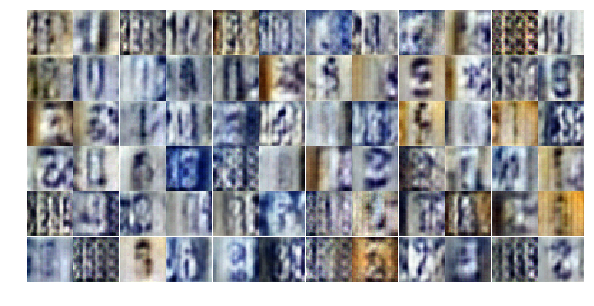

Epoch 6/30... Discriminator Loss: 0.4221... Generator Loss: 1.7659
Epoch 6/30... Discriminator Loss: 0.9586... Generator Loss: 0.6897
Epoch 6/30... Discriminator Loss: 0.7881... Generator Loss: 1.3017
Epoch 6/30... Discriminator Loss: 0.9185... Generator Loss: 0.7500
Epoch 6/30... Discriminator Loss: 0.6137... Generator Loss: 2.1102
Epoch 6/30... Discriminator Loss: 1.2679... Generator Loss: 0.5404
Epoch 6/30... Discriminator Loss: 0.8710... Generator Loss: 0.9487
Epoch 6/30... Discriminator Loss: 0.5127... Generator Loss: 1.6143
Epoch 6/30... Discriminator Loss: 0.4488... Generator Loss: 2.3076
Epoch 6/30... Discriminator Loss: 1.0673... Generator Loss: 2.0230


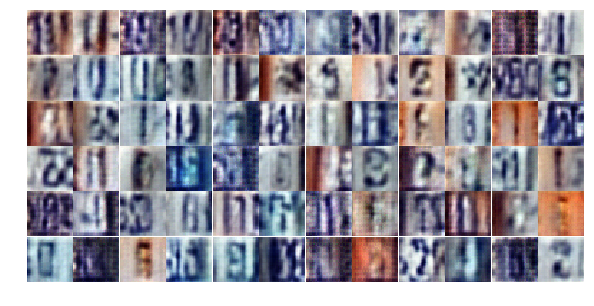

Epoch 6/30... Discriminator Loss: 0.9977... Generator Loss: 0.9063
Epoch 6/30... Discriminator Loss: 0.4765... Generator Loss: 1.8715
Epoch 6/30... Discriminator Loss: 0.3083... Generator Loss: 2.2201
Epoch 6/30... Discriminator Loss: 0.5050... Generator Loss: 1.2025
Epoch 6/30... Discriminator Loss: 0.1936... Generator Loss: 3.3322
Epoch 6/30... Discriminator Loss: 0.7004... Generator Loss: 1.3242
Epoch 6/30... Discriminator Loss: 0.9638... Generator Loss: 1.0254
Epoch 6/30... Discriminator Loss: 0.9104... Generator Loss: 1.2821
Epoch 6/30... Discriminator Loss: 0.9431... Generator Loss: 0.9248
Epoch 6/30... Discriminator Loss: 1.1508... Generator Loss: 1.8453


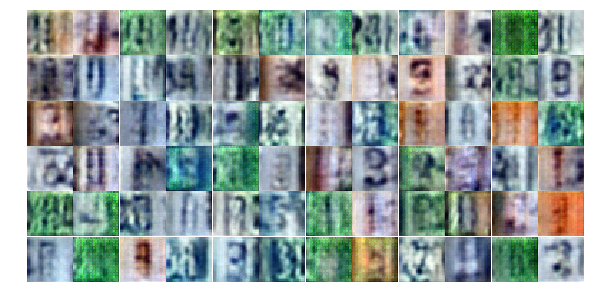

Epoch 6/30... Discriminator Loss: 1.1641... Generator Loss: 0.5141
Epoch 6/30... Discriminator Loss: 0.8237... Generator Loss: 0.8458
Epoch 6/30... Discriminator Loss: 0.8891... Generator Loss: 0.9436
Epoch 6/30... Discriminator Loss: 0.8956... Generator Loss: 1.1180
Epoch 6/30... Discriminator Loss: 1.2229... Generator Loss: 0.5558
Epoch 6/30... Discriminator Loss: 0.4392... Generator Loss: 1.5732
Epoch 6/30... Discriminator Loss: 0.5997... Generator Loss: 1.3033
Epoch 6/30... Discriminator Loss: 0.7320... Generator Loss: 1.0268
Epoch 6/30... Discriminator Loss: 1.1601... Generator Loss: 0.6729
Epoch 6/30... Discriminator Loss: 0.4809... Generator Loss: 1.4243


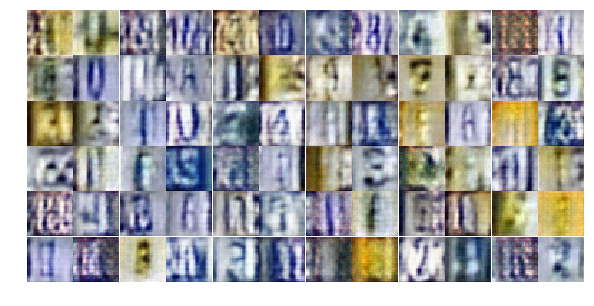

Epoch 6/30... Discriminator Loss: 1.2478... Generator Loss: 0.4514
Epoch 6/30... Discriminator Loss: 0.6869... Generator Loss: 1.2377
Epoch 6/30... Discriminator Loss: 0.3863... Generator Loss: 1.5793
Epoch 7/30... Discriminator Loss: 1.0473... Generator Loss: 0.7388
Epoch 7/30... Discriminator Loss: 1.1860... Generator Loss: 0.8536
Epoch 7/30... Discriminator Loss: 0.8000... Generator Loss: 1.0812
Epoch 7/30... Discriminator Loss: 0.9373... Generator Loss: 0.8901
Epoch 7/30... Discriminator Loss: 0.5811... Generator Loss: 1.6114
Epoch 7/30... Discriminator Loss: 0.9705... Generator Loss: 1.0414
Epoch 7/30... Discriminator Loss: 0.9377... Generator Loss: 0.9383


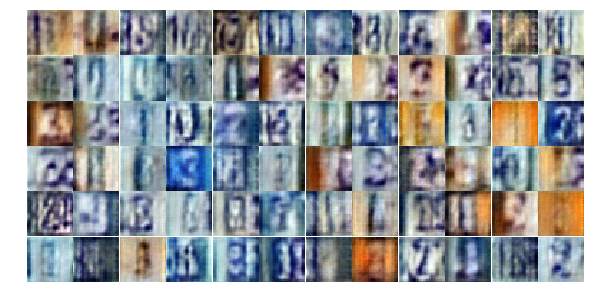

Epoch 7/30... Discriminator Loss: 0.9161... Generator Loss: 1.2362
Epoch 7/30... Discriminator Loss: 0.4434... Generator Loss: 2.2320
Epoch 7/30... Discriminator Loss: 0.8960... Generator Loss: 1.0285
Epoch 7/30... Discriminator Loss: 0.9445... Generator Loss: 1.3441
Epoch 7/30... Discriminator Loss: 1.2762... Generator Loss: 0.5581
Epoch 7/30... Discriminator Loss: 0.6258... Generator Loss: 2.5128
Epoch 7/30... Discriminator Loss: 0.4258... Generator Loss: 1.9200
Epoch 7/30... Discriminator Loss: 0.9436... Generator Loss: 1.2474
Epoch 7/30... Discriminator Loss: 0.8221... Generator Loss: 1.0914
Epoch 7/30... Discriminator Loss: 0.9931... Generator Loss: 0.9583


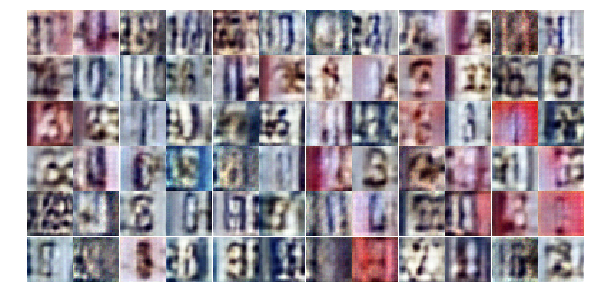

Epoch 7/30... Discriminator Loss: 0.7689... Generator Loss: 1.4172
Epoch 7/30... Discriminator Loss: 0.5268... Generator Loss: 1.4275
Epoch 7/30... Discriminator Loss: 0.7204... Generator Loss: 1.0821
Epoch 7/30... Discriminator Loss: 0.6153... Generator Loss: 1.3110
Epoch 7/30... Discriminator Loss: 0.9862... Generator Loss: 0.6393
Epoch 7/30... Discriminator Loss: 0.7839... Generator Loss: 2.3456
Epoch 7/30... Discriminator Loss: 1.1406... Generator Loss: 0.6047
Epoch 7/30... Discriminator Loss: 1.3308... Generator Loss: 0.4423
Epoch 7/30... Discriminator Loss: 0.8697... Generator Loss: 3.9505
Epoch 7/30... Discriminator Loss: 0.8897... Generator Loss: 1.3669


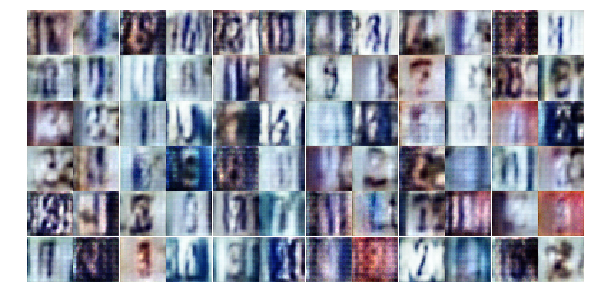

Epoch 7/30... Discriminator Loss: 0.9191... Generator Loss: 0.9081
Epoch 7/30... Discriminator Loss: 2.1682... Generator Loss: 0.1610
Epoch 7/30... Discriminator Loss: 0.8358... Generator Loss: 1.2108
Epoch 7/30... Discriminator Loss: 0.8058... Generator Loss: 2.1191
Epoch 7/30... Discriminator Loss: 0.8180... Generator Loss: 1.4145
Epoch 7/30... Discriminator Loss: 1.0612... Generator Loss: 0.8794
Epoch 7/30... Discriminator Loss: 0.7594... Generator Loss: 1.1145
Epoch 7/30... Discriminator Loss: 0.9628... Generator Loss: 1.2455
Epoch 7/30... Discriminator Loss: 1.1631... Generator Loss: 0.9461
Epoch 7/30... Discriminator Loss: 0.8490... Generator Loss: 1.1668


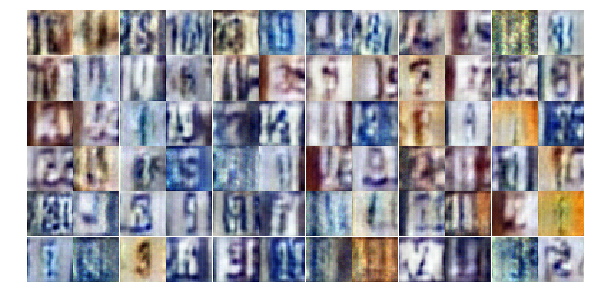

Epoch 7/30... Discriminator Loss: 1.0213... Generator Loss: 0.7352
Epoch 7/30... Discriminator Loss: 0.9218... Generator Loss: 0.9814
Epoch 7/30... Discriminator Loss: 0.5927... Generator Loss: 1.9524
Epoch 7/30... Discriminator Loss: 0.9268... Generator Loss: 0.9485
Epoch 7/30... Discriminator Loss: 1.1205... Generator Loss: 0.6457
Epoch 7/30... Discriminator Loss: 0.8581... Generator Loss: 1.5846
Epoch 7/30... Discriminator Loss: 1.1450... Generator Loss: 0.6440
Epoch 7/30... Discriminator Loss: 1.2128... Generator Loss: 0.4643
Epoch 7/30... Discriminator Loss: 0.7348... Generator Loss: 1.3785
Epoch 7/30... Discriminator Loss: 1.0220... Generator Loss: 1.1123


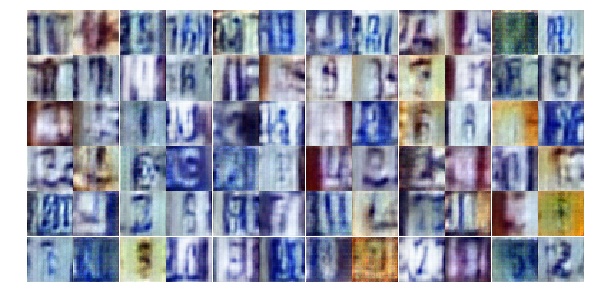

Epoch 7/30... Discriminator Loss: 0.8586... Generator Loss: 1.3303
Epoch 7/30... Discriminator Loss: 0.6040... Generator Loss: 1.7876
Epoch 7/30... Discriminator Loss: 0.6648... Generator Loss: 1.1252
Epoch 7/30... Discriminator Loss: 1.2003... Generator Loss: 0.5304
Epoch 7/30... Discriminator Loss: 1.2802... Generator Loss: 0.5476
Epoch 7/30... Discriminator Loss: 1.7599... Generator Loss: 0.2669
Epoch 7/30... Discriminator Loss: 1.3238... Generator Loss: 1.3375
Epoch 7/30... Discriminator Loss: 0.8587... Generator Loss: 0.9153
Epoch 7/30... Discriminator Loss: 0.7714... Generator Loss: 1.4822
Epoch 7/30... Discriminator Loss: 0.6997... Generator Loss: 0.8908


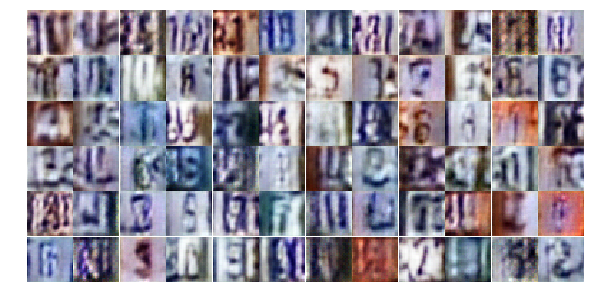

Epoch 7/30... Discriminator Loss: 0.6914... Generator Loss: 0.9394
Epoch 8/30... Discriminator Loss: 0.8230... Generator Loss: 1.4505
Epoch 8/30... Discriminator Loss: 1.0526... Generator Loss: 0.6483
Epoch 8/30... Discriminator Loss: 0.9559... Generator Loss: 0.8750
Epoch 8/30... Discriminator Loss: 1.3839... Generator Loss: 0.3800
Epoch 8/30... Discriminator Loss: 1.2348... Generator Loss: 1.5679
Epoch 8/30... Discriminator Loss: 1.1112... Generator Loss: 0.5018
Epoch 8/30... Discriminator Loss: 0.9014... Generator Loss: 1.2877
Epoch 8/30... Discriminator Loss: 0.8441... Generator Loss: 1.6081
Epoch 8/30... Discriminator Loss: 0.9233... Generator Loss: 0.7887


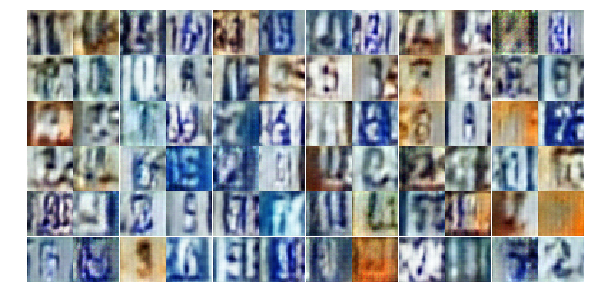

Epoch 8/30... Discriminator Loss: 0.7671... Generator Loss: 1.0237
Epoch 8/30... Discriminator Loss: 1.8063... Generator Loss: 0.5651
Epoch 8/30... Discriminator Loss: 0.7814... Generator Loss: 1.8611
Epoch 8/30... Discriminator Loss: 0.9020... Generator Loss: 1.3615
Epoch 8/30... Discriminator Loss: 1.7181... Generator Loss: 0.2762
Epoch 8/30... Discriminator Loss: 0.8848... Generator Loss: 1.1188
Epoch 8/30... Discriminator Loss: 1.7917... Generator Loss: 0.2434
Epoch 8/30... Discriminator Loss: 1.1267... Generator Loss: 1.3052
Epoch 8/30... Discriminator Loss: 1.2577... Generator Loss: 0.5676
Epoch 8/30... Discriminator Loss: 1.1101... Generator Loss: 0.6646


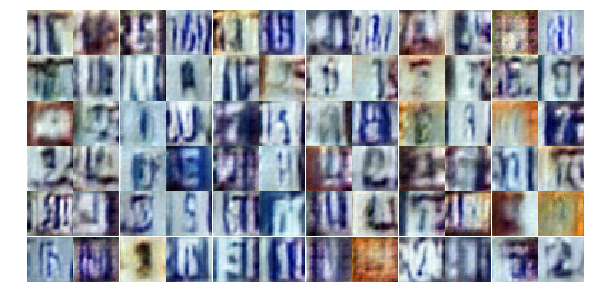

Epoch 8/30... Discriminator Loss: 0.8216... Generator Loss: 1.6141
Epoch 8/30... Discriminator Loss: 0.5273... Generator Loss: 1.6028
Epoch 8/30... Discriminator Loss: 0.9774... Generator Loss: 1.0253
Epoch 8/30... Discriminator Loss: 1.1205... Generator Loss: 0.8540
Epoch 8/30... Discriminator Loss: 0.8621... Generator Loss: 1.4855
Epoch 8/30... Discriminator Loss: 0.6242... Generator Loss: 1.0632
Epoch 8/30... Discriminator Loss: 1.1705... Generator Loss: 1.1101
Epoch 8/30... Discriminator Loss: 0.9946... Generator Loss: 1.5365
Epoch 8/30... Discriminator Loss: 0.8792... Generator Loss: 2.2020
Epoch 8/30... Discriminator Loss: 1.3541... Generator Loss: 0.4975


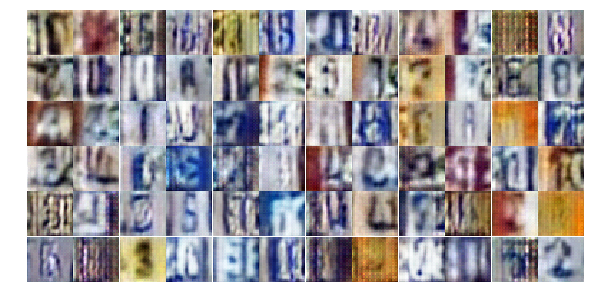

Epoch 8/30... Discriminator Loss: 0.8208... Generator Loss: 1.3827
Epoch 8/30... Discriminator Loss: 1.1250... Generator Loss: 0.7721
Epoch 8/30... Discriminator Loss: 0.8745... Generator Loss: 0.7929
Epoch 8/30... Discriminator Loss: 0.8981... Generator Loss: 0.6868
Epoch 8/30... Discriminator Loss: 0.8309... Generator Loss: 1.0532
Epoch 8/30... Discriminator Loss: 0.6220... Generator Loss: 2.7142
Epoch 8/30... Discriminator Loss: 1.0921... Generator Loss: 0.7830
Epoch 8/30... Discriminator Loss: 0.7699... Generator Loss: 0.9563
Epoch 8/30... Discriminator Loss: 0.7825... Generator Loss: 1.0360
Epoch 8/30... Discriminator Loss: 0.6313... Generator Loss: 1.4677


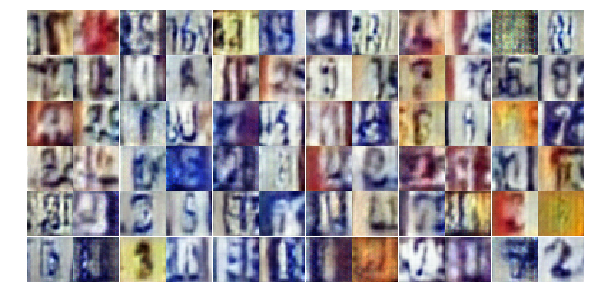

Epoch 8/30... Discriminator Loss: 0.8161... Generator Loss: 0.9284
Epoch 8/30... Discriminator Loss: 1.0709... Generator Loss: 0.6818
Epoch 8/30... Discriminator Loss: 1.0232... Generator Loss: 0.6054
Epoch 8/30... Discriminator Loss: 0.7168... Generator Loss: 1.4130
Epoch 8/30... Discriminator Loss: 1.2431... Generator Loss: 1.4623
Epoch 8/30... Discriminator Loss: 1.1742... Generator Loss: 0.6258
Epoch 8/30... Discriminator Loss: 0.7754... Generator Loss: 1.6289
Epoch 8/30... Discriminator Loss: 0.7969... Generator Loss: 1.5538
Epoch 8/30... Discriminator Loss: 1.2489... Generator Loss: 2.1014
Epoch 8/30... Discriminator Loss: 1.0653... Generator Loss: 1.3563


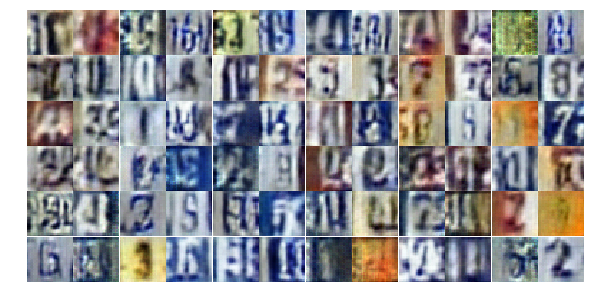

Epoch 8/30... Discriminator Loss: 1.2984... Generator Loss: 2.4548
Epoch 8/30... Discriminator Loss: 0.9054... Generator Loss: 0.9735
Epoch 8/30... Discriminator Loss: 0.7514... Generator Loss: 1.7095
Epoch 8/30... Discriminator Loss: 1.3865... Generator Loss: 0.4648
Epoch 8/30... Discriminator Loss: 0.8118... Generator Loss: 1.2771
Epoch 8/30... Discriminator Loss: 0.7842... Generator Loss: 0.9277
Epoch 8/30... Discriminator Loss: 0.7554... Generator Loss: 1.1520
Epoch 8/30... Discriminator Loss: 1.0037... Generator Loss: 1.0842
Epoch 9/30... Discriminator Loss: 0.9024... Generator Loss: 0.9198
Epoch 9/30... Discriminator Loss: 1.0862... Generator Loss: 0.7790


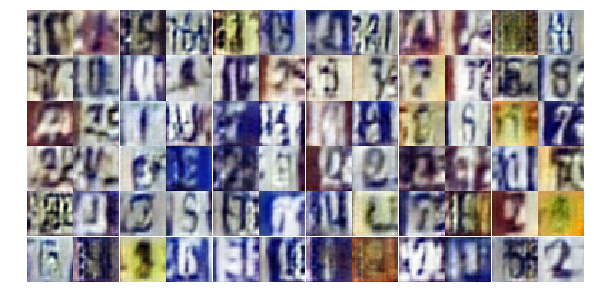

Epoch 9/30... Discriminator Loss: 1.1986... Generator Loss: 0.4893
Epoch 9/30... Discriminator Loss: 1.0328... Generator Loss: 0.6763
Epoch 9/30... Discriminator Loss: 1.1067... Generator Loss: 0.7866
Epoch 9/30... Discriminator Loss: 0.9779... Generator Loss: 0.8123
Epoch 9/30... Discriminator Loss: 0.7164... Generator Loss: 1.3716
Epoch 9/30... Discriminator Loss: 1.0017... Generator Loss: 1.7823
Epoch 9/30... Discriminator Loss: 0.7071... Generator Loss: 1.1023
Epoch 9/30... Discriminator Loss: 0.6791... Generator Loss: 1.3662
Epoch 9/30... Discriminator Loss: 1.0524... Generator Loss: 0.9520
Epoch 9/30... Discriminator Loss: 0.8829... Generator Loss: 1.2842


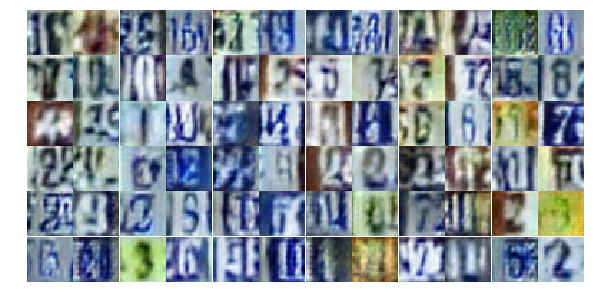

Epoch 9/30... Discriminator Loss: 0.7818... Generator Loss: 1.4535
Epoch 9/30... Discriminator Loss: 1.5855... Generator Loss: 0.3435
Epoch 9/30... Discriminator Loss: 1.0354... Generator Loss: 1.0153
Epoch 9/30... Discriminator Loss: 0.8520... Generator Loss: 0.9638
Epoch 9/30... Discriminator Loss: 0.6290... Generator Loss: 1.1484
Epoch 9/30... Discriminator Loss: 1.4555... Generator Loss: 0.4081
Epoch 9/30... Discriminator Loss: 1.1131... Generator Loss: 0.5975
Epoch 9/30... Discriminator Loss: 1.1199... Generator Loss: 0.6579
Epoch 9/30... Discriminator Loss: 1.3021... Generator Loss: 0.5514
Epoch 9/30... Discriminator Loss: 1.0232... Generator Loss: 0.6798


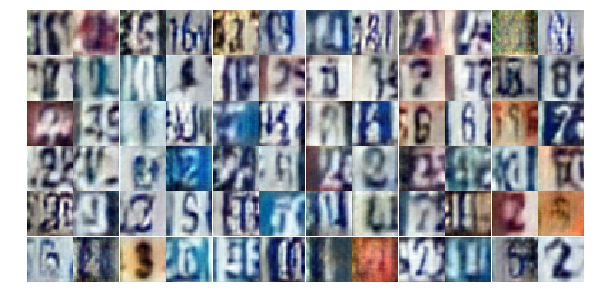

Epoch 9/30... Discriminator Loss: 1.1022... Generator Loss: 0.7328
Epoch 9/30... Discriminator Loss: 0.8147... Generator Loss: 1.0636
Epoch 9/30... Discriminator Loss: 1.0522... Generator Loss: 0.6310
Epoch 9/30... Discriminator Loss: 0.8884... Generator Loss: 2.2340
Epoch 9/30... Discriminator Loss: 0.8194... Generator Loss: 0.9001
Epoch 9/30... Discriminator Loss: 0.9062... Generator Loss: 0.8806
Epoch 9/30... Discriminator Loss: 1.0098... Generator Loss: 0.7905
Epoch 9/30... Discriminator Loss: 1.0197... Generator Loss: 1.8562
Epoch 9/30... Discriminator Loss: 0.7634... Generator Loss: 1.1015
Epoch 9/30... Discriminator Loss: 0.7186... Generator Loss: 1.0114


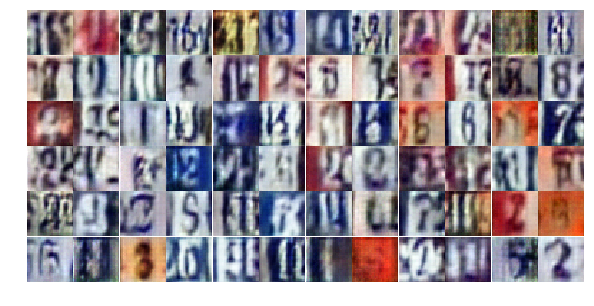

Epoch 9/30... Discriminator Loss: 1.0971... Generator Loss: 0.6414
Epoch 9/30... Discriminator Loss: 1.1166... Generator Loss: 0.6080
Epoch 9/30... Discriminator Loss: 1.0338... Generator Loss: 0.7996
Epoch 9/30... Discriminator Loss: 1.0008... Generator Loss: 0.8702
Epoch 9/30... Discriminator Loss: 0.6835... Generator Loss: 2.1784
Epoch 9/30... Discriminator Loss: 0.8374... Generator Loss: 1.5649
Epoch 9/30... Discriminator Loss: 0.9166... Generator Loss: 1.8785
Epoch 9/30... Discriminator Loss: 0.8740... Generator Loss: 0.8106
Epoch 9/30... Discriminator Loss: 1.0191... Generator Loss: 0.7401
Epoch 9/30... Discriminator Loss: 0.9346... Generator Loss: 0.6683


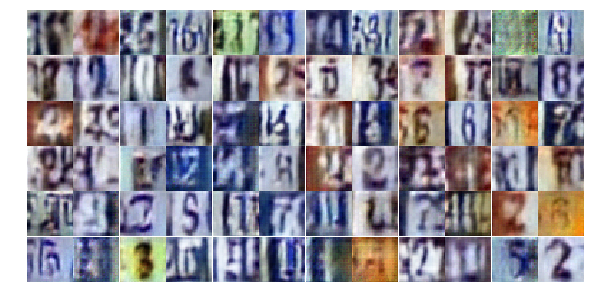

Epoch 9/30... Discriminator Loss: 0.7330... Generator Loss: 1.3844
Epoch 9/30... Discriminator Loss: 0.4428... Generator Loss: 1.6241
Epoch 9/30... Discriminator Loss: 0.9945... Generator Loss: 0.6793
Epoch 9/30... Discriminator Loss: 1.0097... Generator Loss: 1.6043
Epoch 9/30... Discriminator Loss: 0.8874... Generator Loss: 1.0598
Epoch 9/30... Discriminator Loss: 0.8315... Generator Loss: 1.6232
Epoch 9/30... Discriminator Loss: 1.0183... Generator Loss: 0.8265
Epoch 9/30... Discriminator Loss: 1.2994... Generator Loss: 0.4850
Epoch 9/30... Discriminator Loss: 0.9023... Generator Loss: 1.9813
Epoch 9/30... Discriminator Loss: 0.9727... Generator Loss: 0.7575


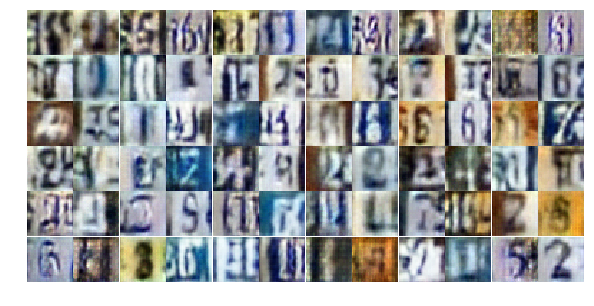

Epoch 9/30... Discriminator Loss: 1.2039... Generator Loss: 0.9062
Epoch 9/30... Discriminator Loss: 1.0037... Generator Loss: 1.9693
Epoch 9/30... Discriminator Loss: 0.7051... Generator Loss: 1.1249
Epoch 9/30... Discriminator Loss: 1.0460... Generator Loss: 0.5794
Epoch 9/30... Discriminator Loss: 1.0649... Generator Loss: 0.6217
Epoch 10/30... Discriminator Loss: 1.1038... Generator Loss: 0.6122
Epoch 10/30... Discriminator Loss: 0.7870... Generator Loss: 0.9458
Epoch 10/30... Discriminator Loss: 0.9175... Generator Loss: 0.7105
Epoch 10/30... Discriminator Loss: 1.3378... Generator Loss: 0.4226
Epoch 10/30... Discriminator Loss: 1.0614... Generator Loss: 0.6489


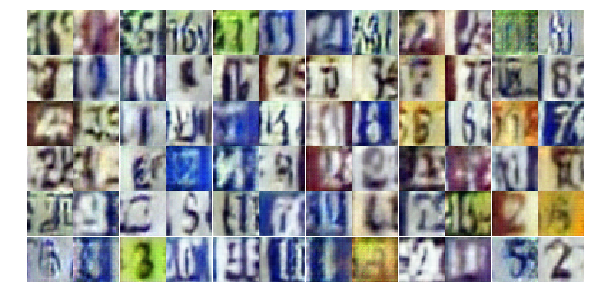

Epoch 10/30... Discriminator Loss: 1.1881... Generator Loss: 0.5011
Epoch 10/30... Discriminator Loss: 0.9727... Generator Loss: 0.8078
Epoch 10/30... Discriminator Loss: 0.8178... Generator Loss: 0.9296
Epoch 10/30... Discriminator Loss: 0.7802... Generator Loss: 1.7768
Epoch 10/30... Discriminator Loss: 0.9428... Generator Loss: 1.0563
Epoch 10/30... Discriminator Loss: 0.9120... Generator Loss: 0.7900
Epoch 10/30... Discriminator Loss: 0.9341... Generator Loss: 1.1111
Epoch 10/30... Discriminator Loss: 0.8544... Generator Loss: 0.8799
Epoch 10/30... Discriminator Loss: 1.1154... Generator Loss: 0.8013
Epoch 10/30... Discriminator Loss: 0.7407... Generator Loss: 0.9126


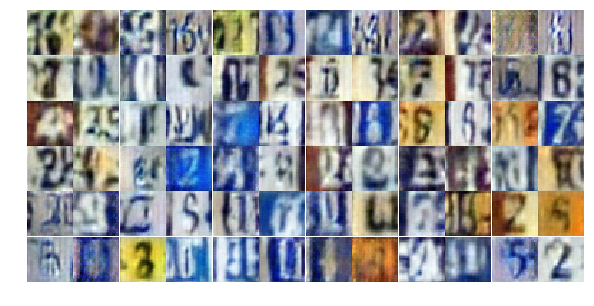

Epoch 10/30... Discriminator Loss: 0.7501... Generator Loss: 1.1639
Epoch 10/30... Discriminator Loss: 1.2154... Generator Loss: 0.5531
Epoch 10/30... Discriminator Loss: 0.7200... Generator Loss: 1.1388
Epoch 10/30... Discriminator Loss: 0.8214... Generator Loss: 1.0227
Epoch 10/30... Discriminator Loss: 0.8949... Generator Loss: 0.9108
Epoch 10/30... Discriminator Loss: 1.2244... Generator Loss: 0.4798
Epoch 10/30... Discriminator Loss: 0.9700... Generator Loss: 0.7834
Epoch 10/30... Discriminator Loss: 0.9478... Generator Loss: 0.7776
Epoch 10/30... Discriminator Loss: 0.9659... Generator Loss: 0.8568
Epoch 10/30... Discriminator Loss: 0.8098... Generator Loss: 1.1881


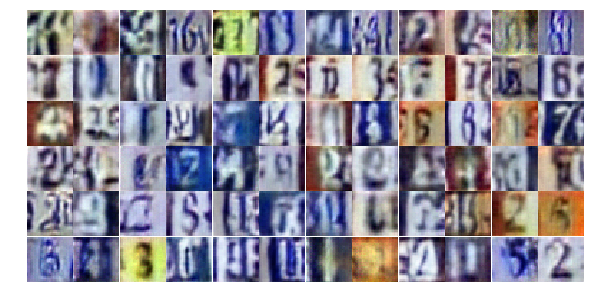

Epoch 10/30... Discriminator Loss: 1.2141... Generator Loss: 0.5065
Epoch 10/30... Discriminator Loss: 1.0769... Generator Loss: 0.7372
Epoch 10/30... Discriminator Loss: 0.8458... Generator Loss: 1.3516
Epoch 10/30... Discriminator Loss: 0.7644... Generator Loss: 1.1561
Epoch 10/30... Discriminator Loss: 1.5430... Generator Loss: 0.3401
Epoch 10/30... Discriminator Loss: 0.9646... Generator Loss: 0.7944
Epoch 10/30... Discriminator Loss: 0.8970... Generator Loss: 0.7240
Epoch 10/30... Discriminator Loss: 0.6516... Generator Loss: 1.9233
Epoch 10/30... Discriminator Loss: 1.0182... Generator Loss: 1.2649
Epoch 10/30... Discriminator Loss: 1.0232... Generator Loss: 0.6601


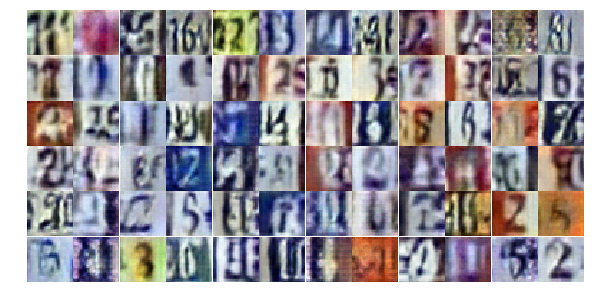

Epoch 10/30... Discriminator Loss: 0.9704... Generator Loss: 0.9977
Epoch 10/30... Discriminator Loss: 1.1350... Generator Loss: 0.6081
Epoch 10/30... Discriminator Loss: 0.7268... Generator Loss: 1.2675
Epoch 10/30... Discriminator Loss: 0.8015... Generator Loss: 1.2495
Epoch 10/30... Discriminator Loss: 0.9093... Generator Loss: 0.7794
Epoch 10/30... Discriminator Loss: 0.8406... Generator Loss: 0.9768
Epoch 10/30... Discriminator Loss: 0.9019... Generator Loss: 0.8894
Epoch 10/30... Discriminator Loss: 1.2350... Generator Loss: 0.4824
Epoch 10/30... Discriminator Loss: 0.7282... Generator Loss: 1.3369
Epoch 10/30... Discriminator Loss: 1.4032... Generator Loss: 1.0536


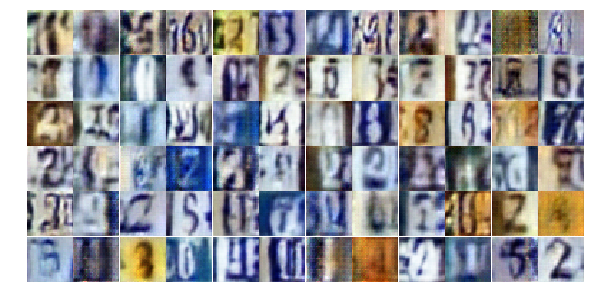

Epoch 10/30... Discriminator Loss: 0.9672... Generator Loss: 1.0805
Epoch 10/30... Discriminator Loss: 0.9137... Generator Loss: 0.9642
Epoch 10/30... Discriminator Loss: 1.2304... Generator Loss: 0.6672
Epoch 10/30... Discriminator Loss: 1.0736... Generator Loss: 0.5995
Epoch 10/30... Discriminator Loss: 0.9275... Generator Loss: 1.1676
Epoch 10/30... Discriminator Loss: 0.9324... Generator Loss: 0.8681
Epoch 10/30... Discriminator Loss: 0.7818... Generator Loss: 1.3042
Epoch 10/30... Discriminator Loss: 0.8152... Generator Loss: 1.6688
Epoch 10/30... Discriminator Loss: 1.0698... Generator Loss: 1.3674
Epoch 10/30... Discriminator Loss: 0.8377... Generator Loss: 0.8994


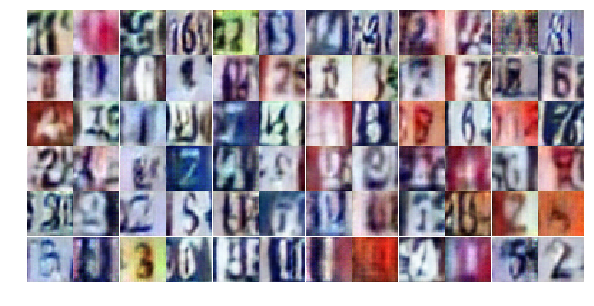

Epoch 10/30... Discriminator Loss: 1.1132... Generator Loss: 0.9017
Epoch 10/30... Discriminator Loss: 1.0740... Generator Loss: 0.6778
Epoch 10/30... Discriminator Loss: 0.9380... Generator Loss: 0.7192
Epoch 11/30... Discriminator Loss: 0.9002... Generator Loss: 1.1348
Epoch 11/30... Discriminator Loss: 0.7685... Generator Loss: 1.1702
Epoch 11/30... Discriminator Loss: 1.0745... Generator Loss: 0.5679
Epoch 11/30... Discriminator Loss: 0.8700... Generator Loss: 0.8603
Epoch 11/30... Discriminator Loss: 1.1742... Generator Loss: 0.7840
Epoch 11/30... Discriminator Loss: 1.4826... Generator Loss: 0.3810
Epoch 11/30... Discriminator Loss: 0.3593... Generator Loss: 2.3487


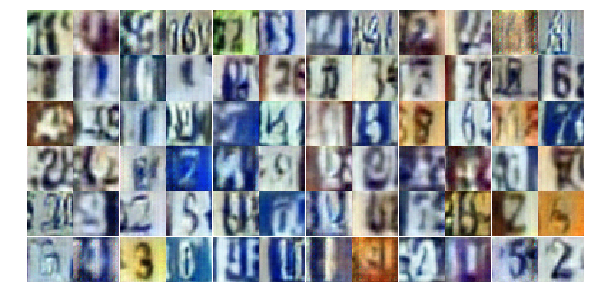

Epoch 11/30... Discriminator Loss: 1.0995... Generator Loss: 0.8019
Epoch 11/30... Discriminator Loss: 1.1801... Generator Loss: 0.5198
Epoch 11/30... Discriminator Loss: 0.7064... Generator Loss: 0.9565
Epoch 11/30... Discriminator Loss: 0.8843... Generator Loss: 0.7813
Epoch 11/30... Discriminator Loss: 1.0818... Generator Loss: 0.9665
Epoch 11/30... Discriminator Loss: 0.6174... Generator Loss: 1.1083
Epoch 11/30... Discriminator Loss: 0.8866... Generator Loss: 1.1155
Epoch 11/30... Discriminator Loss: 0.7004... Generator Loss: 1.0576
Epoch 11/30... Discriminator Loss: 1.0673... Generator Loss: 0.5824
Epoch 11/30... Discriminator Loss: 1.1986... Generator Loss: 0.5522


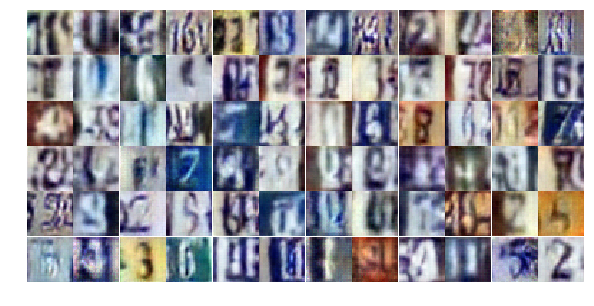

Epoch 11/30... Discriminator Loss: 0.7331... Generator Loss: 0.9358
Epoch 11/30... Discriminator Loss: 0.9202... Generator Loss: 1.1677
Epoch 11/30... Discriminator Loss: 0.8678... Generator Loss: 0.7788
Epoch 11/30... Discriminator Loss: 0.8055... Generator Loss: 0.9472
Epoch 11/30... Discriminator Loss: 0.5736... Generator Loss: 1.4987
Epoch 11/30... Discriminator Loss: 0.4232... Generator Loss: 1.6497
Epoch 11/30... Discriminator Loss: 0.6830... Generator Loss: 1.6137
Epoch 11/30... Discriminator Loss: 0.8105... Generator Loss: 0.9557
Epoch 11/30... Discriminator Loss: 0.8246... Generator Loss: 0.9033
Epoch 11/30... Discriminator Loss: 1.5793... Generator Loss: 0.3154


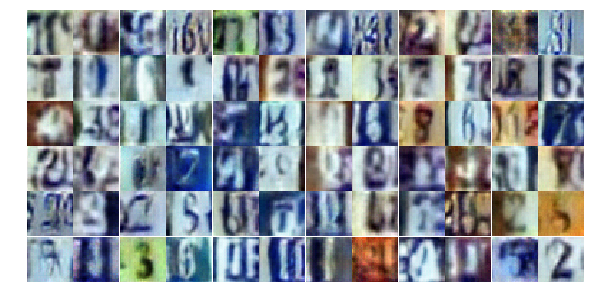

Epoch 11/30... Discriminator Loss: 1.7013... Generator Loss: 0.3012
Epoch 11/30... Discriminator Loss: 0.9874... Generator Loss: 0.7743
Epoch 11/30... Discriminator Loss: 0.9299... Generator Loss: 0.8600
Epoch 11/30... Discriminator Loss: 0.7623... Generator Loss: 0.9890
Epoch 11/30... Discriminator Loss: 0.3469... Generator Loss: 2.1865
Epoch 11/30... Discriminator Loss: 1.5382... Generator Loss: 0.3169
Epoch 11/30... Discriminator Loss: 1.3897... Generator Loss: 0.4638
Epoch 11/30... Discriminator Loss: 1.1273... Generator Loss: 0.7832
Epoch 11/30... Discriminator Loss: 1.2504... Generator Loss: 0.4817
Epoch 11/30... Discriminator Loss: 1.2219... Generator Loss: 0.4650


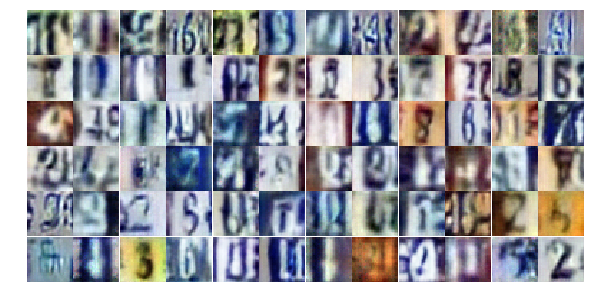

Epoch 11/30... Discriminator Loss: 0.7276... Generator Loss: 1.0898
Epoch 11/30... Discriminator Loss: 0.6963... Generator Loss: 0.9772
Epoch 11/30... Discriminator Loss: 0.8833... Generator Loss: 0.7259
Epoch 11/30... Discriminator Loss: 1.1599... Generator Loss: 0.5084
Epoch 11/30... Discriminator Loss: 1.0368... Generator Loss: 0.6222
Epoch 11/30... Discriminator Loss: 0.5531... Generator Loss: 1.7846
Epoch 11/30... Discriminator Loss: 0.4662... Generator Loss: 1.4142
Epoch 11/30... Discriminator Loss: 0.9744... Generator Loss: 1.2379
Epoch 11/30... Discriminator Loss: 1.2472... Generator Loss: 0.5020
Epoch 11/30... Discriminator Loss: 1.1086... Generator Loss: 0.5479


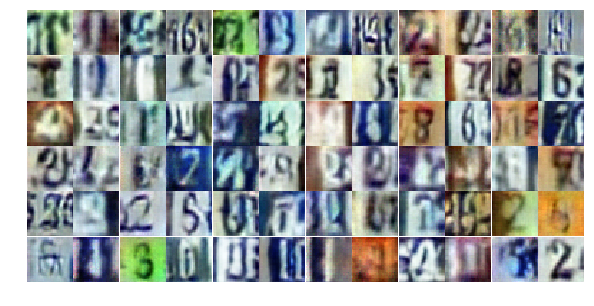

Epoch 11/30... Discriminator Loss: 0.9208... Generator Loss: 0.8874
Epoch 11/30... Discriminator Loss: 0.4167... Generator Loss: 1.8628
Epoch 11/30... Discriminator Loss: 0.6738... Generator Loss: 1.0227
Epoch 11/30... Discriminator Loss: 0.2848... Generator Loss: 2.3073
Epoch 11/30... Discriminator Loss: 0.7717... Generator Loss: 1.0918
Epoch 11/30... Discriminator Loss: 0.3768... Generator Loss: 2.0973
Epoch 11/30... Discriminator Loss: 1.9102... Generator Loss: 0.2073
Epoch 11/30... Discriminator Loss: 0.4375... Generator Loss: 2.1508
Epoch 11/30... Discriminator Loss: 0.9504... Generator Loss: 0.6499
Epoch 11/30... Discriminator Loss: 0.8582... Generator Loss: 0.7196


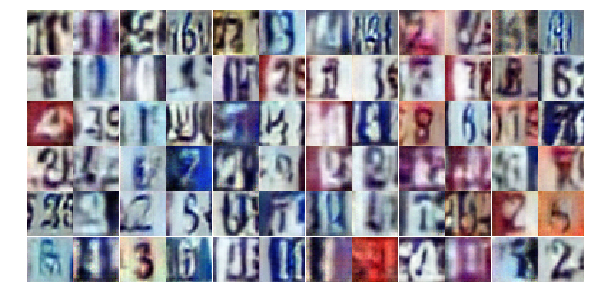

Epoch 12/30... Discriminator Loss: 0.3949... Generator Loss: 1.9889
Epoch 12/30... Discriminator Loss: 1.3666... Generator Loss: 0.3681
Epoch 12/30... Discriminator Loss: 0.4306... Generator Loss: 3.2277
Epoch 12/30... Discriminator Loss: 0.6754... Generator Loss: 1.1265
Epoch 12/30... Discriminator Loss: 0.3968... Generator Loss: 1.5223
Epoch 12/30... Discriminator Loss: 1.0169... Generator Loss: 0.5934
Epoch 12/30... Discriminator Loss: 0.1962... Generator Loss: 4.3449
Epoch 12/30... Discriminator Loss: 0.2412... Generator Loss: 2.1633
Epoch 12/30... Discriminator Loss: 0.6628... Generator Loss: 1.0584
Epoch 12/30... Discriminator Loss: 0.7549... Generator Loss: 0.9073


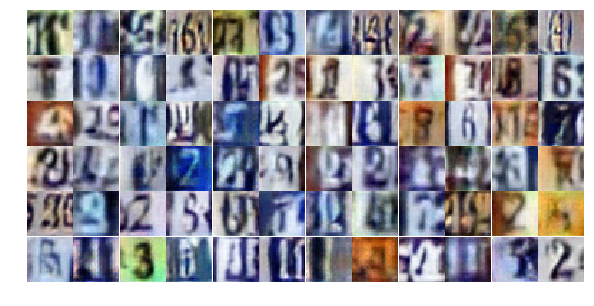

Epoch 12/30... Discriminator Loss: 1.4501... Generator Loss: 0.3797
Epoch 12/30... Discriminator Loss: 1.5026... Generator Loss: 0.3938
Epoch 12/30... Discriminator Loss: 0.4293... Generator Loss: 2.0964
Epoch 12/30... Discriminator Loss: 0.6688... Generator Loss: 1.4687
Epoch 12/30... Discriminator Loss: 0.3125... Generator Loss: 3.1451
Epoch 12/30... Discriminator Loss: 0.4159... Generator Loss: 1.7817
Epoch 12/30... Discriminator Loss: 0.7837... Generator Loss: 3.3741
Epoch 12/30... Discriminator Loss: 0.6854... Generator Loss: 1.3772
Epoch 12/30... Discriminator Loss: 0.7401... Generator Loss: 0.8386
Epoch 12/30... Discriminator Loss: 0.9797... Generator Loss: 0.6530


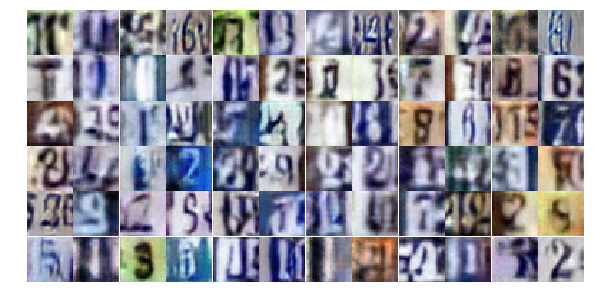

Epoch 12/30... Discriminator Loss: 0.2846... Generator Loss: 2.0441
Epoch 12/30... Discriminator Loss: 0.4387... Generator Loss: 1.8239
Epoch 12/30... Discriminator Loss: 0.7212... Generator Loss: 2.3482
Epoch 12/30... Discriminator Loss: 0.4789... Generator Loss: 1.7545
Epoch 12/30... Discriminator Loss: 0.2755... Generator Loss: 1.9444
Epoch 12/30... Discriminator Loss: 0.1637... Generator Loss: 2.9694
Epoch 12/30... Discriminator Loss: 0.1764... Generator Loss: 3.5134
Epoch 12/30... Discriminator Loss: 0.4158... Generator Loss: 1.7330
Epoch 12/30... Discriminator Loss: 0.8000... Generator Loss: 1.7509
Epoch 12/30... Discriminator Loss: 0.4608... Generator Loss: 1.7056


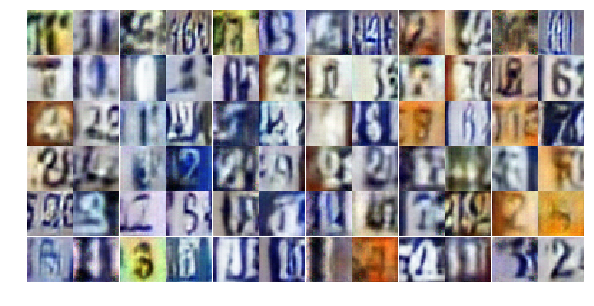

Epoch 12/30... Discriminator Loss: 0.6514... Generator Loss: 1.0843
Epoch 12/30... Discriminator Loss: 1.2050... Generator Loss: 0.4865
Epoch 12/30... Discriminator Loss: 1.0294... Generator Loss: 0.6594
Epoch 12/30... Discriminator Loss: 1.4424... Generator Loss: 0.3862
Epoch 12/30... Discriminator Loss: 0.8244... Generator Loss: 3.0750
Epoch 12/30... Discriminator Loss: 0.5878... Generator Loss: 1.5602
Epoch 12/30... Discriminator Loss: 0.1439... Generator Loss: 3.6604
Epoch 12/30... Discriminator Loss: 1.0264... Generator Loss: 0.6604
Epoch 12/30... Discriminator Loss: 0.2705... Generator Loss: 3.6532
Epoch 12/30... Discriminator Loss: 0.5135... Generator Loss: 1.4555


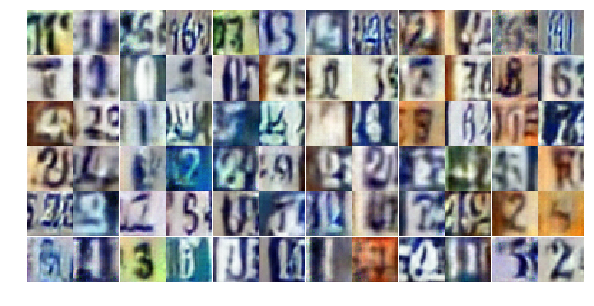

Epoch 12/30... Discriminator Loss: 0.4239... Generator Loss: 2.3924
Epoch 12/30... Discriminator Loss: 0.5890... Generator Loss: 1.5077
Epoch 12/30... Discriminator Loss: 0.2709... Generator Loss: 2.1747
Epoch 12/30... Discriminator Loss: 0.3111... Generator Loss: 1.8414
Epoch 12/30... Discriminator Loss: 1.3873... Generator Loss: 0.4807
Epoch 12/30... Discriminator Loss: 0.6467... Generator Loss: 1.0103
Epoch 12/30... Discriminator Loss: 0.3931... Generator Loss: 1.5148
Epoch 12/30... Discriminator Loss: 1.1292... Generator Loss: 0.5757
Epoch 12/30... Discriminator Loss: 1.9830... Generator Loss: 0.2553
Epoch 12/30... Discriminator Loss: 0.4565... Generator Loss: 1.8180


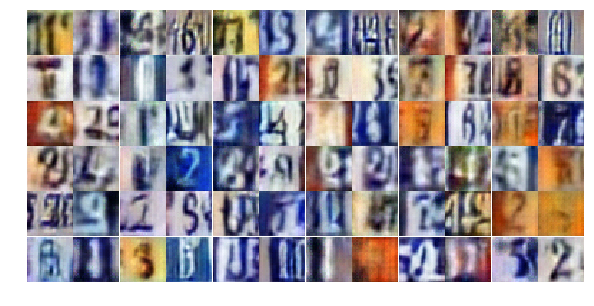

Epoch 12/30... Discriminator Loss: 0.5069... Generator Loss: 1.8164
Epoch 12/30... Discriminator Loss: 0.3554... Generator Loss: 1.9579
Epoch 12/30... Discriminator Loss: 0.7935... Generator Loss: 0.9108
Epoch 12/30... Discriminator Loss: 0.2213... Generator Loss: 2.4374
Epoch 12/30... Discriminator Loss: 0.4258... Generator Loss: 2.0967
Epoch 12/30... Discriminator Loss: 0.6574... Generator Loss: 2.7736
Epoch 12/30... Discriminator Loss: 0.1903... Generator Loss: 3.5148
Epoch 13/30... Discriminator Loss: 0.3902... Generator Loss: 1.5336
Epoch 13/30... Discriminator Loss: 0.4100... Generator Loss: 2.3293
Epoch 13/30... Discriminator Loss: 0.3954... Generator Loss: 1.5759


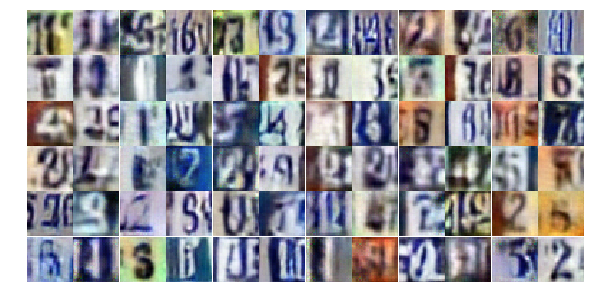

Epoch 13/30... Discriminator Loss: 0.4166... Generator Loss: 1.8748
Epoch 13/30... Discriminator Loss: 0.4225... Generator Loss: 3.2045
Epoch 13/30... Discriminator Loss: 1.6537... Generator Loss: 0.3064
Epoch 13/30... Discriminator Loss: 1.0665... Generator Loss: 0.6474
Epoch 13/30... Discriminator Loss: 1.1074... Generator Loss: 0.5841
Epoch 13/30... Discriminator Loss: 0.8454... Generator Loss: 0.8565
Epoch 13/30... Discriminator Loss: 0.7632... Generator Loss: 0.9812
Epoch 13/30... Discriminator Loss: 0.7953... Generator Loss: 0.7939
Epoch 13/30... Discriminator Loss: 0.4172... Generator Loss: 1.7737
Epoch 13/30... Discriminator Loss: 0.8003... Generator Loss: 0.9950


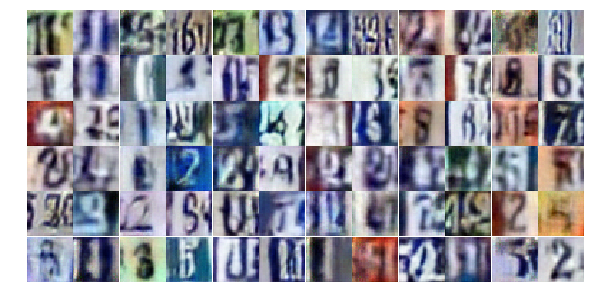

Epoch 13/30... Discriminator Loss: 0.7821... Generator Loss: 1.1454
Epoch 13/30... Discriminator Loss: 0.7611... Generator Loss: 0.9123
Epoch 13/30... Discriminator Loss: 0.6899... Generator Loss: 0.9456
Epoch 13/30... Discriminator Loss: 0.5081... Generator Loss: 1.3080
Epoch 13/30... Discriminator Loss: 0.2900... Generator Loss: 2.0652
Epoch 13/30... Discriminator Loss: 0.9994... Generator Loss: 3.3385
Epoch 13/30... Discriminator Loss: 1.1210... Generator Loss: 2.5323
Epoch 13/30... Discriminator Loss: 0.9938... Generator Loss: 0.7865
Epoch 13/30... Discriminator Loss: 0.5141... Generator Loss: 1.7231
Epoch 13/30... Discriminator Loss: 1.4697... Generator Loss: 0.3750


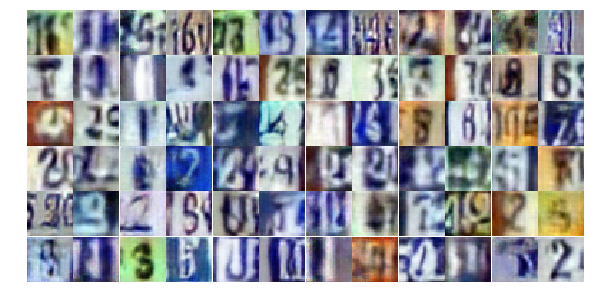

Epoch 13/30... Discriminator Loss: 1.1682... Generator Loss: 0.5781
Epoch 13/30... Discriminator Loss: 0.5617... Generator Loss: 1.2198
Epoch 13/30... Discriminator Loss: 0.6180... Generator Loss: 1.1615
Epoch 13/30... Discriminator Loss: 0.7570... Generator Loss: 1.3325
Epoch 13/30... Discriminator Loss: 0.3044... Generator Loss: 2.4348
Epoch 13/30... Discriminator Loss: 0.8127... Generator Loss: 0.8508
Epoch 13/30... Discriminator Loss: 1.0505... Generator Loss: 1.1266
Epoch 13/30... Discriminator Loss: 0.6578... Generator Loss: 1.9388
Epoch 13/30... Discriminator Loss: 0.8971... Generator Loss: 0.8109
Epoch 13/30... Discriminator Loss: 0.8889... Generator Loss: 0.8870


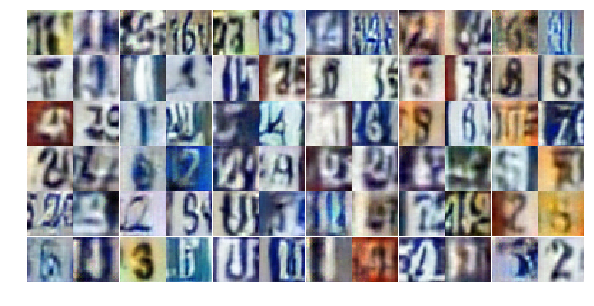

Epoch 13/30... Discriminator Loss: 0.8503... Generator Loss: 0.9379
Epoch 13/30... Discriminator Loss: 0.9092... Generator Loss: 1.5129
Epoch 13/30... Discriminator Loss: 0.8393... Generator Loss: 1.1552
Epoch 13/30... Discriminator Loss: 1.0308... Generator Loss: 0.8013
Epoch 13/30... Discriminator Loss: 0.8062... Generator Loss: 1.0541
Epoch 13/30... Discriminator Loss: 0.6545... Generator Loss: 1.1962
Epoch 13/30... Discriminator Loss: 0.7803... Generator Loss: 0.9526
Epoch 13/30... Discriminator Loss: 0.9407... Generator Loss: 1.1613
Epoch 13/30... Discriminator Loss: 0.9683... Generator Loss: 1.1742
Epoch 13/30... Discriminator Loss: 0.3250... Generator Loss: 3.0151


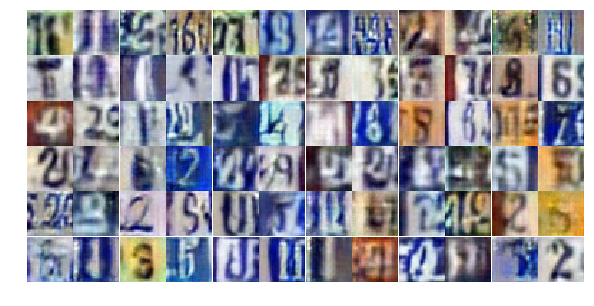

Epoch 13/30... Discriminator Loss: 0.8758... Generator Loss: 0.8295
Epoch 13/30... Discriminator Loss: 0.7186... Generator Loss: 1.2895
Epoch 13/30... Discriminator Loss: 1.1235... Generator Loss: 0.5743
Epoch 13/30... Discriminator Loss: 0.8350... Generator Loss: 0.9257
Epoch 13/30... Discriminator Loss: 1.2447... Generator Loss: 0.6058
Epoch 13/30... Discriminator Loss: 0.7454... Generator Loss: 1.1215
Epoch 13/30... Discriminator Loss: 1.1797... Generator Loss: 0.5230
Epoch 13/30... Discriminator Loss: 0.9714... Generator Loss: 0.7036
Epoch 13/30... Discriminator Loss: 0.6219... Generator Loss: 1.1864
Epoch 13/30... Discriminator Loss: 0.7756... Generator Loss: 1.1317


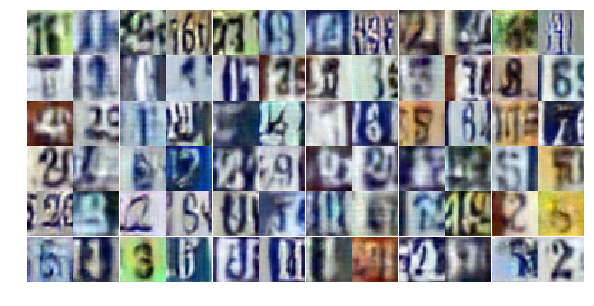

Epoch 13/30... Discriminator Loss: 0.9652... Generator Loss: 0.7033
Epoch 13/30... Discriminator Loss: 1.1738... Generator Loss: 0.4935
Epoch 13/30... Discriminator Loss: 0.9097... Generator Loss: 1.2199
Epoch 13/30... Discriminator Loss: 1.3464... Generator Loss: 0.4293
Epoch 14/30... Discriminator Loss: 1.3689... Generator Loss: 0.4329
Epoch 14/30... Discriminator Loss: 0.8323... Generator Loss: 1.0145
Epoch 14/30... Discriminator Loss: 1.2214... Generator Loss: 0.6079
Epoch 14/30... Discriminator Loss: 0.8847... Generator Loss: 1.9023
Epoch 14/30... Discriminator Loss: 0.7519... Generator Loss: 1.3223
Epoch 14/30... Discriminator Loss: 0.7821... Generator Loss: 0.9258


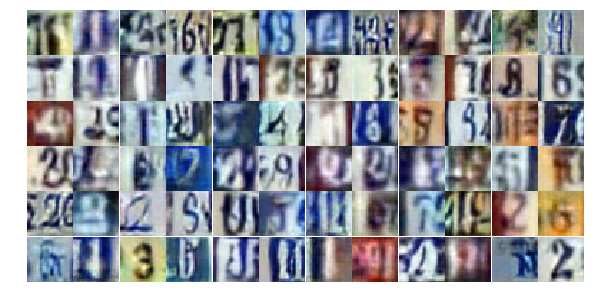

Epoch 14/30... Discriminator Loss: 1.0912... Generator Loss: 1.1353
Epoch 14/30... Discriminator Loss: 0.9174... Generator Loss: 0.6708
Epoch 14/30... Discriminator Loss: 0.8951... Generator Loss: 0.8142
Epoch 14/30... Discriminator Loss: 1.0389... Generator Loss: 0.6259
Epoch 14/30... Discriminator Loss: 1.1791... Generator Loss: 0.5840
Epoch 14/30... Discriminator Loss: 0.7457... Generator Loss: 0.9984
Epoch 14/30... Discriminator Loss: 0.7101... Generator Loss: 1.0790
Epoch 14/30... Discriminator Loss: 1.3826... Generator Loss: 0.4192
Epoch 14/30... Discriminator Loss: 1.5795... Generator Loss: 0.3207
Epoch 14/30... Discriminator Loss: 1.2546... Generator Loss: 0.5027


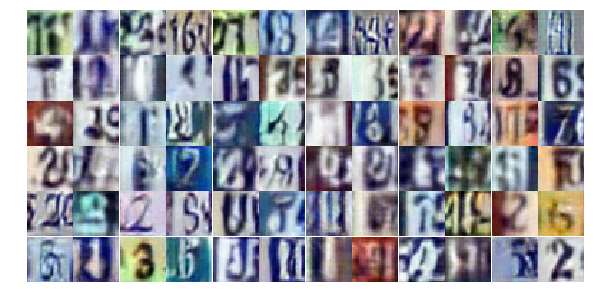

Epoch 14/30... Discriminator Loss: 0.8075... Generator Loss: 0.8314
Epoch 14/30... Discriminator Loss: 0.8111... Generator Loss: 2.1261
Epoch 14/30... Discriminator Loss: 1.1882... Generator Loss: 0.7149
Epoch 14/30... Discriminator Loss: 0.6040... Generator Loss: 1.2360
Epoch 14/30... Discriminator Loss: 1.0858... Generator Loss: 0.9922
Epoch 14/30... Discriminator Loss: 0.9955... Generator Loss: 0.7651
Epoch 14/30... Discriminator Loss: 1.2044... Generator Loss: 0.5124
Epoch 14/30... Discriminator Loss: 0.7090... Generator Loss: 1.0796
Epoch 14/30... Discriminator Loss: 0.9095... Generator Loss: 0.9384
Epoch 14/30... Discriminator Loss: 0.8023... Generator Loss: 1.4909


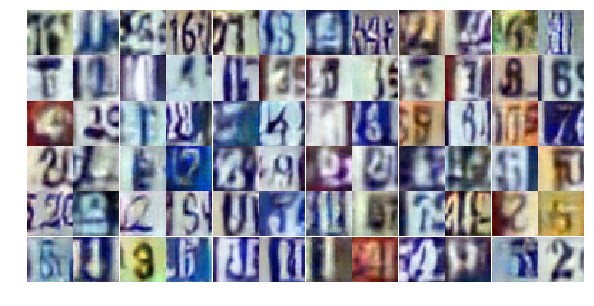

Epoch 14/30... Discriminator Loss: 1.3786... Generator Loss: 0.3643
Epoch 14/30... Discriminator Loss: 0.7016... Generator Loss: 1.1425
Epoch 14/30... Discriminator Loss: 0.6964... Generator Loss: 1.2245
Epoch 14/30... Discriminator Loss: 0.7103... Generator Loss: 1.3912
Epoch 14/30... Discriminator Loss: 0.9831... Generator Loss: 0.7447
Epoch 14/30... Discriminator Loss: 0.9728... Generator Loss: 0.6954
Epoch 14/30... Discriminator Loss: 1.0281... Generator Loss: 1.0427
Epoch 14/30... Discriminator Loss: 0.6923... Generator Loss: 1.8434
Epoch 14/30... Discriminator Loss: 0.6523... Generator Loss: 1.2843
Epoch 14/30... Discriminator Loss: 1.1129... Generator Loss: 0.6503


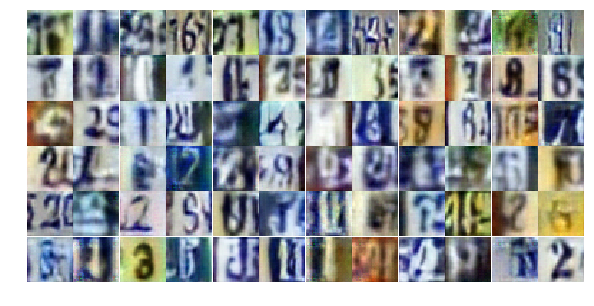

Epoch 14/30... Discriminator Loss: 1.2890... Generator Loss: 0.4699
Epoch 14/30... Discriminator Loss: 1.0408... Generator Loss: 0.7277
Epoch 14/30... Discriminator Loss: 1.0291... Generator Loss: 0.6097
Epoch 14/30... Discriminator Loss: 1.3453... Generator Loss: 0.4183
Epoch 14/30... Discriminator Loss: 0.7968... Generator Loss: 0.9048
Epoch 14/30... Discriminator Loss: 1.0712... Generator Loss: 0.6307
Epoch 14/30... Discriminator Loss: 1.0264... Generator Loss: 0.8069
Epoch 14/30... Discriminator Loss: 0.7424... Generator Loss: 0.9842
Epoch 14/30... Discriminator Loss: 1.2511... Generator Loss: 0.4747
Epoch 14/30... Discriminator Loss: 1.2532... Generator Loss: 0.4993


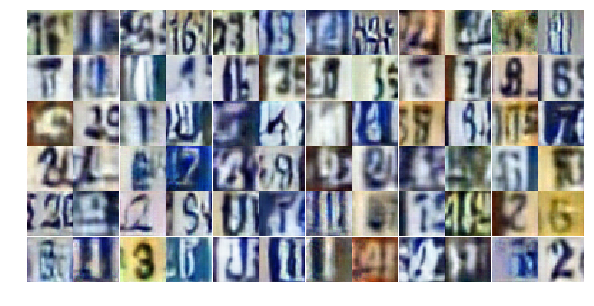

Epoch 14/30... Discriminator Loss: 0.9774... Generator Loss: 1.2407
Epoch 14/30... Discriminator Loss: 1.4131... Generator Loss: 0.3822
Epoch 14/30... Discriminator Loss: 0.9667... Generator Loss: 0.7777
Epoch 14/30... Discriminator Loss: 1.2572... Generator Loss: 0.4721
Epoch 14/30... Discriminator Loss: 0.7469... Generator Loss: 0.9179
Epoch 14/30... Discriminator Loss: 0.7388... Generator Loss: 0.9062
Epoch 14/30... Discriminator Loss: 0.9321... Generator Loss: 0.7169
Epoch 14/30... Discriminator Loss: 1.0553... Generator Loss: 0.5753
Epoch 14/30... Discriminator Loss: 1.1617... Generator Loss: 0.5320
Epoch 14/30... Discriminator Loss: 0.9298... Generator Loss: 0.7519


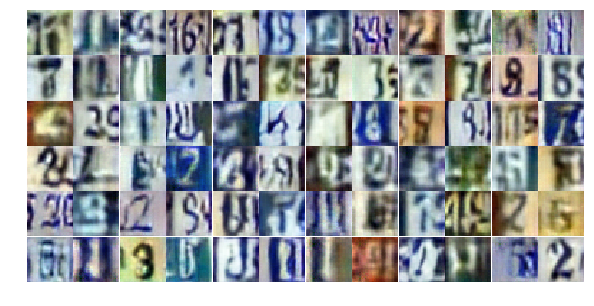

Epoch 14/30... Discriminator Loss: 0.8503... Generator Loss: 1.2220
Epoch 14/30... Discriminator Loss: 1.4698... Generator Loss: 0.3702
Epoch 15/30... Discriminator Loss: 0.8317... Generator Loss: 0.9386
Epoch 15/30... Discriminator Loss: 0.8500... Generator Loss: 1.3812
Epoch 15/30... Discriminator Loss: 1.0335... Generator Loss: 0.7065
Epoch 15/30... Discriminator Loss: 1.1082... Generator Loss: 0.6812
Epoch 15/30... Discriminator Loss: 0.9951... Generator Loss: 0.6524
Epoch 15/30... Discriminator Loss: 0.7757... Generator Loss: 1.6187
Epoch 15/30... Discriminator Loss: 1.4736... Generator Loss: 0.3736
Epoch 15/30... Discriminator Loss: 0.8167... Generator Loss: 0.8888


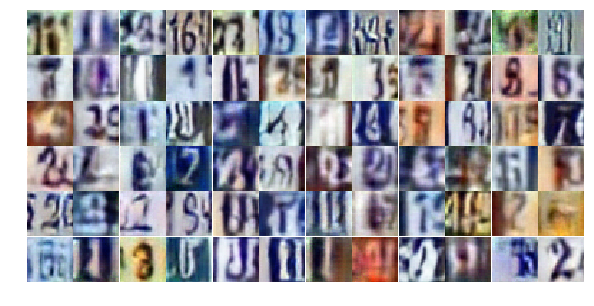

Epoch 15/30... Discriminator Loss: 1.3085... Generator Loss: 0.4313
Epoch 15/30... Discriminator Loss: 1.0727... Generator Loss: 0.8438
Epoch 15/30... Discriminator Loss: 1.2906... Generator Loss: 0.4959
Epoch 15/30... Discriminator Loss: 0.8320... Generator Loss: 0.8393
Epoch 15/30... Discriminator Loss: 0.9347... Generator Loss: 0.7660
Epoch 15/30... Discriminator Loss: 0.7546... Generator Loss: 0.9228
Epoch 15/30... Discriminator Loss: 1.1512... Generator Loss: 0.5430
Epoch 15/30... Discriminator Loss: 1.0468... Generator Loss: 1.8467
Epoch 15/30... Discriminator Loss: 0.8008... Generator Loss: 1.6450
Epoch 15/30... Discriminator Loss: 1.1586... Generator Loss: 0.5823


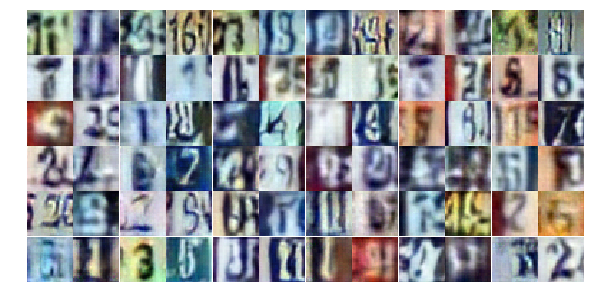

Epoch 15/30... Discriminator Loss: 1.0867... Generator Loss: 0.6377
Epoch 15/30... Discriminator Loss: 0.8573... Generator Loss: 1.3264
Epoch 15/30... Discriminator Loss: 0.8054... Generator Loss: 0.9828
Epoch 15/30... Discriminator Loss: 0.9984... Generator Loss: 0.7357
Epoch 15/30... Discriminator Loss: 0.9536... Generator Loss: 0.9572
Epoch 15/30... Discriminator Loss: 0.9932... Generator Loss: 0.7241
Epoch 15/30... Discriminator Loss: 1.3500... Generator Loss: 0.4159
Epoch 15/30... Discriminator Loss: 1.5931... Generator Loss: 0.3566
Epoch 15/30... Discriminator Loss: 0.9483... Generator Loss: 1.0629
Epoch 15/30... Discriminator Loss: 1.2103... Generator Loss: 0.4816


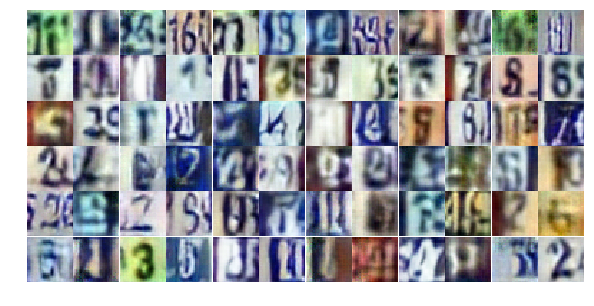

Epoch 15/30... Discriminator Loss: 0.8162... Generator Loss: 0.9079
Epoch 15/30... Discriminator Loss: 1.0243... Generator Loss: 0.6909
Epoch 15/30... Discriminator Loss: 0.7285... Generator Loss: 1.0770
Epoch 15/30... Discriminator Loss: 0.9719... Generator Loss: 0.7937
Epoch 15/30... Discriminator Loss: 0.9660... Generator Loss: 0.9448
Epoch 15/30... Discriminator Loss: 1.3836... Generator Loss: 2.2044
Epoch 15/30... Discriminator Loss: 0.8018... Generator Loss: 0.9489
Epoch 15/30... Discriminator Loss: 0.8189... Generator Loss: 0.9883
Epoch 15/30... Discriminator Loss: 0.8118... Generator Loss: 1.9923
Epoch 15/30... Discriminator Loss: 2.1251... Generator Loss: 0.1935


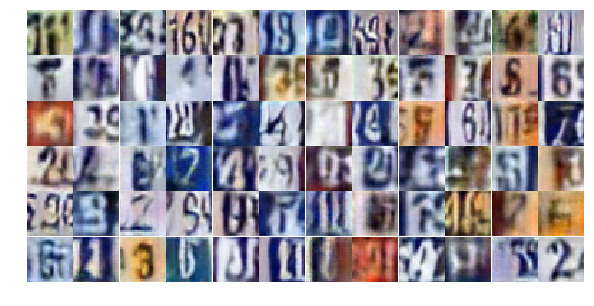

Epoch 15/30... Discriminator Loss: 1.1651... Generator Loss: 0.5540
Epoch 15/30... Discriminator Loss: 1.1627... Generator Loss: 0.5727
Epoch 15/30... Discriminator Loss: 1.0244... Generator Loss: 0.7539
Epoch 15/30... Discriminator Loss: 1.3590... Generator Loss: 0.4696
Epoch 15/30... Discriminator Loss: 0.9225... Generator Loss: 0.6487
Epoch 15/30... Discriminator Loss: 1.4620... Generator Loss: 0.4903
Epoch 15/30... Discriminator Loss: 0.7455... Generator Loss: 1.0142
Epoch 15/30... Discriminator Loss: 1.0836... Generator Loss: 1.1908
Epoch 15/30... Discriminator Loss: 1.1112... Generator Loss: 0.5788
Epoch 15/30... Discriminator Loss: 0.9971... Generator Loss: 1.1073


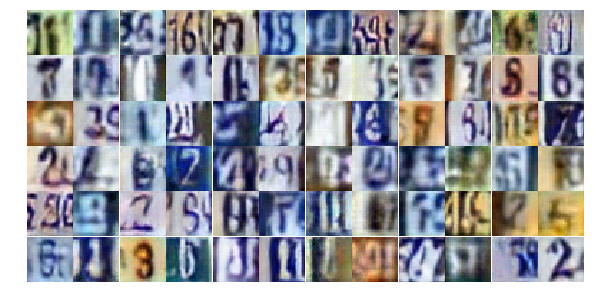

Epoch 15/30... Discriminator Loss: 1.1041... Generator Loss: 0.5722
Epoch 15/30... Discriminator Loss: 1.0769... Generator Loss: 0.6382
Epoch 15/30... Discriminator Loss: 0.6484... Generator Loss: 1.6803
Epoch 15/30... Discriminator Loss: 1.4520... Generator Loss: 0.4383
Epoch 15/30... Discriminator Loss: 1.1883... Generator Loss: 0.5442
Epoch 15/30... Discriminator Loss: 0.9218... Generator Loss: 1.5726
Epoch 15/30... Discriminator Loss: 1.1137... Generator Loss: 0.5773
Epoch 15/30... Discriminator Loss: 0.6949... Generator Loss: 1.2718
Epoch 15/30... Discriminator Loss: 1.2627... Generator Loss: 0.6248
Epoch 16/30... Discriminator Loss: 1.1074... Generator Loss: 0.6480


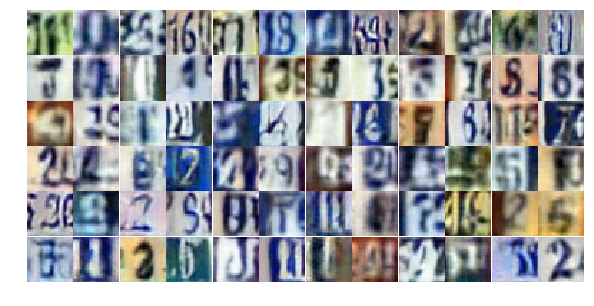

Epoch 16/30... Discriminator Loss: 1.0152... Generator Loss: 0.6585
Epoch 16/30... Discriminator Loss: 0.9118... Generator Loss: 1.3354
Epoch 16/30... Discriminator Loss: 1.4192... Generator Loss: 0.4149
Epoch 16/30... Discriminator Loss: 0.9002... Generator Loss: 0.9522
Epoch 16/30... Discriminator Loss: 0.8749... Generator Loss: 1.4989
Epoch 16/30... Discriminator Loss: 0.9970... Generator Loss: 1.0028
Epoch 16/30... Discriminator Loss: 1.5627... Generator Loss: 0.3444
Epoch 16/30... Discriminator Loss: 0.9910... Generator Loss: 0.7631
Epoch 16/30... Discriminator Loss: 1.0711... Generator Loss: 0.5674
Epoch 16/30... Discriminator Loss: 1.0199... Generator Loss: 0.5948


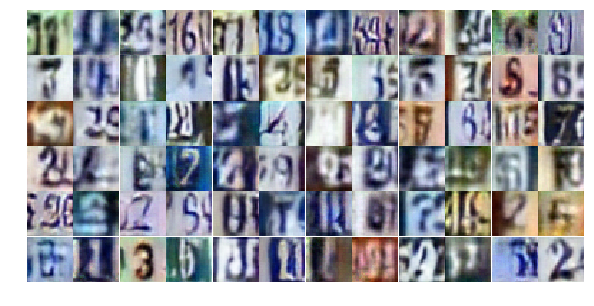

Epoch 16/30... Discriminator Loss: 1.5453... Generator Loss: 0.3632
Epoch 16/30... Discriminator Loss: 0.9532... Generator Loss: 0.6679
Epoch 16/30... Discriminator Loss: 0.9945... Generator Loss: 0.6866
Epoch 16/30... Discriminator Loss: 0.9478... Generator Loss: 0.9950
Epoch 16/30... Discriminator Loss: 0.9108... Generator Loss: 1.2879
Epoch 16/30... Discriminator Loss: 0.7985... Generator Loss: 0.9095
Epoch 16/30... Discriminator Loss: 0.9236... Generator Loss: 0.7528
Epoch 16/30... Discriminator Loss: 0.4120... Generator Loss: 2.0525
Epoch 16/30... Discriminator Loss: 0.4934... Generator Loss: 1.4766
Epoch 16/30... Discriminator Loss: 0.7669... Generator Loss: 1.0806


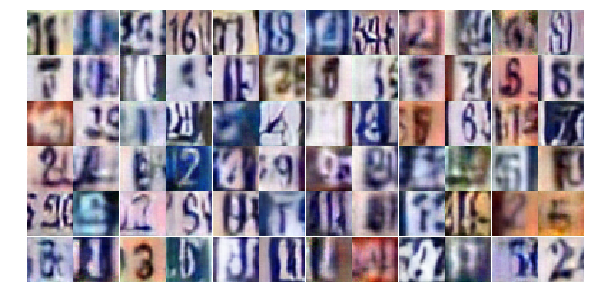

Epoch 16/30... Discriminator Loss: 1.0937... Generator Loss: 0.6587
Epoch 16/30... Discriminator Loss: 0.8248... Generator Loss: 0.9141
Epoch 16/30... Discriminator Loss: 1.0615... Generator Loss: 0.6357
Epoch 16/30... Discriminator Loss: 1.1796... Generator Loss: 0.5017
Epoch 16/30... Discriminator Loss: 0.7461... Generator Loss: 1.4513
Epoch 16/30... Discriminator Loss: 1.0850... Generator Loss: 0.6060
Epoch 16/30... Discriminator Loss: 1.1471... Generator Loss: 0.5152
Epoch 16/30... Discriminator Loss: 0.7964... Generator Loss: 0.8735
Epoch 16/30... Discriminator Loss: 0.8088... Generator Loss: 1.0586
Epoch 16/30... Discriminator Loss: 0.6725... Generator Loss: 1.1581


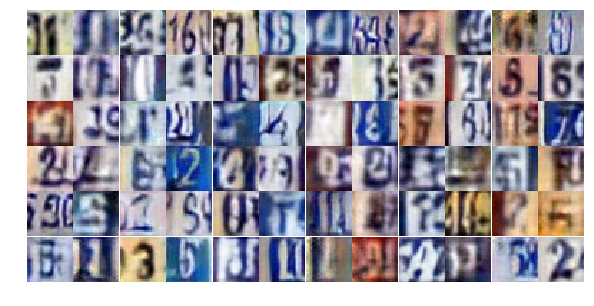

Epoch 16/30... Discriminator Loss: 0.6388... Generator Loss: 1.1190
Epoch 16/30... Discriminator Loss: 1.1143... Generator Loss: 0.5384
Epoch 16/30... Discriminator Loss: 0.7206... Generator Loss: 0.9053
Epoch 16/30... Discriminator Loss: 0.9017... Generator Loss: 1.0320
Epoch 16/30... Discriminator Loss: 1.1161... Generator Loss: 1.4890
Epoch 16/30... Discriminator Loss: 1.0202... Generator Loss: 0.7819
Epoch 16/30... Discriminator Loss: 0.9587... Generator Loss: 0.7644
Epoch 16/30... Discriminator Loss: 1.1661... Generator Loss: 0.5120
Epoch 16/30... Discriminator Loss: 0.9773... Generator Loss: 0.6872
Epoch 16/30... Discriminator Loss: 0.7984... Generator Loss: 0.9663


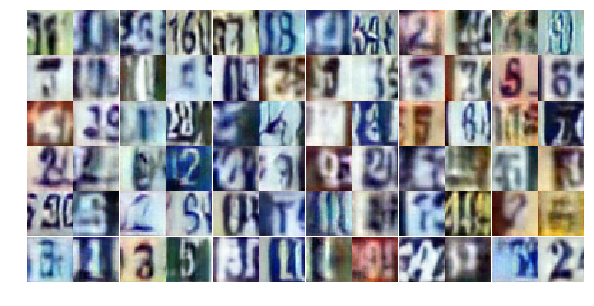

Epoch 16/30... Discriminator Loss: 0.8346... Generator Loss: 0.8669
Epoch 16/30... Discriminator Loss: 0.7971... Generator Loss: 0.8704
Epoch 16/30... Discriminator Loss: 1.4120... Generator Loss: 0.3843
Epoch 16/30... Discriminator Loss: 1.2737... Generator Loss: 0.4917
Epoch 16/30... Discriminator Loss: 0.9593... Generator Loss: 1.4198
Epoch 16/30... Discriminator Loss: 1.4905... Generator Loss: 0.3487
Epoch 16/30... Discriminator Loss: 0.6355... Generator Loss: 1.4170
Epoch 16/30... Discriminator Loss: 1.1198... Generator Loss: 0.6190
Epoch 16/30... Discriminator Loss: 0.6286... Generator Loss: 1.0539
Epoch 16/30... Discriminator Loss: 0.9110... Generator Loss: 0.7352


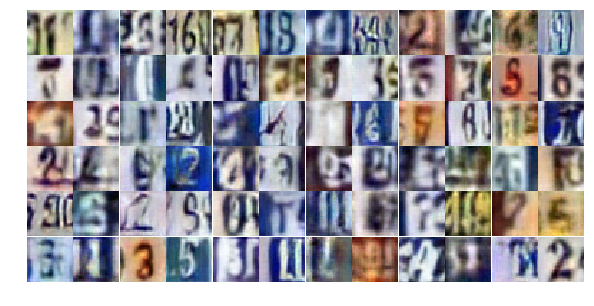

Epoch 16/30... Discriminator Loss: 1.7911... Generator Loss: 0.2654
Epoch 16/30... Discriminator Loss: 0.8543... Generator Loss: 1.0521
Epoch 16/30... Discriminator Loss: 2.2140... Generator Loss: 0.1641
Epoch 16/30... Discriminator Loss: 0.7291... Generator Loss: 1.5421
Epoch 16/30... Discriminator Loss: 0.6717... Generator Loss: 1.3278
Epoch 16/30... Discriminator Loss: 0.8607... Generator Loss: 0.8400
Epoch 17/30... Discriminator Loss: 0.8847... Generator Loss: 0.8013
Epoch 17/30... Discriminator Loss: 0.7926... Generator Loss: 0.9904
Epoch 17/30... Discriminator Loss: 0.9526... Generator Loss: 0.7682
Epoch 17/30... Discriminator Loss: 1.0301... Generator Loss: 0.6748


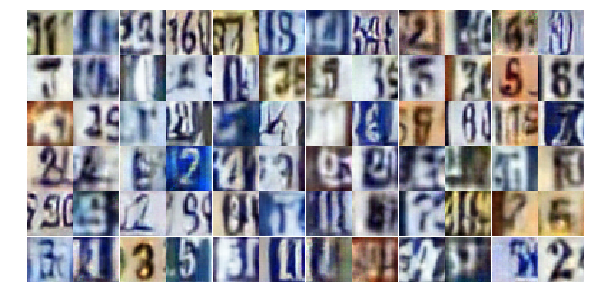

Epoch 17/30... Discriminator Loss: 0.9161... Generator Loss: 0.7054
Epoch 17/30... Discriminator Loss: 0.7290... Generator Loss: 1.0071
Epoch 17/30... Discriminator Loss: 0.4925... Generator Loss: 1.4727
Epoch 17/30... Discriminator Loss: 0.6622... Generator Loss: 1.5543
Epoch 17/30... Discriminator Loss: 1.1021... Generator Loss: 0.7428
Epoch 17/30... Discriminator Loss: 1.1190... Generator Loss: 0.7588
Epoch 17/30... Discriminator Loss: 0.7332... Generator Loss: 1.1846
Epoch 17/30... Discriminator Loss: 0.7863... Generator Loss: 0.8830
Epoch 17/30... Discriminator Loss: 0.3798... Generator Loss: 1.6852
Epoch 17/30... Discriminator Loss: 0.8167... Generator Loss: 1.1439


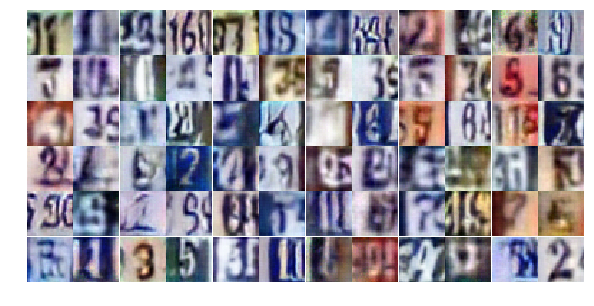

Epoch 17/30... Discriminator Loss: 0.8626... Generator Loss: 1.2591
Epoch 17/30... Discriminator Loss: 0.7639... Generator Loss: 1.1766
Epoch 17/30... Discriminator Loss: 0.8302... Generator Loss: 0.9399
Epoch 17/30... Discriminator Loss: 0.7331... Generator Loss: 1.1536
Epoch 17/30... Discriminator Loss: 0.6428... Generator Loss: 1.2319
Epoch 17/30... Discriminator Loss: 1.4874... Generator Loss: 0.3731
Epoch 17/30... Discriminator Loss: 1.0168... Generator Loss: 1.1591
Epoch 17/30... Discriminator Loss: 0.9751... Generator Loss: 0.6752
Epoch 17/30... Discriminator Loss: 0.8920... Generator Loss: 0.7598
Epoch 17/30... Discriminator Loss: 0.4205... Generator Loss: 1.4213


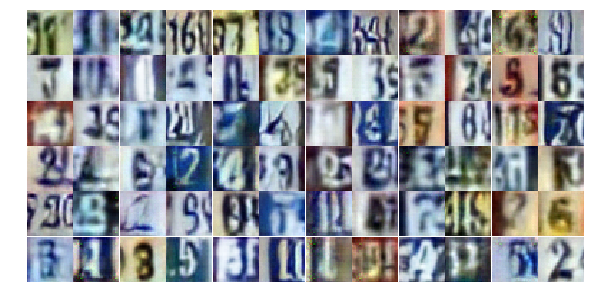

Epoch 17/30... Discriminator Loss: 1.0436... Generator Loss: 0.6164
Epoch 17/30... Discriminator Loss: 0.6572... Generator Loss: 1.0440
Epoch 17/30... Discriminator Loss: 0.5302... Generator Loss: 1.7336
Epoch 17/30... Discriminator Loss: 1.0000... Generator Loss: 0.6415
Epoch 17/30... Discriminator Loss: 1.3560... Generator Loss: 0.3853
Epoch 17/30... Discriminator Loss: 0.5391... Generator Loss: 1.3604
Epoch 17/30... Discriminator Loss: 1.3141... Generator Loss: 0.4869
Epoch 17/30... Discriminator Loss: 1.0087... Generator Loss: 0.6938
Epoch 17/30... Discriminator Loss: 0.9507... Generator Loss: 0.8860
Epoch 17/30... Discriminator Loss: 0.7161... Generator Loss: 1.1611


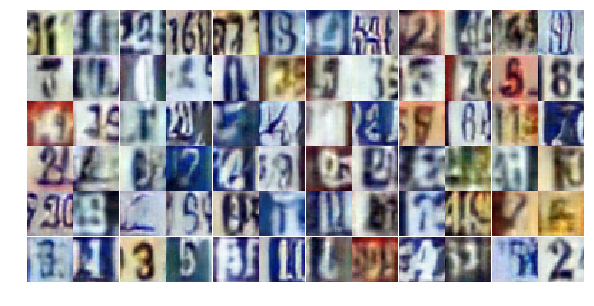

Epoch 17/30... Discriminator Loss: 0.8047... Generator Loss: 1.0060
Epoch 17/30... Discriminator Loss: 1.1517... Generator Loss: 0.5680
Epoch 17/30... Discriminator Loss: 0.9228... Generator Loss: 0.9342
Epoch 17/30... Discriminator Loss: 1.1580... Generator Loss: 0.5622
Epoch 17/30... Discriminator Loss: 1.1925... Generator Loss: 0.5491
Epoch 17/30... Discriminator Loss: 0.7378... Generator Loss: 1.1879
Epoch 17/30... Discriminator Loss: 1.0592... Generator Loss: 0.7089
Epoch 17/30... Discriminator Loss: 0.7112... Generator Loss: 1.1388
Epoch 17/30... Discriminator Loss: 0.5411... Generator Loss: 1.3154
Epoch 17/30... Discriminator Loss: 1.3624... Generator Loss: 0.4046


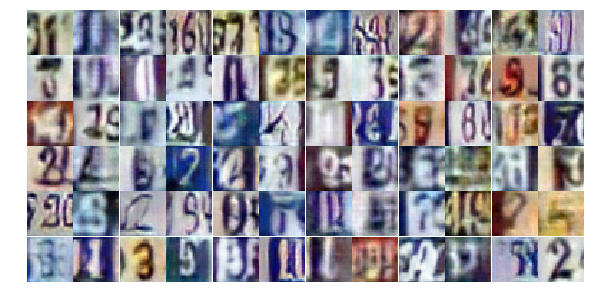

Epoch 17/30... Discriminator Loss: 2.0283... Generator Loss: 1.8740
Epoch 17/30... Discriminator Loss: 0.5975... Generator Loss: 2.8619
Epoch 17/30... Discriminator Loss: 1.1087... Generator Loss: 1.0252
Epoch 17/30... Discriminator Loss: 0.5630... Generator Loss: 1.6185
Epoch 17/30... Discriminator Loss: 1.2095... Generator Loss: 0.5360
Epoch 17/30... Discriminator Loss: 1.0579... Generator Loss: 0.6399
Epoch 17/30... Discriminator Loss: 1.6612... Generator Loss: 0.2959
Epoch 17/30... Discriminator Loss: 0.7060... Generator Loss: 1.2921
Epoch 17/30... Discriminator Loss: 0.6780... Generator Loss: 1.9936
Epoch 17/30... Discriminator Loss: 1.1803... Generator Loss: 0.5550


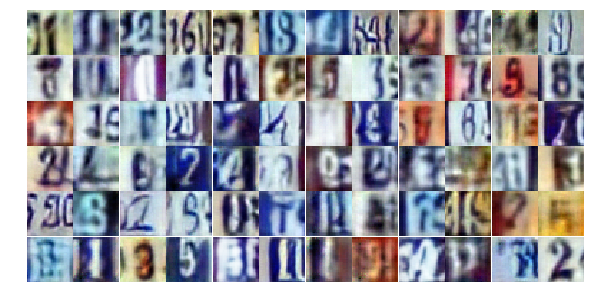

Epoch 17/30... Discriminator Loss: 0.9553... Generator Loss: 0.9825
Epoch 17/30... Discriminator Loss: 0.9919... Generator Loss: 0.8939
Epoch 17/30... Discriminator Loss: 0.9157... Generator Loss: 0.7859
Epoch 17/30... Discriminator Loss: 0.7200... Generator Loss: 1.1624
Epoch 18/30... Discriminator Loss: 1.1963... Generator Loss: 0.5272
Epoch 18/30... Discriminator Loss: 1.5793... Generator Loss: 0.2957
Epoch 18/30... Discriminator Loss: 1.0032... Generator Loss: 0.6494
Epoch 18/30... Discriminator Loss: 0.9947... Generator Loss: 0.6457
Epoch 18/30... Discriminator Loss: 1.4204... Generator Loss: 0.4074
Epoch 18/30... Discriminator Loss: 1.1043... Generator Loss: 0.6121


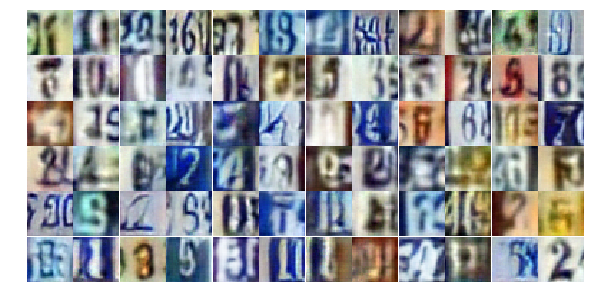

Epoch 18/30... Discriminator Loss: 0.6358... Generator Loss: 1.4078
Epoch 18/30... Discriminator Loss: 1.2576... Generator Loss: 0.4591
Epoch 18/30... Discriminator Loss: 1.2832... Generator Loss: 0.4311
Epoch 18/30... Discriminator Loss: 0.8392... Generator Loss: 0.9119
Epoch 18/30... Discriminator Loss: 0.7571... Generator Loss: 1.0797
Epoch 18/30... Discriminator Loss: 0.8369... Generator Loss: 1.1756
Epoch 18/30... Discriminator Loss: 0.6975... Generator Loss: 0.9634
Epoch 18/30... Discriminator Loss: 1.2175... Generator Loss: 0.4917
Epoch 18/30... Discriminator Loss: 0.6075... Generator Loss: 1.5021
Epoch 18/30... Discriminator Loss: 0.5459... Generator Loss: 1.3950


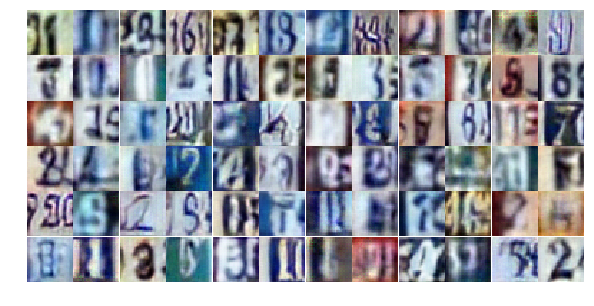

Epoch 18/30... Discriminator Loss: 0.8552... Generator Loss: 0.8245
Epoch 18/30... Discriminator Loss: 0.9774... Generator Loss: 1.2473
Epoch 18/30... Discriminator Loss: 1.6944... Generator Loss: 0.2943
Epoch 18/30... Discriminator Loss: 0.6885... Generator Loss: 1.1651
Epoch 18/30... Discriminator Loss: 0.9607... Generator Loss: 0.6530
Epoch 18/30... Discriminator Loss: 1.2719... Generator Loss: 0.5240
Epoch 18/30... Discriminator Loss: 0.8659... Generator Loss: 0.8875
Epoch 18/30... Discriminator Loss: 0.9052... Generator Loss: 0.7134
Epoch 18/30... Discriminator Loss: 0.6902... Generator Loss: 1.3163
Epoch 18/30... Discriminator Loss: 0.8172... Generator Loss: 0.8074


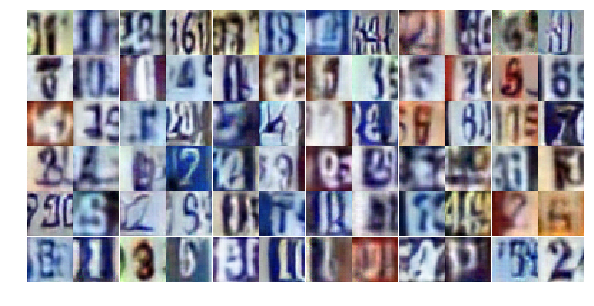

Epoch 18/30... Discriminator Loss: 0.3245... Generator Loss: 3.4655
Epoch 18/30... Discriminator Loss: 0.8361... Generator Loss: 2.3465
Epoch 18/30... Discriminator Loss: 0.8211... Generator Loss: 0.8133
Epoch 18/30... Discriminator Loss: 0.8291... Generator Loss: 0.9288
Epoch 18/30... Discriminator Loss: 1.0239... Generator Loss: 0.6620
Epoch 18/30... Discriminator Loss: 0.9452... Generator Loss: 0.7414
Epoch 18/30... Discriminator Loss: 0.7498... Generator Loss: 0.9273
Epoch 18/30... Discriminator Loss: 0.5905... Generator Loss: 2.2220
Epoch 18/30... Discriminator Loss: 0.5626... Generator Loss: 1.2116
Epoch 18/30... Discriminator Loss: 0.8073... Generator Loss: 0.8630


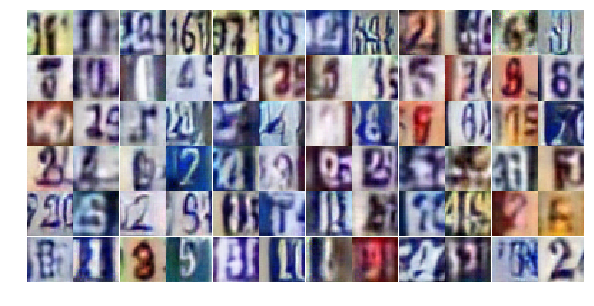

Epoch 18/30... Discriminator Loss: 0.9760... Generator Loss: 0.7393
Epoch 18/30... Discriminator Loss: 0.8643... Generator Loss: 0.7952
Epoch 18/30... Discriminator Loss: 0.2798... Generator Loss: 2.4687
Epoch 18/30... Discriminator Loss: 0.4322... Generator Loss: 2.1969
Epoch 18/30... Discriminator Loss: 1.1012... Generator Loss: 0.7376
Epoch 18/30... Discriminator Loss: 0.5502... Generator Loss: 1.1789
Epoch 18/30... Discriminator Loss: 1.2442... Generator Loss: 0.5010
Epoch 18/30... Discriminator Loss: 1.3902... Generator Loss: 2.3564
Epoch 18/30... Discriminator Loss: 0.7515... Generator Loss: 1.0167
Epoch 18/30... Discriminator Loss: 0.3256... Generator Loss: 2.0493


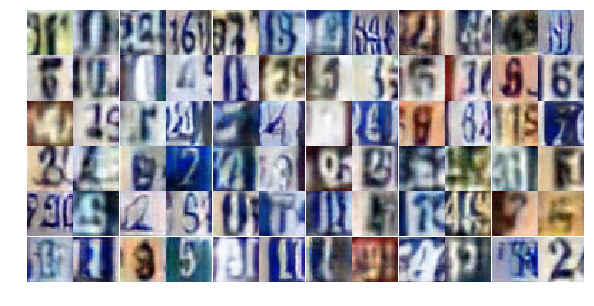

Epoch 18/30... Discriminator Loss: 0.5892... Generator Loss: 1.2027
Epoch 18/30... Discriminator Loss: 0.8082... Generator Loss: 1.0726
Epoch 18/30... Discriminator Loss: 0.6736... Generator Loss: 1.2925
Epoch 18/30... Discriminator Loss: 1.1561... Generator Loss: 0.5502
Epoch 18/30... Discriminator Loss: 0.7171... Generator Loss: 0.9953
Epoch 18/30... Discriminator Loss: 0.9263... Generator Loss: 1.5000
Epoch 18/30... Discriminator Loss: 1.2654... Generator Loss: 0.4389
Epoch 18/30... Discriminator Loss: 0.8452... Generator Loss: 0.7732
Epoch 18/30... Discriminator Loss: 1.5950... Generator Loss: 0.3735
Epoch 18/30... Discriminator Loss: 0.9219... Generator Loss: 0.7743


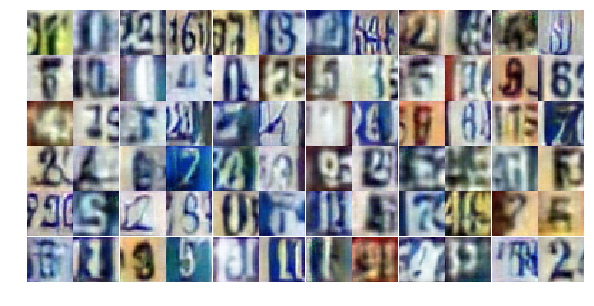

Epoch 18/30... Discriminator Loss: 0.7000... Generator Loss: 1.3801
Epoch 19/30... Discriminator Loss: 1.1697... Generator Loss: 0.5980
Epoch 19/30... Discriminator Loss: 1.1885... Generator Loss: 0.7423
Epoch 19/30... Discriminator Loss: 1.1581... Generator Loss: 0.6632
Epoch 19/30... Discriminator Loss: 0.8842... Generator Loss: 0.8643
Epoch 19/30... Discriminator Loss: 1.3466... Generator Loss: 0.4354
Epoch 19/30... Discriminator Loss: 0.9187... Generator Loss: 0.7546
Epoch 19/30... Discriminator Loss: 1.0792... Generator Loss: 0.8476
Epoch 19/30... Discriminator Loss: 1.0208... Generator Loss: 1.6221
Epoch 19/30... Discriminator Loss: 1.2170... Generator Loss: 0.5566


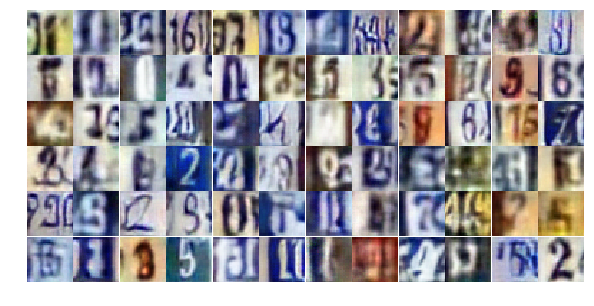

Epoch 19/30... Discriminator Loss: 0.8862... Generator Loss: 0.7222
Epoch 19/30... Discriminator Loss: 1.0993... Generator Loss: 0.5800
Epoch 19/30... Discriminator Loss: 0.9570... Generator Loss: 1.0486
Epoch 19/30... Discriminator Loss: 1.1124... Generator Loss: 0.5643
Epoch 19/30... Discriminator Loss: 1.4964... Generator Loss: 0.3428
Epoch 19/30... Discriminator Loss: 0.9145... Generator Loss: 1.0451
Epoch 19/30... Discriminator Loss: 1.1526... Generator Loss: 0.5594
Epoch 19/30... Discriminator Loss: 0.9152... Generator Loss: 0.8209
Epoch 19/30... Discriminator Loss: 0.9012... Generator Loss: 1.0940
Epoch 19/30... Discriminator Loss: 1.1289... Generator Loss: 0.6401


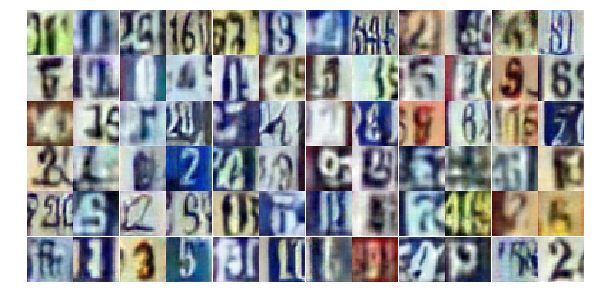

Epoch 19/30... Discriminator Loss: 0.5993... Generator Loss: 1.4184
Epoch 19/30... Discriminator Loss: 1.7152... Generator Loss: 0.3016
Epoch 19/30... Discriminator Loss: 1.1591... Generator Loss: 0.5545
Epoch 19/30... Discriminator Loss: 1.1014... Generator Loss: 0.6943
Epoch 19/30... Discriminator Loss: 0.8646... Generator Loss: 0.9717
Epoch 19/30... Discriminator Loss: 1.2177... Generator Loss: 0.6372
Epoch 19/30... Discriminator Loss: 0.9067... Generator Loss: 0.7993
Epoch 19/30... Discriminator Loss: 0.7557... Generator Loss: 1.0408
Epoch 19/30... Discriminator Loss: 0.7486... Generator Loss: 0.9729
Epoch 19/30... Discriminator Loss: 1.1733... Generator Loss: 0.5986


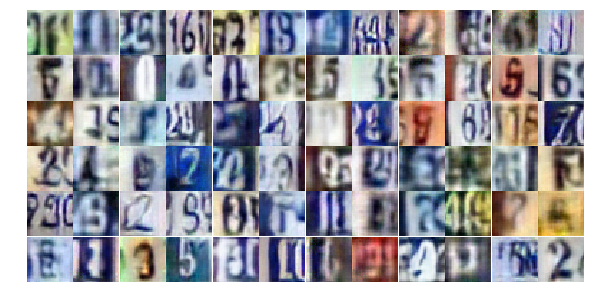

Epoch 19/30... Discriminator Loss: 1.0203... Generator Loss: 0.6586
Epoch 19/30... Discriminator Loss: 1.1460... Generator Loss: 0.5020
Epoch 19/30... Discriminator Loss: 1.2513... Generator Loss: 0.4535
Epoch 19/30... Discriminator Loss: 0.7602... Generator Loss: 0.9713
Epoch 19/30... Discriminator Loss: 1.2139... Generator Loss: 0.4464
Epoch 19/30... Discriminator Loss: 1.9507... Generator Loss: 0.2303
Epoch 19/30... Discriminator Loss: 1.0185... Generator Loss: 0.8630
Epoch 19/30... Discriminator Loss: 0.5123... Generator Loss: 1.5643
Epoch 19/30... Discriminator Loss: 1.0444... Generator Loss: 0.6323
Epoch 19/30... Discriminator Loss: 0.9158... Generator Loss: 1.0806


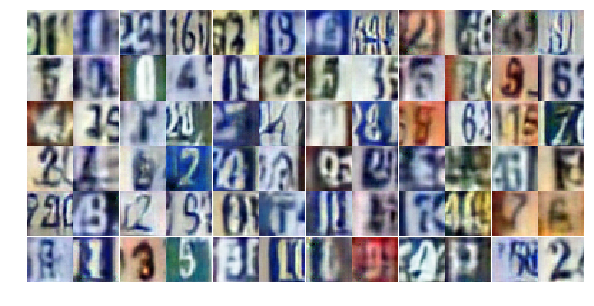

Epoch 19/30... Discriminator Loss: 0.8079... Generator Loss: 0.8066
Epoch 19/30... Discriminator Loss: 1.5411... Generator Loss: 0.3211
Epoch 19/30... Discriminator Loss: 0.4767... Generator Loss: 2.2253
Epoch 19/30... Discriminator Loss: 0.8262... Generator Loss: 0.8730
Epoch 19/30... Discriminator Loss: 0.7328... Generator Loss: 1.2478
Epoch 19/30... Discriminator Loss: 1.5560... Generator Loss: 0.4021
Epoch 19/30... Discriminator Loss: 0.8098... Generator Loss: 0.8628
Epoch 19/30... Discriminator Loss: 0.6919... Generator Loss: 1.1585
Epoch 19/30... Discriminator Loss: 0.6013... Generator Loss: 1.1442
Epoch 19/30... Discriminator Loss: 1.0475... Generator Loss: 0.6797


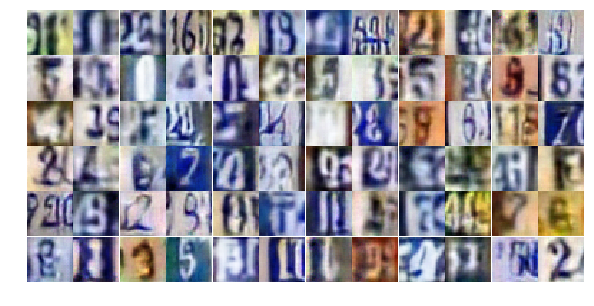

Epoch 19/30... Discriminator Loss: 1.3404... Generator Loss: 0.4282
Epoch 19/30... Discriminator Loss: 0.6875... Generator Loss: 1.2336
Epoch 19/30... Discriminator Loss: 1.0216... Generator Loss: 1.8681
Epoch 19/30... Discriminator Loss: 1.3519... Generator Loss: 0.4802
Epoch 19/30... Discriminator Loss: 0.9814... Generator Loss: 1.2908
Epoch 19/30... Discriminator Loss: 0.9044... Generator Loss: 1.3463
Epoch 19/30... Discriminator Loss: 1.9495... Generator Loss: 0.2026
Epoch 19/30... Discriminator Loss: 0.6393... Generator Loss: 1.1283
Epoch 20/30... Discriminator Loss: 1.0553... Generator Loss: 0.6436
Epoch 20/30... Discriminator Loss: 0.7804... Generator Loss: 0.9449


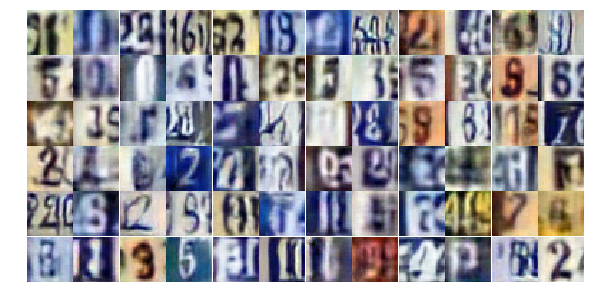

Epoch 20/30... Discriminator Loss: 0.7166... Generator Loss: 1.0655
Epoch 20/30... Discriminator Loss: 0.9597... Generator Loss: 0.6919
Epoch 20/30... Discriminator Loss: 1.5450... Generator Loss: 0.3435
Epoch 20/30... Discriminator Loss: 1.1330... Generator Loss: 0.5223
Epoch 20/30... Discriminator Loss: 0.6134... Generator Loss: 1.1763
Epoch 20/30... Discriminator Loss: 0.9173... Generator Loss: 0.7284
Epoch 20/30... Discriminator Loss: 0.6360... Generator Loss: 1.5240
Epoch 20/30... Discriminator Loss: 0.9619... Generator Loss: 0.8182
Epoch 20/30... Discriminator Loss: 1.1256... Generator Loss: 0.5861
Epoch 20/30... Discriminator Loss: 0.9169... Generator Loss: 0.7131


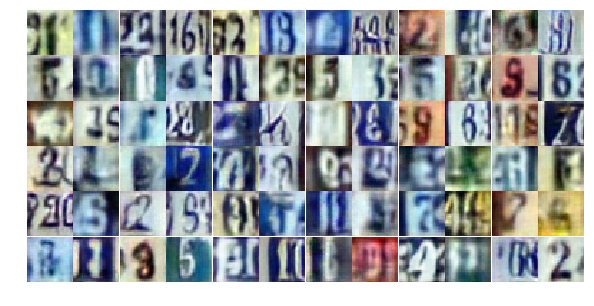

Epoch 20/30... Discriminator Loss: 1.4097... Generator Loss: 0.4929
Epoch 20/30... Discriminator Loss: 1.2154... Generator Loss: 0.5240
Epoch 20/30... Discriminator Loss: 0.9684... Generator Loss: 0.7120
Epoch 20/30... Discriminator Loss: 0.9420... Generator Loss: 0.9178
Epoch 20/30... Discriminator Loss: 1.3378... Generator Loss: 0.4225
Epoch 20/30... Discriminator Loss: 0.8767... Generator Loss: 0.9920
Epoch 20/30... Discriminator Loss: 1.4036... Generator Loss: 0.4097
Epoch 20/30... Discriminator Loss: 0.8294... Generator Loss: 0.8860
Epoch 20/30... Discriminator Loss: 0.8306... Generator Loss: 0.8752
Epoch 20/30... Discriminator Loss: 1.0426... Generator Loss: 0.6394


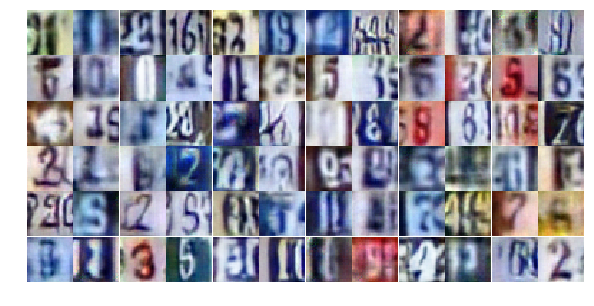

Epoch 20/30... Discriminator Loss: 0.6499... Generator Loss: 1.1334
Epoch 20/30... Discriminator Loss: 1.4210... Generator Loss: 0.4305
Epoch 20/30... Discriminator Loss: 0.5438... Generator Loss: 1.9133
Epoch 20/30... Discriminator Loss: 1.9618... Generator Loss: 0.2442
Epoch 20/30... Discriminator Loss: 1.0604... Generator Loss: 0.6652
Epoch 20/30... Discriminator Loss: 0.5457... Generator Loss: 1.5456
Epoch 20/30... Discriminator Loss: 0.8640... Generator Loss: 0.8749
Epoch 20/30... Discriminator Loss: 1.4978... Generator Loss: 0.3551
Epoch 20/30... Discriminator Loss: 1.1776... Generator Loss: 0.5915
Epoch 20/30... Discriminator Loss: 0.6344... Generator Loss: 1.2587


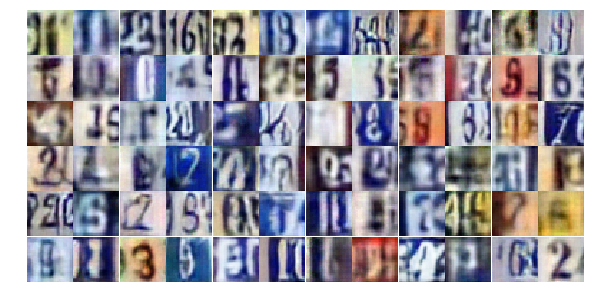

Epoch 20/30... Discriminator Loss: 0.8753... Generator Loss: 0.9420
Epoch 20/30... Discriminator Loss: 1.1677... Generator Loss: 0.5508
Epoch 20/30... Discriminator Loss: 0.9987... Generator Loss: 0.8465
Epoch 20/30... Discriminator Loss: 0.7578... Generator Loss: 1.2696
Epoch 20/30... Discriminator Loss: 1.3060... Generator Loss: 0.4728
Epoch 20/30... Discriminator Loss: 0.8543... Generator Loss: 0.7948
Epoch 20/30... Discriminator Loss: 0.8160... Generator Loss: 1.0571
Epoch 20/30... Discriminator Loss: 1.0392... Generator Loss: 0.6746
Epoch 20/30... Discriminator Loss: 0.9779... Generator Loss: 0.6816
Epoch 20/30... Discriminator Loss: 1.5124... Generator Loss: 0.4147


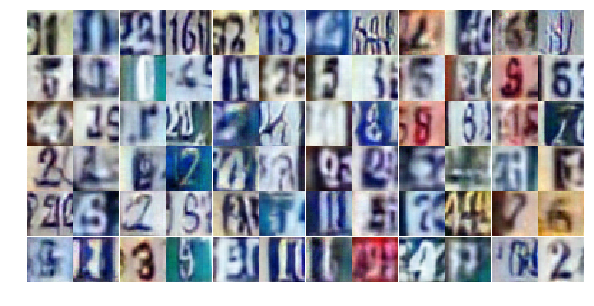

Epoch 20/30... Discriminator Loss: 1.3682... Generator Loss: 0.4130
Epoch 20/30... Discriminator Loss: 0.9469... Generator Loss: 0.8384
Epoch 20/30... Discriminator Loss: 0.4721... Generator Loss: 2.3889
Epoch 20/30... Discriminator Loss: 0.5253... Generator Loss: 1.5214
Epoch 20/30... Discriminator Loss: 0.7794... Generator Loss: 1.2270
Epoch 20/30... Discriminator Loss: 1.2075... Generator Loss: 0.4907
Epoch 20/30... Discriminator Loss: 0.8938... Generator Loss: 0.8821
Epoch 20/30... Discriminator Loss: 0.4459... Generator Loss: 1.7904
Epoch 20/30... Discriminator Loss: 0.8267... Generator Loss: 0.9182
Epoch 20/30... Discriminator Loss: 0.8407... Generator Loss: 0.9988


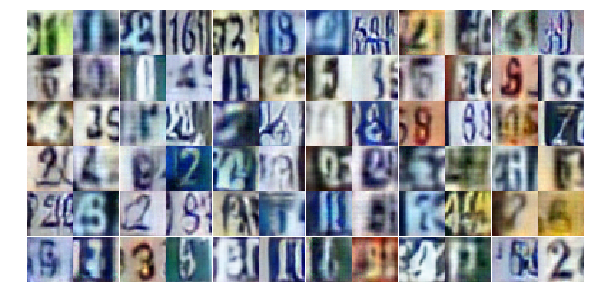

Epoch 20/30... Discriminator Loss: 0.8015... Generator Loss: 0.8409
Epoch 20/30... Discriminator Loss: 0.9060... Generator Loss: 1.0652
Epoch 20/30... Discriminator Loss: 0.6227... Generator Loss: 1.2181
Epoch 20/30... Discriminator Loss: 1.2433... Generator Loss: 0.5316
Epoch 20/30... Discriminator Loss: 0.7084... Generator Loss: 0.9303
Epoch 20/30... Discriminator Loss: 0.6563... Generator Loss: 1.0436
Epoch 21/30... Discriminator Loss: 1.1374... Generator Loss: 0.5780
Epoch 21/30... Discriminator Loss: 0.7384... Generator Loss: 1.0101
Epoch 21/30... Discriminator Loss: 1.4226... Generator Loss: 0.3983
Epoch 21/30... Discriminator Loss: 1.2533... Generator Loss: 0.4750


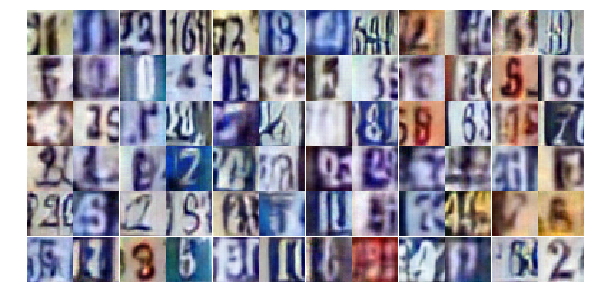

Epoch 21/30... Discriminator Loss: 1.2934... Generator Loss: 0.4495
Epoch 21/30... Discriminator Loss: 1.8193... Generator Loss: 0.2470
Epoch 21/30... Discriminator Loss: 0.6525... Generator Loss: 1.2622
Epoch 21/30... Discriminator Loss: 0.6491... Generator Loss: 1.1369
Epoch 21/30... Discriminator Loss: 0.9404... Generator Loss: 1.2029
Epoch 21/30... Discriminator Loss: 0.5613... Generator Loss: 1.2477
Epoch 21/30... Discriminator Loss: 1.2258... Generator Loss: 0.4827
Epoch 21/30... Discriminator Loss: 0.6560... Generator Loss: 1.3822
Epoch 21/30... Discriminator Loss: 0.4675... Generator Loss: 1.4350
Epoch 21/30... Discriminator Loss: 0.9437... Generator Loss: 0.6866


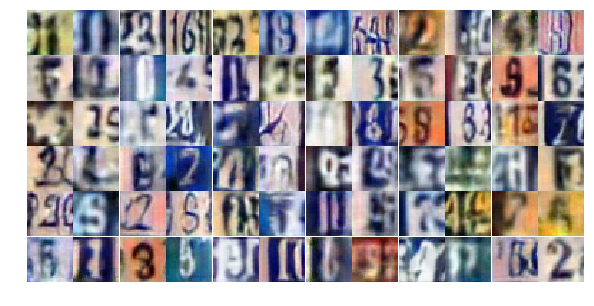

Epoch 21/30... Discriminator Loss: 0.3821... Generator Loss: 1.6470
Epoch 21/30... Discriminator Loss: 0.7203... Generator Loss: 1.0081
Epoch 21/30... Discriminator Loss: 1.7552... Generator Loss: 0.3077
Epoch 21/30... Discriminator Loss: 0.8876... Generator Loss: 0.7807
Epoch 21/30... Discriminator Loss: 0.4190... Generator Loss: 2.2369
Epoch 21/30... Discriminator Loss: 1.2899... Generator Loss: 0.4300
Epoch 21/30... Discriminator Loss: 1.1832... Generator Loss: 0.6980
Epoch 21/30... Discriminator Loss: 0.4013... Generator Loss: 1.8786
Epoch 21/30... Discriminator Loss: 0.5800... Generator Loss: 1.1640
Epoch 21/30... Discriminator Loss: 0.7856... Generator Loss: 1.1038


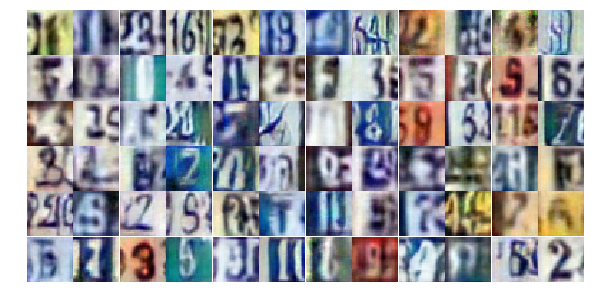

Epoch 21/30... Discriminator Loss: 1.7449... Generator Loss: 0.2642
Epoch 21/30... Discriminator Loss: 0.5727... Generator Loss: 1.3818
Epoch 21/30... Discriminator Loss: 0.6904... Generator Loss: 1.0483
Epoch 21/30... Discriminator Loss: 0.9804... Generator Loss: 0.8699
Epoch 21/30... Discriminator Loss: 1.1541... Generator Loss: 0.6213
Epoch 21/30... Discriminator Loss: 1.1600... Generator Loss: 0.6048
Epoch 21/30... Discriminator Loss: 0.5443... Generator Loss: 1.2275
Epoch 21/30... Discriminator Loss: 1.1142... Generator Loss: 0.5981
Epoch 21/30... Discriminator Loss: 1.4125... Generator Loss: 0.4158
Epoch 21/30... Discriminator Loss: 1.7367... Generator Loss: 0.3171


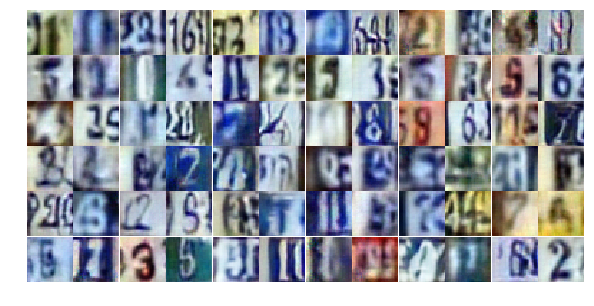

Epoch 21/30... Discriminator Loss: 0.9140... Generator Loss: 0.8132
Epoch 21/30... Discriminator Loss: 1.1270... Generator Loss: 0.6102
Epoch 21/30... Discriminator Loss: 1.3365... Generator Loss: 0.4283
Epoch 21/30... Discriminator Loss: 0.5959... Generator Loss: 1.3088
Epoch 21/30... Discriminator Loss: 0.5316... Generator Loss: 1.3060
Epoch 21/30... Discriminator Loss: 0.8961... Generator Loss: 0.7705
Epoch 21/30... Discriminator Loss: 1.3081... Generator Loss: 0.4593
Epoch 21/30... Discriminator Loss: 1.8154... Generator Loss: 0.2674
Epoch 21/30... Discriminator Loss: 0.9366... Generator Loss: 0.6620
Epoch 21/30... Discriminator Loss: 0.5102... Generator Loss: 1.2323


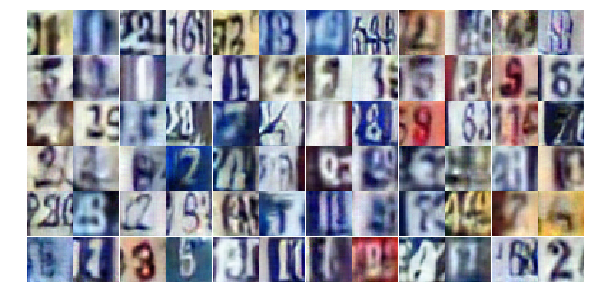

Epoch 21/30... Discriminator Loss: 0.7553... Generator Loss: 1.3433
Epoch 21/30... Discriminator Loss: 1.3120... Generator Loss: 0.4514
Epoch 21/30... Discriminator Loss: 0.5015... Generator Loss: 1.2652
Epoch 21/30... Discriminator Loss: 0.9287... Generator Loss: 0.8885
Epoch 21/30... Discriminator Loss: 0.4393... Generator Loss: 1.4795
Epoch 21/30... Discriminator Loss: 0.7548... Generator Loss: 1.4295
Epoch 21/30... Discriminator Loss: 0.8861... Generator Loss: 0.9021
Epoch 21/30... Discriminator Loss: 1.3231... Generator Loss: 0.4472
Epoch 21/30... Discriminator Loss: 0.5166... Generator Loss: 1.6293
Epoch 21/30... Discriminator Loss: 1.4971... Generator Loss: 0.3575


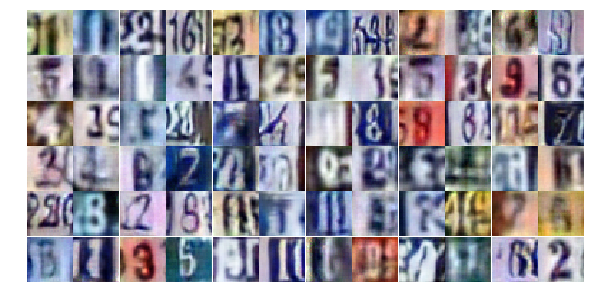

Epoch 21/30... Discriminator Loss: 0.4879... Generator Loss: 1.4956
Epoch 21/30... Discriminator Loss: 1.1037... Generator Loss: 0.5785
Epoch 21/30... Discriminator Loss: 0.6651... Generator Loss: 1.0860
Epoch 22/30... Discriminator Loss: 1.0393... Generator Loss: 0.6799
Epoch 22/30... Discriminator Loss: 1.3459... Generator Loss: 0.4212
Epoch 22/30... Discriminator Loss: 1.2147... Generator Loss: 0.5853
Epoch 22/30... Discriminator Loss: 1.3203... Generator Loss: 0.6196
Epoch 22/30... Discriminator Loss: 0.7707... Generator Loss: 0.9103
Epoch 22/30... Discriminator Loss: 1.4340... Generator Loss: 0.3825
Epoch 22/30... Discriminator Loss: 0.9273... Generator Loss: 0.7308


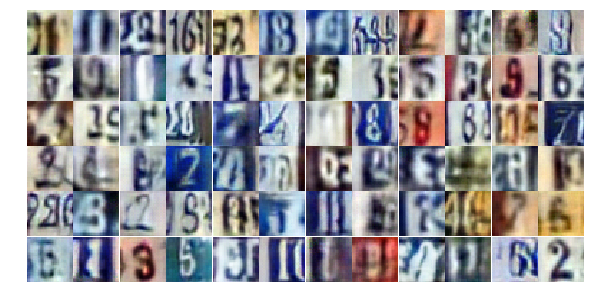

Epoch 22/30... Discriminator Loss: 0.8680... Generator Loss: 0.9648
Epoch 22/30... Discriminator Loss: 0.8361... Generator Loss: 0.9284
Epoch 22/30... Discriminator Loss: 1.3220... Generator Loss: 0.4523
Epoch 22/30... Discriminator Loss: 1.0147... Generator Loss: 0.6474
Epoch 22/30... Discriminator Loss: 0.8112... Generator Loss: 0.9291
Epoch 22/30... Discriminator Loss: 0.6503... Generator Loss: 1.1641
Epoch 22/30... Discriminator Loss: 1.0058... Generator Loss: 0.6767
Epoch 22/30... Discriminator Loss: 0.8851... Generator Loss: 1.0170
Epoch 22/30... Discriminator Loss: 1.5262... Generator Loss: 0.3845
Epoch 22/30... Discriminator Loss: 1.5093... Generator Loss: 0.3455


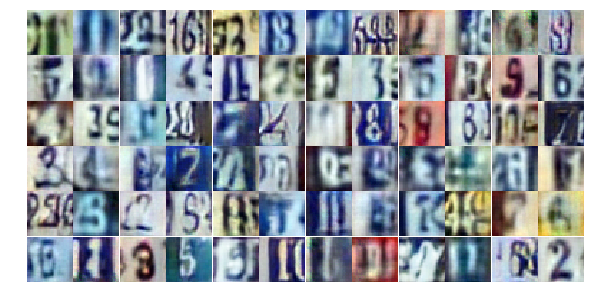

Epoch 22/30... Discriminator Loss: 0.6727... Generator Loss: 1.1281
Epoch 22/30... Discriminator Loss: 0.8543... Generator Loss: 0.7754
Epoch 22/30... Discriminator Loss: 0.7385... Generator Loss: 1.3968
Epoch 22/30... Discriminator Loss: 0.6492... Generator Loss: 1.3782
Epoch 22/30... Discriminator Loss: 0.7053... Generator Loss: 1.1591
Epoch 22/30... Discriminator Loss: 0.8730... Generator Loss: 1.0614
Epoch 22/30... Discriminator Loss: 0.7399... Generator Loss: 1.3087
Epoch 22/30... Discriminator Loss: 0.4078... Generator Loss: 1.9305
Epoch 22/30... Discriminator Loss: 0.7178... Generator Loss: 1.1340
Epoch 22/30... Discriminator Loss: 0.8212... Generator Loss: 0.8411


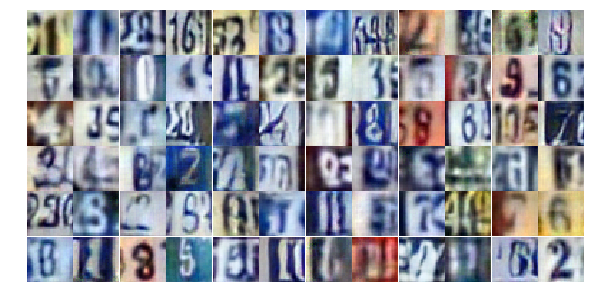

Epoch 22/30... Discriminator Loss: 0.6133... Generator Loss: 1.3431
Epoch 22/30... Discriminator Loss: 0.7001... Generator Loss: 1.4908
Epoch 22/30... Discriminator Loss: 0.9012... Generator Loss: 0.7982
Epoch 22/30... Discriminator Loss: 0.6172... Generator Loss: 1.1249
Epoch 22/30... Discriminator Loss: 0.9434... Generator Loss: 0.7414
Epoch 22/30... Discriminator Loss: 1.3089... Generator Loss: 0.4387
Epoch 22/30... Discriminator Loss: 1.5355... Generator Loss: 0.3781
Epoch 22/30... Discriminator Loss: 0.7745... Generator Loss: 1.2381
Epoch 22/30... Discriminator Loss: 0.8353... Generator Loss: 0.8892
Epoch 22/30... Discriminator Loss: 0.5116... Generator Loss: 1.3129


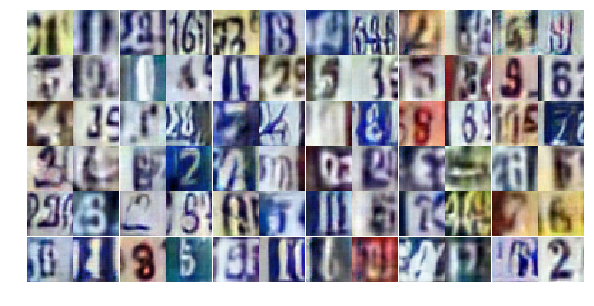

Epoch 22/30... Discriminator Loss: 0.7129... Generator Loss: 1.2951
Epoch 22/30... Discriminator Loss: 0.7642... Generator Loss: 1.0898
Epoch 22/30... Discriminator Loss: 0.5072... Generator Loss: 1.4370
Epoch 22/30... Discriminator Loss: 0.9561... Generator Loss: 0.7685
Epoch 22/30... Discriminator Loss: 0.9058... Generator Loss: 0.7458
Epoch 22/30... Discriminator Loss: 0.7246... Generator Loss: 0.9868
Epoch 22/30... Discriminator Loss: 1.0442... Generator Loss: 0.7207
Epoch 22/30... Discriminator Loss: 1.3381... Generator Loss: 0.7110
Epoch 22/30... Discriminator Loss: 1.9372... Generator Loss: 0.2622
Epoch 22/30... Discriminator Loss: 0.6743... Generator Loss: 1.1118


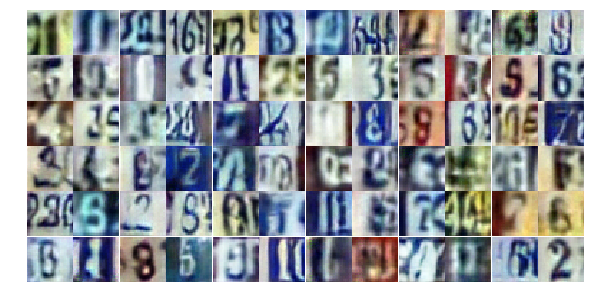

Epoch 22/30... Discriminator Loss: 1.4147... Generator Loss: 0.3855
Epoch 22/30... Discriminator Loss: 0.8528... Generator Loss: 1.0984
Epoch 22/30... Discriminator Loss: 1.0053... Generator Loss: 0.6838
Epoch 22/30... Discriminator Loss: 1.1654... Generator Loss: 0.5821
Epoch 22/30... Discriminator Loss: 0.8996... Generator Loss: 0.8570
Epoch 22/30... Discriminator Loss: 0.8110... Generator Loss: 0.8541
Epoch 22/30... Discriminator Loss: 1.0516... Generator Loss: 0.6668
Epoch 22/30... Discriminator Loss: 0.8777... Generator Loss: 0.7468
Epoch 22/30... Discriminator Loss: 0.9163... Generator Loss: 1.0438
Epoch 22/30... Discriminator Loss: 1.1907... Generator Loss: 0.6269


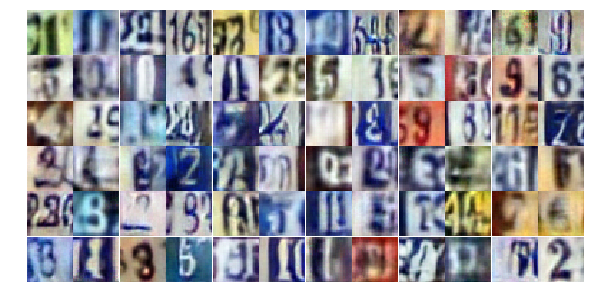

Epoch 23/30... Discriminator Loss: 0.5575... Generator Loss: 1.4758
Epoch 23/30... Discriminator Loss: 0.7721... Generator Loss: 0.8832
Epoch 23/30... Discriminator Loss: 1.2294... Generator Loss: 0.4976
Epoch 23/30... Discriminator Loss: 0.7570... Generator Loss: 1.6340
Epoch 23/30... Discriminator Loss: 0.6295... Generator Loss: 1.2802
Epoch 23/30... Discriminator Loss: 1.5290... Generator Loss: 0.3765
Epoch 23/30... Discriminator Loss: 1.9803... Generator Loss: 0.2281
Epoch 23/30... Discriminator Loss: 0.8131... Generator Loss: 1.0139
Epoch 23/30... Discriminator Loss: 1.0477... Generator Loss: 0.6345
Epoch 23/30... Discriminator Loss: 0.6036... Generator Loss: 1.1019


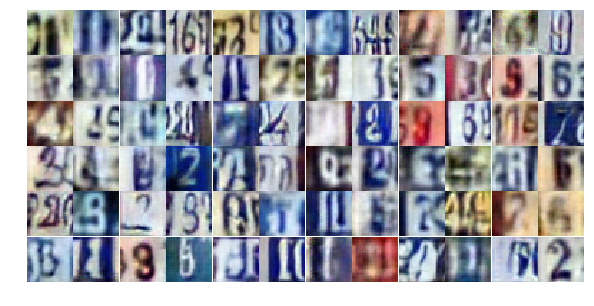

Epoch 23/30... Discriminator Loss: 0.7061... Generator Loss: 1.0151
Epoch 23/30... Discriminator Loss: 0.6684... Generator Loss: 0.9742
Epoch 23/30... Discriminator Loss: 0.9268... Generator Loss: 0.8200
Epoch 23/30... Discriminator Loss: 0.9177... Generator Loss: 0.8292
Epoch 23/30... Discriminator Loss: 0.6599... Generator Loss: 1.1967
Epoch 23/30... Discriminator Loss: 1.1819... Generator Loss: 0.5375
Epoch 23/30... Discriminator Loss: 0.9749... Generator Loss: 0.6997
Epoch 23/30... Discriminator Loss: 0.7993... Generator Loss: 0.9106
Epoch 23/30... Discriminator Loss: 0.9251... Generator Loss: 0.9880
Epoch 23/30... Discriminator Loss: 0.9343... Generator Loss: 0.7511


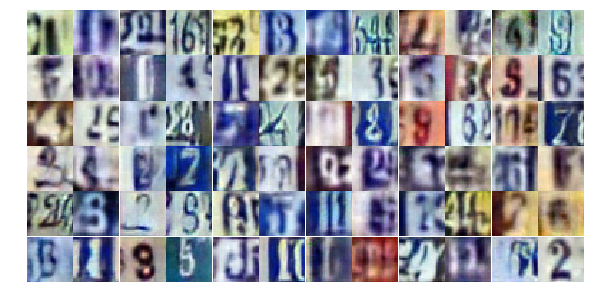

Epoch 23/30... Discriminator Loss: 0.9105... Generator Loss: 0.7467
Epoch 23/30... Discriminator Loss: 0.6874... Generator Loss: 2.1814
Epoch 23/30... Discriminator Loss: 1.0939... Generator Loss: 0.5956
Epoch 23/30... Discriminator Loss: 0.9774... Generator Loss: 0.6697
Epoch 23/30... Discriminator Loss: 0.7289... Generator Loss: 1.1006
Epoch 23/30... Discriminator Loss: 0.5699... Generator Loss: 1.6657
Epoch 23/30... Discriminator Loss: 0.8109... Generator Loss: 0.8910
Epoch 23/30... Discriminator Loss: 0.4089... Generator Loss: 1.8413
Epoch 23/30... Discriminator Loss: 1.3466... Generator Loss: 0.4850
Epoch 23/30... Discriminator Loss: 1.9513... Generator Loss: 0.2219


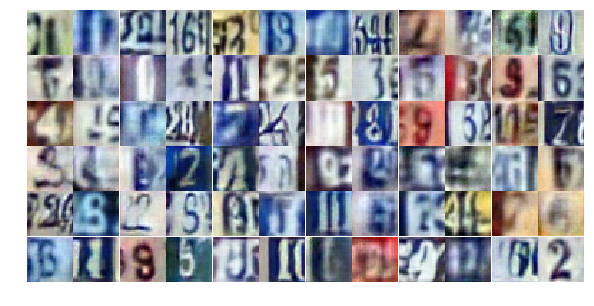

Epoch 23/30... Discriminator Loss: 0.7379... Generator Loss: 0.9843
Epoch 23/30... Discriminator Loss: 0.6087... Generator Loss: 1.3046
Epoch 23/30... Discriminator Loss: 0.8651... Generator Loss: 0.9221
Epoch 23/30... Discriminator Loss: 1.9103... Generator Loss: 0.2287
Epoch 23/30... Discriminator Loss: 0.9081... Generator Loss: 1.1821
Epoch 23/30... Discriminator Loss: 1.3852... Generator Loss: 0.3936
Epoch 23/30... Discriminator Loss: 1.1288... Generator Loss: 0.6690
Epoch 23/30... Discriminator Loss: 0.7809... Generator Loss: 0.9213
Epoch 23/30... Discriminator Loss: 0.7327... Generator Loss: 0.8946
Epoch 23/30... Discriminator Loss: 0.6484... Generator Loss: 1.3553


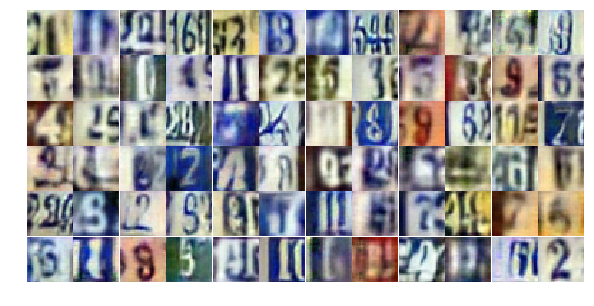

Epoch 23/30... Discriminator Loss: 0.9920... Generator Loss: 0.8339
Epoch 23/30... Discriminator Loss: 0.7923... Generator Loss: 1.5838
Epoch 23/30... Discriminator Loss: 1.1920... Generator Loss: 0.4890
Epoch 23/30... Discriminator Loss: 0.6727... Generator Loss: 1.5920
Epoch 23/30... Discriminator Loss: 1.8283... Generator Loss: 0.2595
Epoch 23/30... Discriminator Loss: 1.0584... Generator Loss: 0.6134
Epoch 23/30... Discriminator Loss: 0.9350... Generator Loss: 0.8283
Epoch 23/30... Discriminator Loss: 1.5708... Generator Loss: 0.3391
Epoch 23/30... Discriminator Loss: 0.7686... Generator Loss: 0.9913
Epoch 23/30... Discriminator Loss: 0.6957... Generator Loss: 1.0880


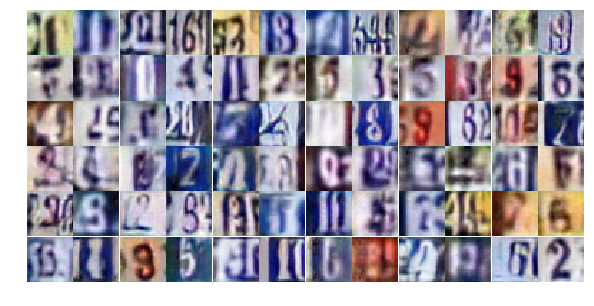

Epoch 23/30... Discriminator Loss: 0.6707... Generator Loss: 1.0456
Epoch 23/30... Discriminator Loss: 1.2209... Generator Loss: 0.4960
Epoch 23/30... Discriminator Loss: 1.0287... Generator Loss: 0.6281
Epoch 23/30... Discriminator Loss: 0.5136... Generator Loss: 1.5824
Epoch 23/30... Discriminator Loss: 1.5606... Generator Loss: 0.3286
Epoch 23/30... Discriminator Loss: 0.6130... Generator Loss: 1.2944
Epoch 23/30... Discriminator Loss: 1.3531... Generator Loss: 0.4109
Epoch 24/30... Discriminator Loss: 1.4519... Generator Loss: 0.3939
Epoch 24/30... Discriminator Loss: 0.9101... Generator Loss: 0.7777
Epoch 24/30... Discriminator Loss: 1.2804... Generator Loss: 0.5844


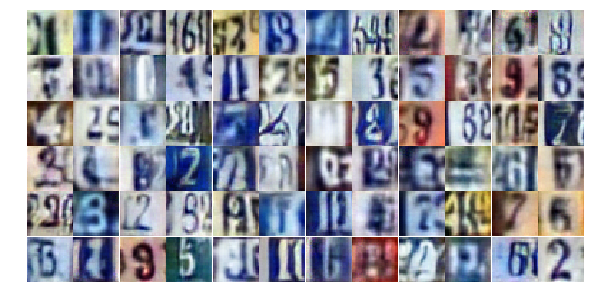

Epoch 24/30... Discriminator Loss: 0.8095... Generator Loss: 2.1913
Epoch 24/30... Discriminator Loss: 0.6618... Generator Loss: 1.2361
Epoch 24/30... Discriminator Loss: 1.0946... Generator Loss: 0.5681
Epoch 24/30... Discriminator Loss: 0.9265... Generator Loss: 1.4664
Epoch 24/30... Discriminator Loss: 1.1489... Generator Loss: 0.5108
Epoch 24/30... Discriminator Loss: 0.8534... Generator Loss: 0.7687
Epoch 24/30... Discriminator Loss: 0.8283... Generator Loss: 0.9531
Epoch 24/30... Discriminator Loss: 1.1834... Generator Loss: 0.5377
Epoch 24/30... Discriminator Loss: 0.5608... Generator Loss: 1.2249
Epoch 24/30... Discriminator Loss: 0.5315... Generator Loss: 1.4921


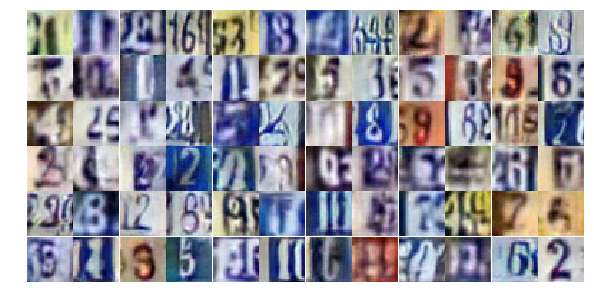

Epoch 24/30... Discriminator Loss: 1.2624... Generator Loss: 0.4832
Epoch 24/30... Discriminator Loss: 1.0916... Generator Loss: 0.5553
Epoch 24/30... Discriminator Loss: 1.3464... Generator Loss: 0.4892
Epoch 24/30... Discriminator Loss: 0.6507... Generator Loss: 1.0385
Epoch 24/30... Discriminator Loss: 1.0271... Generator Loss: 1.4054
Epoch 24/30... Discriminator Loss: 1.0582... Generator Loss: 0.6056
Epoch 24/30... Discriminator Loss: 0.7215... Generator Loss: 1.0462
Epoch 24/30... Discriminator Loss: 0.9470... Generator Loss: 1.4365
Epoch 24/30... Discriminator Loss: 0.7443... Generator Loss: 0.9833
Epoch 24/30... Discriminator Loss: 0.6487... Generator Loss: 1.0235


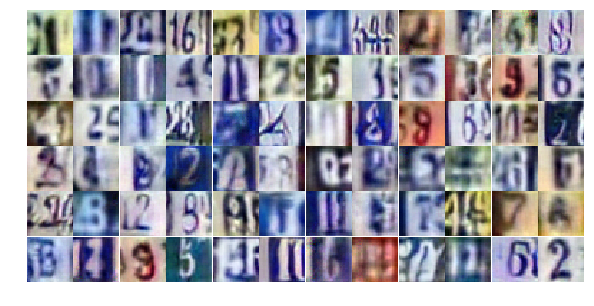

Epoch 24/30... Discriminator Loss: 0.7963... Generator Loss: 0.8532
Epoch 24/30... Discriminator Loss: 0.7929... Generator Loss: 0.9127
Epoch 24/30... Discriminator Loss: 0.6098... Generator Loss: 1.3667
Epoch 24/30... Discriminator Loss: 1.5867... Generator Loss: 0.2999
Epoch 24/30... Discriminator Loss: 1.0420... Generator Loss: 0.6391
Epoch 24/30... Discriminator Loss: 0.3172... Generator Loss: 2.6082
Epoch 24/30... Discriminator Loss: 0.5521... Generator Loss: 1.3330
Epoch 24/30... Discriminator Loss: 0.8321... Generator Loss: 1.0678
Epoch 24/30... Discriminator Loss: 0.7172... Generator Loss: 0.9751
Epoch 24/30... Discriminator Loss: 0.7236... Generator Loss: 1.5257


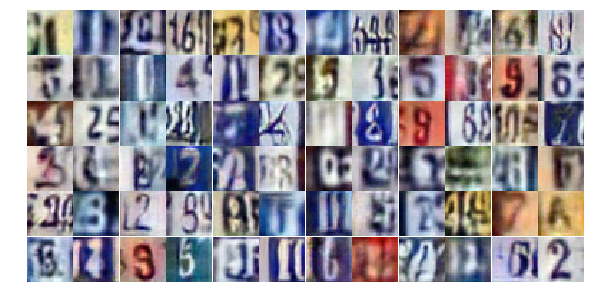

Epoch 24/30... Discriminator Loss: 0.7045... Generator Loss: 1.0975
Epoch 24/30... Discriminator Loss: 0.5650... Generator Loss: 1.7780
Epoch 24/30... Discriminator Loss: 1.1257... Generator Loss: 0.5429
Epoch 24/30... Discriminator Loss: 1.8098... Generator Loss: 0.2416
Epoch 24/30... Discriminator Loss: 1.4475... Generator Loss: 0.3696
Epoch 24/30... Discriminator Loss: 1.1242... Generator Loss: 0.6269
Epoch 24/30... Discriminator Loss: 1.9940... Generator Loss: 0.2274
Epoch 24/30... Discriminator Loss: 0.8839... Generator Loss: 0.8217
Epoch 24/30... Discriminator Loss: 0.8473... Generator Loss: 0.9977
Epoch 24/30... Discriminator Loss: 0.7314... Generator Loss: 2.4939


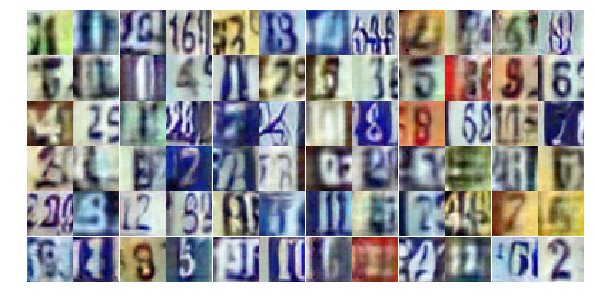

Epoch 24/30... Discriminator Loss: 0.7227... Generator Loss: 1.0637
Epoch 24/30... Discriminator Loss: 3.0448... Generator Loss: 4.3965
Epoch 24/30... Discriminator Loss: 2.6384... Generator Loss: 0.1428
Epoch 24/30... Discriminator Loss: 1.3942... Generator Loss: 2.2616
Epoch 24/30... Discriminator Loss: 1.4905... Generator Loss: 0.4481
Epoch 24/30... Discriminator Loss: 0.9192... Generator Loss: 1.3135
Epoch 24/30... Discriminator Loss: 1.5601... Generator Loss: 0.3518
Epoch 24/30... Discriminator Loss: 0.5580... Generator Loss: 1.4409
Epoch 24/30... Discriminator Loss: 1.2627... Generator Loss: 0.5373
Epoch 24/30... Discriminator Loss: 0.9612... Generator Loss: 1.0507


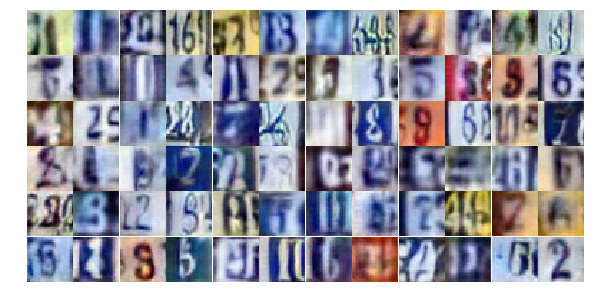

Epoch 24/30... Discriminator Loss: 1.2348... Generator Loss: 0.5445
Epoch 24/30... Discriminator Loss: 1.2758... Generator Loss: 0.4887
Epoch 24/30... Discriminator Loss: 1.0258... Generator Loss: 0.6528
Epoch 24/30... Discriminator Loss: 1.0895... Generator Loss: 0.7381
Epoch 24/30... Discriminator Loss: 1.1645... Generator Loss: 0.5561
Epoch 25/30... Discriminator Loss: 1.0436... Generator Loss: 0.7277
Epoch 25/30... Discriminator Loss: 0.6225... Generator Loss: 1.2567
Epoch 25/30... Discriminator Loss: 0.9937... Generator Loss: 0.6973
Epoch 25/30... Discriminator Loss: 0.8191... Generator Loss: 0.8338
Epoch 25/30... Discriminator Loss: 1.0703... Generator Loss: 0.6062


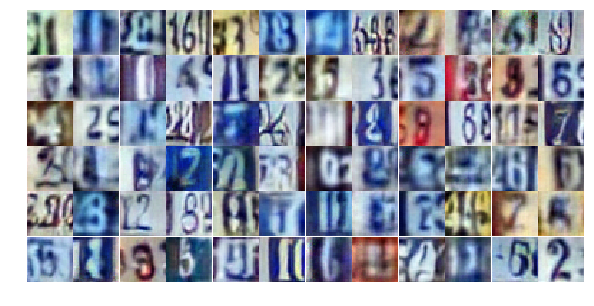

Epoch 25/30... Discriminator Loss: 1.0260... Generator Loss: 1.6986
Epoch 25/30... Discriminator Loss: 1.2628... Generator Loss: 0.8160
Epoch 25/30... Discriminator Loss: 0.7313... Generator Loss: 0.9211
Epoch 25/30... Discriminator Loss: 0.9481... Generator Loss: 0.7428
Epoch 25/30... Discriminator Loss: 1.0127... Generator Loss: 0.7494
Epoch 25/30... Discriminator Loss: 0.9842... Generator Loss: 0.7264
Epoch 25/30... Discriminator Loss: 0.7990... Generator Loss: 0.8453
Epoch 25/30... Discriminator Loss: 1.0599... Generator Loss: 0.6075
Epoch 25/30... Discriminator Loss: 0.6542... Generator Loss: 1.1021
Epoch 25/30... Discriminator Loss: 1.0730... Generator Loss: 0.6248


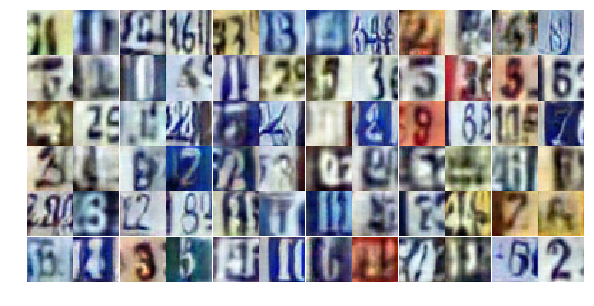

Epoch 25/30... Discriminator Loss: 0.8698... Generator Loss: 0.9304
Epoch 25/30... Discriminator Loss: 0.6286... Generator Loss: 1.2875
Epoch 25/30... Discriminator Loss: 1.1340... Generator Loss: 0.5684
Epoch 25/30... Discriminator Loss: 1.0226... Generator Loss: 0.7769
Epoch 25/30... Discriminator Loss: 1.0032... Generator Loss: 0.6996
Epoch 25/30... Discriminator Loss: 0.5682... Generator Loss: 1.4145
Epoch 25/30... Discriminator Loss: 1.1110... Generator Loss: 0.5889
Epoch 25/30... Discriminator Loss: 1.0902... Generator Loss: 0.8420
Epoch 25/30... Discriminator Loss: 0.7657... Generator Loss: 0.9236
Epoch 25/30... Discriminator Loss: 1.0072... Generator Loss: 0.6516


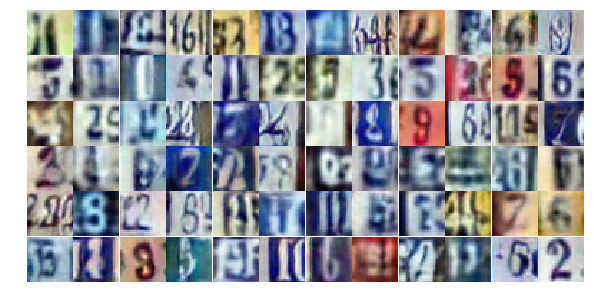

Epoch 25/30... Discriminator Loss: 1.6562... Generator Loss: 0.3205
Epoch 25/30... Discriminator Loss: 0.9520... Generator Loss: 0.7285
Epoch 25/30... Discriminator Loss: 0.7846... Generator Loss: 1.2883
Epoch 25/30... Discriminator Loss: 0.8428... Generator Loss: 0.9355
Epoch 25/30... Discriminator Loss: 1.3052... Generator Loss: 0.4317
Epoch 25/30... Discriminator Loss: 0.5796... Generator Loss: 1.3716
Epoch 25/30... Discriminator Loss: 0.9995... Generator Loss: 0.7519
Epoch 25/30... Discriminator Loss: 0.8576... Generator Loss: 0.8150
Epoch 25/30... Discriminator Loss: 1.0017... Generator Loss: 0.9904
Epoch 25/30... Discriminator Loss: 1.0723... Generator Loss: 0.6087


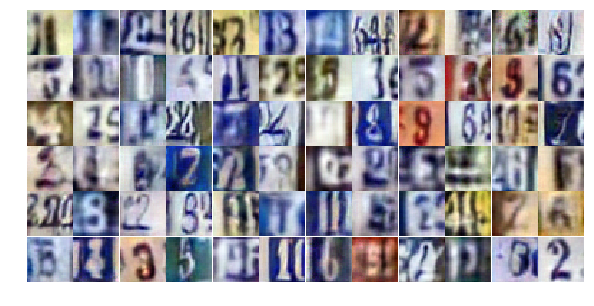

Epoch 25/30... Discriminator Loss: 1.0107... Generator Loss: 0.7882
Epoch 25/30... Discriminator Loss: 0.4959... Generator Loss: 1.5366
Epoch 25/30... Discriminator Loss: 1.0688... Generator Loss: 0.6650
Epoch 25/30... Discriminator Loss: 0.8548... Generator Loss: 0.8634
Epoch 25/30... Discriminator Loss: 1.2519... Generator Loss: 0.5127
Epoch 25/30... Discriminator Loss: 0.9716... Generator Loss: 0.7259
Epoch 25/30... Discriminator Loss: 0.7380... Generator Loss: 1.0023
Epoch 25/30... Discriminator Loss: 0.8878... Generator Loss: 0.8038
Epoch 25/30... Discriminator Loss: 2.0138... Generator Loss: 0.2741
Epoch 25/30... Discriminator Loss: 0.5030... Generator Loss: 1.2759


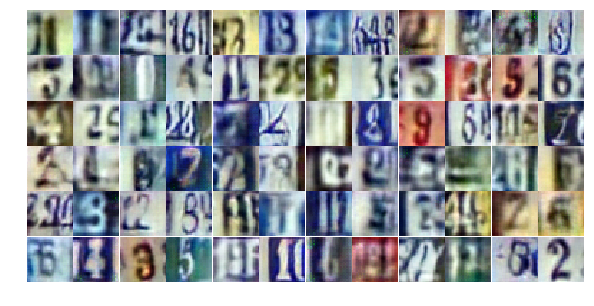

Epoch 25/30... Discriminator Loss: 1.5616... Generator Loss: 2.1566
Epoch 25/30... Discriminator Loss: 0.9384... Generator Loss: 0.7354
Epoch 25/30... Discriminator Loss: 0.8555... Generator Loss: 0.8396
Epoch 25/30... Discriminator Loss: 1.1499... Generator Loss: 0.7345
Epoch 25/30... Discriminator Loss: 1.1246... Generator Loss: 0.6097
Epoch 25/30... Discriminator Loss: 0.5228... Generator Loss: 1.3879
Epoch 25/30... Discriminator Loss: 1.2728... Generator Loss: 0.4687
Epoch 25/30... Discriminator Loss: 0.4839... Generator Loss: 3.2184
Epoch 25/30... Discriminator Loss: 0.7570... Generator Loss: 1.6907
Epoch 25/30... Discriminator Loss: 1.9257... Generator Loss: 0.2426


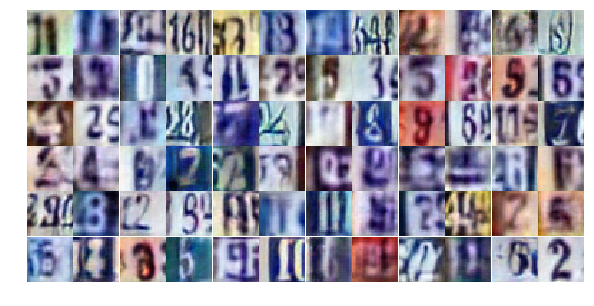

Epoch 25/30... Discriminator Loss: 0.7923... Generator Loss: 1.5901
Epoch 25/30... Discriminator Loss: 1.3198... Generator Loss: 0.4525
Epoch 26/30... Discriminator Loss: 1.0695... Generator Loss: 0.6403
Epoch 26/30... Discriminator Loss: 0.5711... Generator Loss: 1.1583
Epoch 26/30... Discriminator Loss: 0.9100... Generator Loss: 0.7998
Epoch 26/30... Discriminator Loss: 0.8020... Generator Loss: 0.8758
Epoch 26/30... Discriminator Loss: 1.0757... Generator Loss: 0.6554
Epoch 26/30... Discriminator Loss: 0.8655... Generator Loss: 0.9368
Epoch 26/30... Discriminator Loss: 0.9743... Generator Loss: 0.6785
Epoch 26/30... Discriminator Loss: 1.8935... Generator Loss: 0.2508


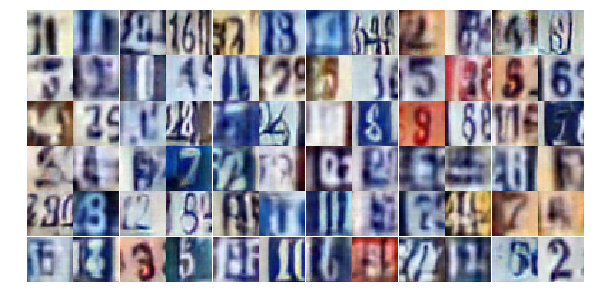

Epoch 26/30... Discriminator Loss: 1.3939... Generator Loss: 0.4087
Epoch 26/30... Discriminator Loss: 1.0719... Generator Loss: 0.6048
Epoch 26/30... Discriminator Loss: 0.8035... Generator Loss: 1.0074
Epoch 26/30... Discriminator Loss: 1.1499... Generator Loss: 0.5411
Epoch 26/30... Discriminator Loss: 0.6046... Generator Loss: 1.2018
Epoch 26/30... Discriminator Loss: 0.9202... Generator Loss: 0.8015
Epoch 26/30... Discriminator Loss: 1.1235... Generator Loss: 0.5579
Epoch 26/30... Discriminator Loss: 1.0298... Generator Loss: 0.6935
Epoch 26/30... Discriminator Loss: 0.3940... Generator Loss: 1.7565
Epoch 26/30... Discriminator Loss: 1.5554... Generator Loss: 0.3370


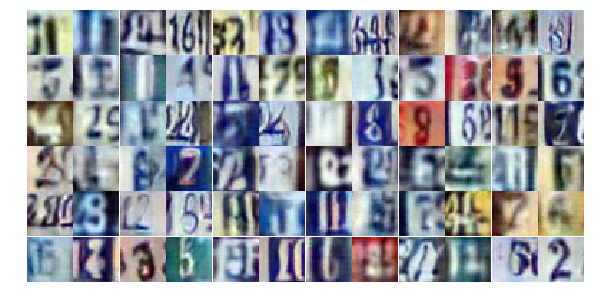

Epoch 26/30... Discriminator Loss: 0.3744... Generator Loss: 1.5579
Epoch 26/30... Discriminator Loss: 1.1560... Generator Loss: 0.6260
Epoch 26/30... Discriminator Loss: 0.6360... Generator Loss: 1.3669
Epoch 26/30... Discriminator Loss: 0.7258... Generator Loss: 1.0152
Epoch 26/30... Discriminator Loss: 0.6290... Generator Loss: 1.1151
Epoch 26/30... Discriminator Loss: 0.6906... Generator Loss: 1.0985
Epoch 26/30... Discriminator Loss: 0.9222... Generator Loss: 0.7134
Epoch 26/30... Discriminator Loss: 0.9194... Generator Loss: 0.8204
Epoch 26/30... Discriminator Loss: 1.1592... Generator Loss: 0.5451
Epoch 26/30... Discriminator Loss: 0.8603... Generator Loss: 0.7823


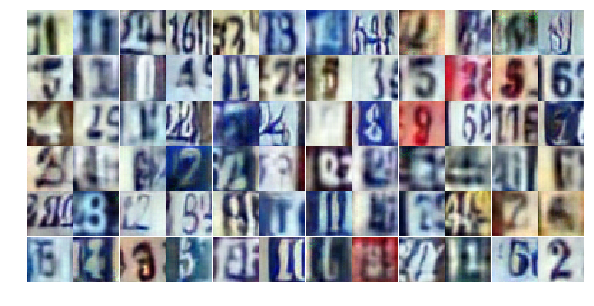

Epoch 26/30... Discriminator Loss: 2.4567... Generator Loss: 4.3511
Epoch 26/30... Discriminator Loss: 1.8381... Generator Loss: 1.1472
Epoch 26/30... Discriminator Loss: 1.1098... Generator Loss: 0.5931
Epoch 26/30... Discriminator Loss: 1.0337... Generator Loss: 0.8009
Epoch 26/30... Discriminator Loss: 0.8865... Generator Loss: 0.8425
Epoch 26/30... Discriminator Loss: 0.9385... Generator Loss: 1.5499
Epoch 26/30... Discriminator Loss: 0.8006... Generator Loss: 1.0640
Epoch 26/30... Discriminator Loss: 1.1655... Generator Loss: 0.5608
Epoch 26/30... Discriminator Loss: 0.7205... Generator Loss: 1.2321
Epoch 26/30... Discriminator Loss: 1.0721... Generator Loss: 0.6296


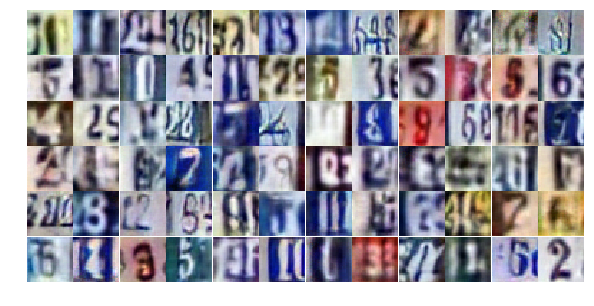

Epoch 26/30... Discriminator Loss: 1.3683... Generator Loss: 0.4334
Epoch 26/30... Discriminator Loss: 1.0553... Generator Loss: 0.6833
Epoch 26/30... Discriminator Loss: 0.7611... Generator Loss: 1.0091
Epoch 26/30... Discriminator Loss: 0.7259... Generator Loss: 1.1298
Epoch 26/30... Discriminator Loss: 0.9463... Generator Loss: 0.7464
Epoch 26/30... Discriminator Loss: 1.6966... Generator Loss: 0.3021
Epoch 26/30... Discriminator Loss: 0.9980... Generator Loss: 0.7051
Epoch 26/30... Discriminator Loss: 0.8166... Generator Loss: 0.8407
Epoch 26/30... Discriminator Loss: 1.2779... Generator Loss: 0.5149
Epoch 26/30... Discriminator Loss: 0.7519... Generator Loss: 1.1184


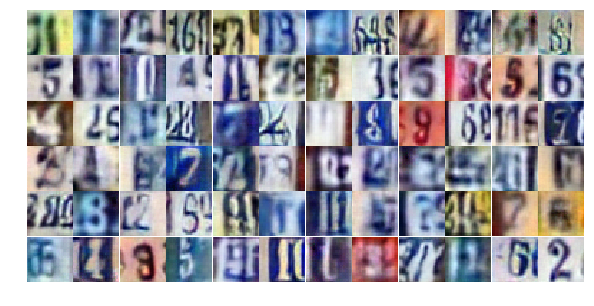

Epoch 26/30... Discriminator Loss: 1.2402... Generator Loss: 0.4891
Epoch 26/30... Discriminator Loss: 0.6105... Generator Loss: 1.1519
Epoch 26/30... Discriminator Loss: 1.2319... Generator Loss: 0.5869
Epoch 26/30... Discriminator Loss: 0.9439... Generator Loss: 1.2405
Epoch 26/30... Discriminator Loss: 0.8324... Generator Loss: 0.9227
Epoch 26/30... Discriminator Loss: 2.0036... Generator Loss: 0.2435
Epoch 26/30... Discriminator Loss: 0.5865... Generator Loss: 2.6121
Epoch 26/30... Discriminator Loss: 0.3991... Generator Loss: 1.8303
Epoch 26/30... Discriminator Loss: 0.8344... Generator Loss: 0.8337
Epoch 27/30... Discriminator Loss: 0.7455... Generator Loss: 1.6536


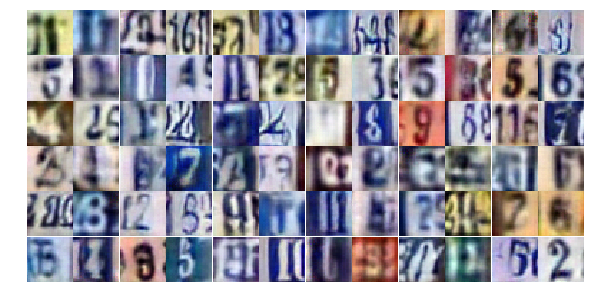

Epoch 27/30... Discriminator Loss: 0.9254... Generator Loss: 1.0445
Epoch 27/30... Discriminator Loss: 0.8008... Generator Loss: 0.9965
Epoch 27/30... Discriminator Loss: 0.7254... Generator Loss: 1.1216
Epoch 27/30... Discriminator Loss: 0.6385... Generator Loss: 1.1066
Epoch 27/30... Discriminator Loss: 0.5636... Generator Loss: 1.6380
Epoch 27/30... Discriminator Loss: 1.0446... Generator Loss: 0.6546
Epoch 27/30... Discriminator Loss: 1.0405... Generator Loss: 0.6256
Epoch 27/30... Discriminator Loss: 1.3476... Generator Loss: 0.4551
Epoch 27/30... Discriminator Loss: 1.8757... Generator Loss: 0.2370
Epoch 27/30... Discriminator Loss: 1.4233... Generator Loss: 0.3833


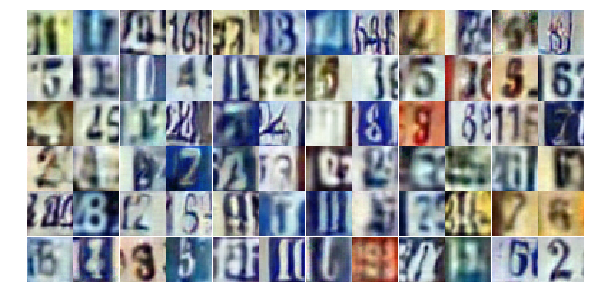

Epoch 27/30... Discriminator Loss: 1.0969... Generator Loss: 0.5846
Epoch 27/30... Discriminator Loss: 0.3929... Generator Loss: 1.8712
Epoch 27/30... Discriminator Loss: 0.6663... Generator Loss: 1.7055
Epoch 27/30... Discriminator Loss: 0.8872... Generator Loss: 1.3123
Epoch 27/30... Discriminator Loss: 0.7989... Generator Loss: 0.9424
Epoch 27/30... Discriminator Loss: 0.5425... Generator Loss: 1.5450
Epoch 27/30... Discriminator Loss: 0.4625... Generator Loss: 1.7427
Epoch 27/30... Discriminator Loss: 0.6702... Generator Loss: 1.0730
Epoch 27/30... Discriminator Loss: 1.1854... Generator Loss: 0.5344
Epoch 27/30... Discriminator Loss: 0.9643... Generator Loss: 0.8874


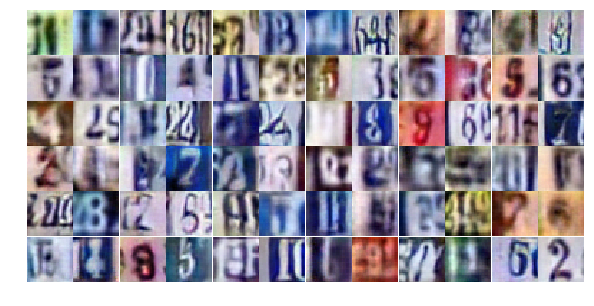

Epoch 27/30... Discriminator Loss: 1.0092... Generator Loss: 0.6412
Epoch 27/30... Discriminator Loss: 0.9344... Generator Loss: 0.7567
Epoch 27/30... Discriminator Loss: 0.6984... Generator Loss: 0.9363
Epoch 27/30... Discriminator Loss: 1.0590... Generator Loss: 0.6102
Epoch 27/30... Discriminator Loss: 0.9786... Generator Loss: 0.6999
Epoch 27/30... Discriminator Loss: 0.8229... Generator Loss: 2.4585
Epoch 27/30... Discriminator Loss: 0.9050... Generator Loss: 1.1174
Epoch 27/30... Discriminator Loss: 1.2530... Generator Loss: 0.5492
Epoch 27/30... Discriminator Loss: 0.4648... Generator Loss: 1.6225
Epoch 27/30... Discriminator Loss: 0.6377... Generator Loss: 1.4083


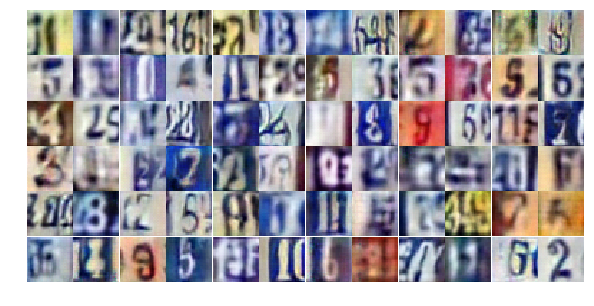

Epoch 27/30... Discriminator Loss: 0.7490... Generator Loss: 0.9573
Epoch 27/30... Discriminator Loss: 1.7274... Generator Loss: 0.3057
Epoch 27/30... Discriminator Loss: 0.5713... Generator Loss: 1.8656
Epoch 27/30... Discriminator Loss: 1.0447... Generator Loss: 0.7382
Epoch 27/30... Discriminator Loss: 1.6248... Generator Loss: 0.3367
Epoch 27/30... Discriminator Loss: 0.7919... Generator Loss: 2.3384
Epoch 27/30... Discriminator Loss: 0.7210... Generator Loss: 1.2508
Epoch 27/30... Discriminator Loss: 1.1755... Generator Loss: 0.5421
Epoch 27/30... Discriminator Loss: 0.6202... Generator Loss: 1.2459
Epoch 27/30... Discriminator Loss: 1.3484... Generator Loss: 0.4596


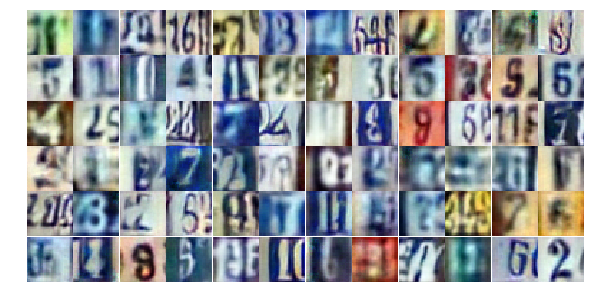

Epoch 27/30... Discriminator Loss: 0.3533... Generator Loss: 1.9671
Epoch 27/30... Discriminator Loss: 0.5638... Generator Loss: 1.4172
Epoch 27/30... Discriminator Loss: 1.8330... Generator Loss: 0.2750
Epoch 27/30... Discriminator Loss: 0.8116... Generator Loss: 1.4585
Epoch 27/30... Discriminator Loss: 0.5769... Generator Loss: 1.1599
Epoch 27/30... Discriminator Loss: 0.7103... Generator Loss: 2.0347
Epoch 27/30... Discriminator Loss: 0.4944... Generator Loss: 1.3394
Epoch 27/30... Discriminator Loss: 1.1238... Generator Loss: 0.5760
Epoch 27/30... Discriminator Loss: 0.9123... Generator Loss: 0.7784
Epoch 27/30... Discriminator Loss: 1.4221... Generator Loss: 0.3814


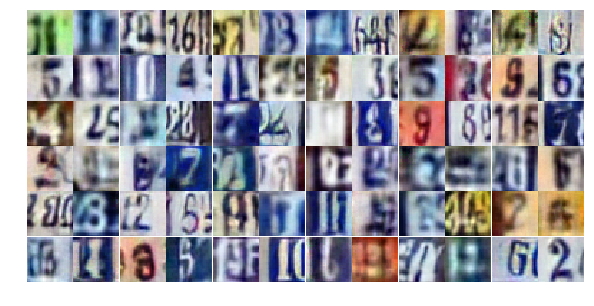

Epoch 27/30... Discriminator Loss: 0.8275... Generator Loss: 0.7734
Epoch 27/30... Discriminator Loss: 1.2154... Generator Loss: 0.5063
Epoch 27/30... Discriminator Loss: 1.0847... Generator Loss: 0.8349
Epoch 27/30... Discriminator Loss: 0.8423... Generator Loss: 1.6587
Epoch 27/30... Discriminator Loss: 0.9318... Generator Loss: 1.4202
Epoch 27/30... Discriminator Loss: 1.3945... Generator Loss: 0.4668
Epoch 27/30... Discriminator Loss: 1.2928... Generator Loss: 0.5485
Epoch 28/30... Discriminator Loss: 1.0933... Generator Loss: 0.6129
Epoch 28/30... Discriminator Loss: 0.8787... Generator Loss: 0.8527
Epoch 28/30... Discriminator Loss: 1.0275... Generator Loss: 0.7252


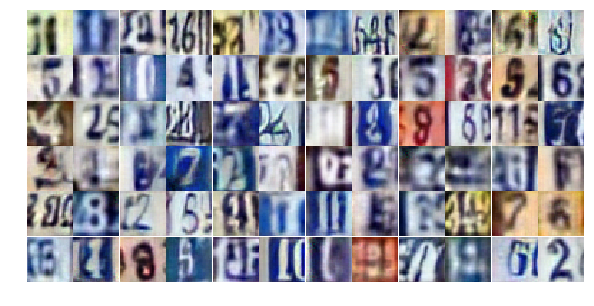

Epoch 28/30... Discriminator Loss: 0.7946... Generator Loss: 0.9146
Epoch 28/30... Discriminator Loss: 1.0141... Generator Loss: 0.6011
Epoch 28/30... Discriminator Loss: 0.9592... Generator Loss: 0.7674
Epoch 28/30... Discriminator Loss: 0.5340... Generator Loss: 1.4081
Epoch 28/30... Discriminator Loss: 1.1421... Generator Loss: 0.5794
Epoch 28/30... Discriminator Loss: 1.0136... Generator Loss: 0.7331
Epoch 28/30... Discriminator Loss: 0.6005... Generator Loss: 1.4802
Epoch 28/30... Discriminator Loss: 0.9212... Generator Loss: 0.7416
Epoch 28/30... Discriminator Loss: 1.4962... Generator Loss: 0.4448
Epoch 28/30... Discriminator Loss: 0.9047... Generator Loss: 0.7860


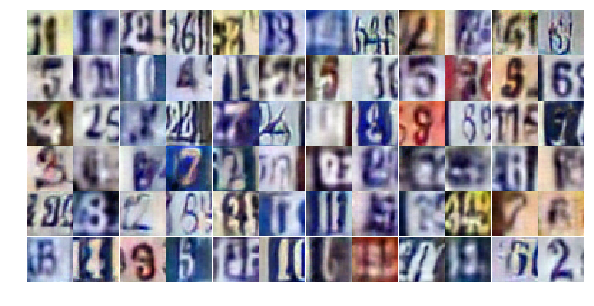

Epoch 28/30... Discriminator Loss: 0.6692... Generator Loss: 1.0582
Epoch 28/30... Discriminator Loss: 0.4130... Generator Loss: 1.5154
Epoch 28/30... Discriminator Loss: 0.2733... Generator Loss: 2.4965
Epoch 28/30... Discriminator Loss: 0.5093... Generator Loss: 1.3318
Epoch 28/30... Discriminator Loss: 1.2818... Generator Loss: 0.5125
Epoch 28/30... Discriminator Loss: 0.7844... Generator Loss: 1.1719
Epoch 28/30... Discriminator Loss: 0.5809... Generator Loss: 1.2231
Epoch 28/30... Discriminator Loss: 1.0910... Generator Loss: 0.6265
Epoch 28/30... Discriminator Loss: 0.7514... Generator Loss: 0.9336
Epoch 28/30... Discriminator Loss: 0.7005... Generator Loss: 1.0797


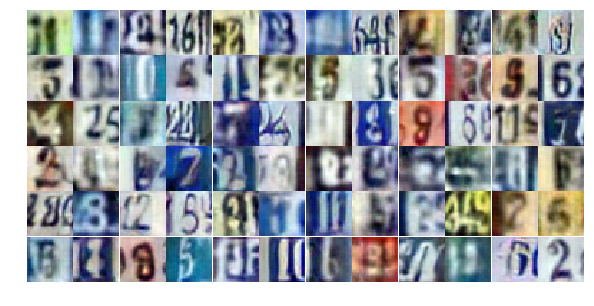

Epoch 28/30... Discriminator Loss: 0.9483... Generator Loss: 0.7646
Epoch 28/30... Discriminator Loss: 0.7764... Generator Loss: 0.9664
Epoch 28/30... Discriminator Loss: 0.5780... Generator Loss: 1.5490
Epoch 28/30... Discriminator Loss: 0.5717... Generator Loss: 1.4037
Epoch 28/30... Discriminator Loss: 1.3400... Generator Loss: 2.1973
Epoch 28/30... Discriminator Loss: 1.8193... Generator Loss: 0.6533
Epoch 28/30... Discriminator Loss: 1.1631... Generator Loss: 0.5803
Epoch 28/30... Discriminator Loss: 1.4868... Generator Loss: 0.3692
Epoch 28/30... Discriminator Loss: 0.9054... Generator Loss: 1.2078
Epoch 28/30... Discriminator Loss: 0.8582... Generator Loss: 0.8463


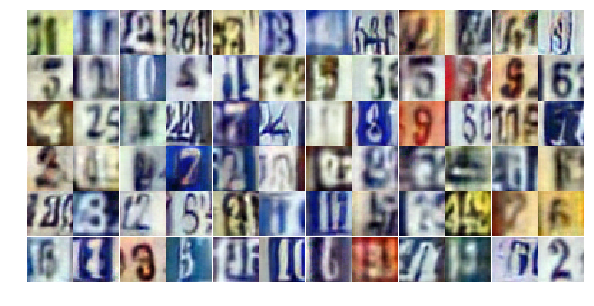

Epoch 28/30... Discriminator Loss: 0.4916... Generator Loss: 1.5136
Epoch 28/30... Discriminator Loss: 0.6375... Generator Loss: 1.1038
Epoch 28/30... Discriminator Loss: 1.1130... Generator Loss: 0.6498
Epoch 28/30... Discriminator Loss: 0.9071... Generator Loss: 0.8338
Epoch 28/30... Discriminator Loss: 0.5991... Generator Loss: 1.3124
Epoch 28/30... Discriminator Loss: 0.5579... Generator Loss: 1.2012
Epoch 28/30... Discriminator Loss: 0.8869... Generator Loss: 0.8495
Epoch 28/30... Discriminator Loss: 1.0621... Generator Loss: 0.6868
Epoch 28/30... Discriminator Loss: 0.3379... Generator Loss: 1.8490
Epoch 28/30... Discriminator Loss: 1.3268... Generator Loss: 0.4298


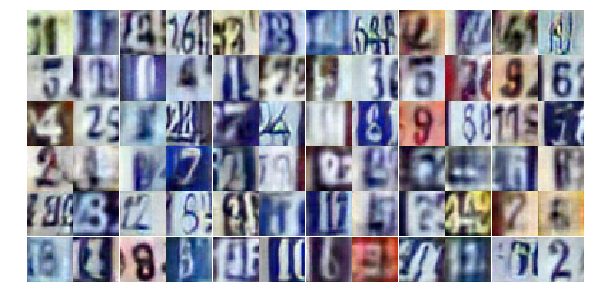

Epoch 28/30... Discriminator Loss: 3.3783... Generator Loss: 4.3290
Epoch 28/30... Discriminator Loss: 1.8018... Generator Loss: 0.2625
Epoch 28/30... Discriminator Loss: 0.3888... Generator Loss: 1.8507
Epoch 28/30... Discriminator Loss: 0.8835... Generator Loss: 0.8451
Epoch 28/30... Discriminator Loss: 0.8994... Generator Loss: 0.8265
Epoch 28/30... Discriminator Loss: 0.4945... Generator Loss: 1.5674
Epoch 28/30... Discriminator Loss: 1.1702... Generator Loss: 0.5679
Epoch 28/30... Discriminator Loss: 1.8267... Generator Loss: 0.2699
Epoch 28/30... Discriminator Loss: 0.9805... Generator Loss: 0.7795
Epoch 28/30... Discriminator Loss: 3.2303... Generator Loss: 4.7563


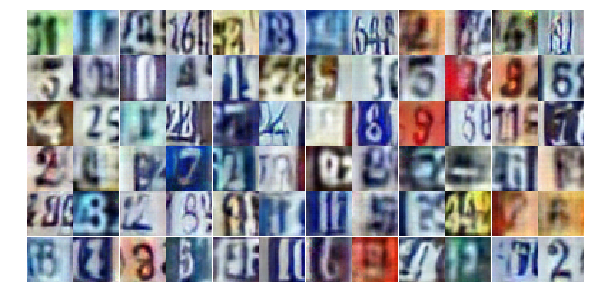

Epoch 28/30... Discriminator Loss: 1.1392... Generator Loss: 1.8075
Epoch 28/30... Discriminator Loss: 1.4595... Generator Loss: 0.4378
Epoch 28/30... Discriminator Loss: 0.8143... Generator Loss: 0.8478
Epoch 28/30... Discriminator Loss: 0.8070... Generator Loss: 0.9499
Epoch 29/30... Discriminator Loss: 1.2398... Generator Loss: 0.6627
Epoch 29/30... Discriminator Loss: 1.3968... Generator Loss: 0.4149
Epoch 29/30... Discriminator Loss: 0.7408... Generator Loss: 1.2255
Epoch 29/30... Discriminator Loss: 0.6503... Generator Loss: 1.0449
Epoch 29/30... Discriminator Loss: 0.8260... Generator Loss: 0.9326
Epoch 29/30... Discriminator Loss: 0.8963... Generator Loss: 0.8049


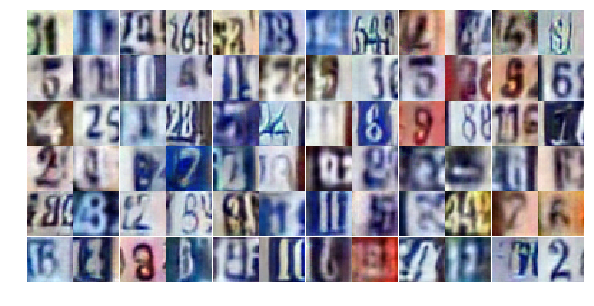

Epoch 29/30... Discriminator Loss: 1.0325... Generator Loss: 0.6742
Epoch 29/30... Discriminator Loss: 0.8480... Generator Loss: 1.1658
Epoch 29/30... Discriminator Loss: 1.2034... Generator Loss: 0.6561
Epoch 29/30... Discriminator Loss: 1.1002... Generator Loss: 0.5832
Epoch 29/30... Discriminator Loss: 0.9641... Generator Loss: 0.6644
Epoch 29/30... Discriminator Loss: 1.0556... Generator Loss: 0.6464
Epoch 29/30... Discriminator Loss: 1.4600... Generator Loss: 0.3690
Epoch 29/30... Discriminator Loss: 0.9459... Generator Loss: 0.7457
Epoch 29/30... Discriminator Loss: 0.8642... Generator Loss: 1.0036
Epoch 29/30... Discriminator Loss: 0.9423... Generator Loss: 0.6816


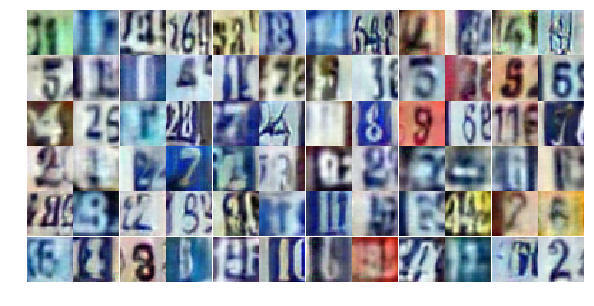

Epoch 29/30... Discriminator Loss: 0.4566... Generator Loss: 1.6270
Epoch 29/30... Discriminator Loss: 0.9812... Generator Loss: 0.9544
Epoch 29/30... Discriminator Loss: 0.7164... Generator Loss: 0.9461
Epoch 29/30... Discriminator Loss: 1.0510... Generator Loss: 0.6335
Epoch 29/30... Discriminator Loss: 1.1763... Generator Loss: 0.5640
Epoch 29/30... Discriminator Loss: 1.0607... Generator Loss: 0.5930
Epoch 29/30... Discriminator Loss: 0.8361... Generator Loss: 0.7975
Epoch 29/30... Discriminator Loss: 1.4663... Generator Loss: 0.3773
Epoch 29/30... Discriminator Loss: 1.0902... Generator Loss: 0.6053
Epoch 29/30... Discriminator Loss: 1.3444... Generator Loss: 0.4425


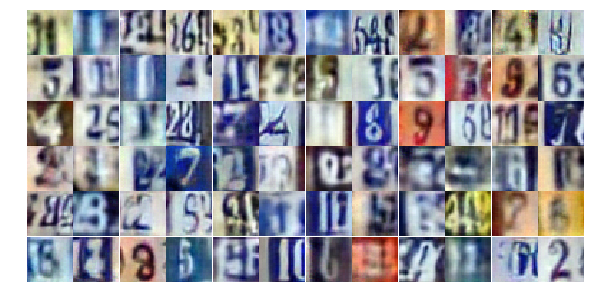

Epoch 29/30... Discriminator Loss: 0.5954... Generator Loss: 1.0444
Epoch 29/30... Discriminator Loss: 0.8188... Generator Loss: 0.9644
Epoch 29/30... Discriminator Loss: 1.3768... Generator Loss: 0.5408
Epoch 29/30... Discriminator Loss: 1.0564... Generator Loss: 0.7888
Epoch 29/30... Discriminator Loss: 0.8814... Generator Loss: 0.7933
Epoch 29/30... Discriminator Loss: 1.3611... Generator Loss: 0.4219
Epoch 29/30... Discriminator Loss: 0.9050... Generator Loss: 0.7753
Epoch 29/30... Discriminator Loss: 0.6317... Generator Loss: 1.2289
Epoch 29/30... Discriminator Loss: 2.1853... Generator Loss: 0.1903
Epoch 29/30... Discriminator Loss: 0.6216... Generator Loss: 1.4057


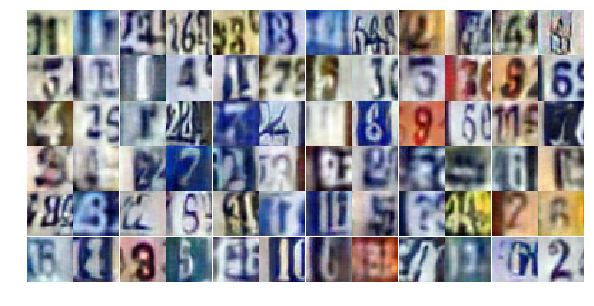

Epoch 29/30... Discriminator Loss: 0.2216... Generator Loss: 2.8603
Epoch 29/30... Discriminator Loss: 1.1033... Generator Loss: 0.6294
Epoch 29/30... Discriminator Loss: 0.6257... Generator Loss: 1.1070
Epoch 29/30... Discriminator Loss: 0.5938... Generator Loss: 1.1760
Epoch 29/30... Discriminator Loss: 1.1216... Generator Loss: 0.5674
Epoch 29/30... Discriminator Loss: 1.1443... Generator Loss: 0.6315
Epoch 29/30... Discriminator Loss: 0.9482... Generator Loss: 0.7187
Epoch 29/30... Discriminator Loss: 0.7396... Generator Loss: 0.9923
Epoch 29/30... Discriminator Loss: 0.7182... Generator Loss: 1.0407
Epoch 29/30... Discriminator Loss: 0.9746... Generator Loss: 0.6592


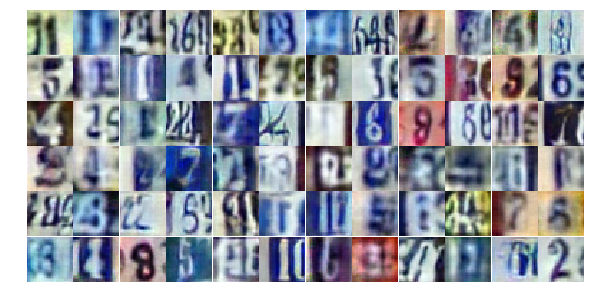

Epoch 29/30... Discriminator Loss: 0.6088... Generator Loss: 1.1527
Epoch 29/30... Discriminator Loss: 0.8666... Generator Loss: 0.8773
Epoch 29/30... Discriminator Loss: 0.9905... Generator Loss: 0.7984
Epoch 29/30... Discriminator Loss: 1.0703... Generator Loss: 0.6169
Epoch 29/30... Discriminator Loss: 1.0808... Generator Loss: 0.6610
Epoch 29/30... Discriminator Loss: 0.5728... Generator Loss: 1.9766
Epoch 29/30... Discriminator Loss: 1.5168... Generator Loss: 0.3697
Epoch 29/30... Discriminator Loss: 1.1469... Generator Loss: 1.5735
Epoch 29/30... Discriminator Loss: 0.7085... Generator Loss: 1.1407
Epoch 29/30... Discriminator Loss: 1.7441... Generator Loss: 0.2537


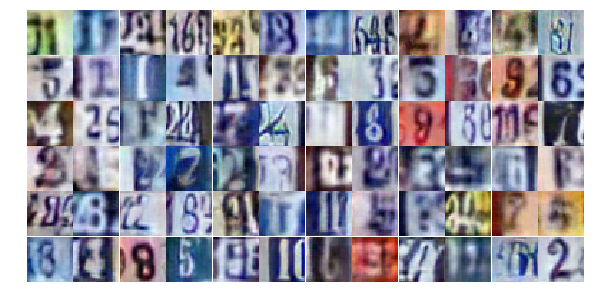

Epoch 29/30... Discriminator Loss: 0.5200... Generator Loss: 1.4102
Epoch 30/30... Discriminator Loss: 1.2626... Generator Loss: 0.5270
Epoch 30/30... Discriminator Loss: 0.3905... Generator Loss: 2.1165
Epoch 30/30... Discriminator Loss: 0.7977... Generator Loss: 0.8879
Epoch 30/30... Discriminator Loss: 1.4950... Generator Loss: 0.4105
Epoch 30/30... Discriminator Loss: 0.8435... Generator Loss: 0.7949
Epoch 30/30... Discriminator Loss: 0.7568... Generator Loss: 0.8490
Epoch 30/30... Discriminator Loss: 0.5152... Generator Loss: 1.3789
Epoch 30/30... Discriminator Loss: 0.9858... Generator Loss: 0.7137
Epoch 30/30... Discriminator Loss: 0.7443... Generator Loss: 1.0922


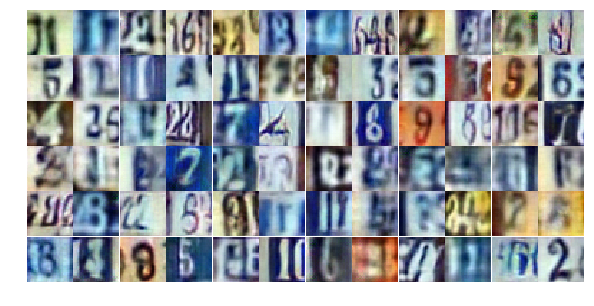

Epoch 30/30... Discriminator Loss: 0.9185... Generator Loss: 1.0240
Epoch 30/30... Discriminator Loss: 0.9549... Generator Loss: 0.7441
Epoch 30/30... Discriminator Loss: 0.7598... Generator Loss: 0.8767
Epoch 30/30... Discriminator Loss: 1.3974... Generator Loss: 0.4674
Epoch 30/30... Discriminator Loss: 1.3681... Generator Loss: 0.4388
Epoch 30/30... Discriminator Loss: 0.9690... Generator Loss: 0.7795
Epoch 30/30... Discriminator Loss: 0.9227... Generator Loss: 0.7255
Epoch 30/30... Discriminator Loss: 0.8710... Generator Loss: 0.7978
Epoch 30/30... Discriminator Loss: 0.8842... Generator Loss: 0.8414
Epoch 30/30... Discriminator Loss: 1.3799... Generator Loss: 0.4589


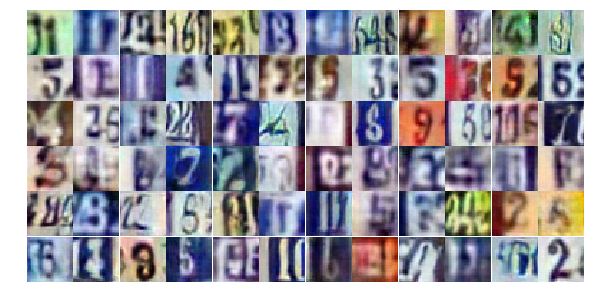

Epoch 30/30... Discriminator Loss: 0.8038... Generator Loss: 0.9476
Epoch 30/30... Discriminator Loss: 1.0730... Generator Loss: 0.6556
Epoch 30/30... Discriminator Loss: 0.9074... Generator Loss: 0.8951
Epoch 30/30... Discriminator Loss: 0.5660... Generator Loss: 1.4642
Epoch 30/30... Discriminator Loss: 0.9675... Generator Loss: 0.7171
Epoch 30/30... Discriminator Loss: 0.4971... Generator Loss: 1.2592
Epoch 30/30... Discriminator Loss: 1.0916... Generator Loss: 0.6446
Epoch 30/30... Discriminator Loss: 0.5366... Generator Loss: 1.4925
Epoch 30/30... Discriminator Loss: 0.6504... Generator Loss: 1.1345
Epoch 30/30... Discriminator Loss: 0.9604... Generator Loss: 0.7875


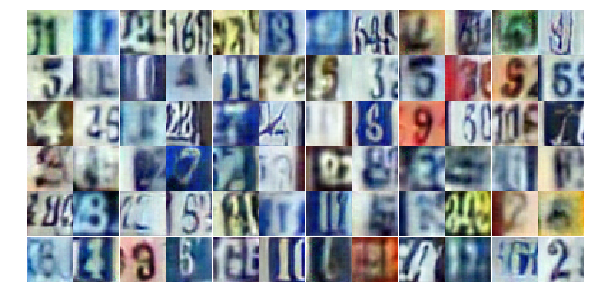

Epoch 30/30... Discriminator Loss: 1.8368... Generator Loss: 0.3207
Epoch 30/30... Discriminator Loss: 1.5582... Generator Loss: 0.3394
Epoch 30/30... Discriminator Loss: 0.4410... Generator Loss: 1.5209
Epoch 30/30... Discriminator Loss: 0.8380... Generator Loss: 0.8678
Epoch 30/30... Discriminator Loss: 0.9435... Generator Loss: 0.7376
Epoch 30/30... Discriminator Loss: 0.7528... Generator Loss: 1.1237
Epoch 30/30... Discriminator Loss: 0.9140... Generator Loss: 0.7481
Epoch 30/30... Discriminator Loss: 1.0877... Generator Loss: 0.6154
Epoch 30/30... Discriminator Loss: 0.8782... Generator Loss: 0.7970
Epoch 30/30... Discriminator Loss: 0.9401... Generator Loss: 0.9279


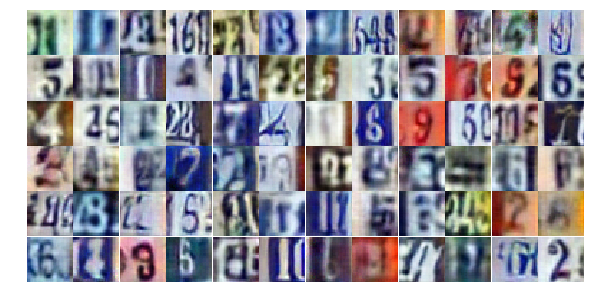

Epoch 30/30... Discriminator Loss: 0.8916... Generator Loss: 0.8887
Epoch 30/30... Discriminator Loss: 0.7212... Generator Loss: 1.5135
Epoch 30/30... Discriminator Loss: 0.5096... Generator Loss: 1.3765
Epoch 30/30... Discriminator Loss: 0.5091... Generator Loss: 1.3083
Epoch 30/30... Discriminator Loss: 0.8822... Generator Loss: 0.7730
Epoch 30/30... Discriminator Loss: 0.9004... Generator Loss: 2.6489
Epoch 30/30... Discriminator Loss: 0.9805... Generator Loss: 0.7604
Epoch 30/30... Discriminator Loss: 2.4028... Generator Loss: 3.1816
Epoch 30/30... Discriminator Loss: 1.7050... Generator Loss: 0.4170
Epoch 30/30... Discriminator Loss: 0.7305... Generator Loss: 1.0320


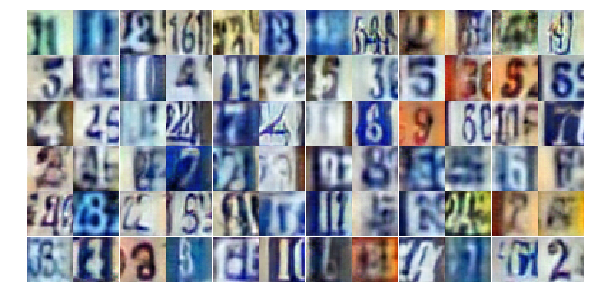

Epoch 30/30... Discriminator Loss: 0.6352... Generator Loss: 1.3145
Epoch 30/30... Discriminator Loss: 1.0462... Generator Loss: 0.6576
Epoch 30/30... Discriminator Loss: 0.8180... Generator Loss: 0.8821
Epoch 30/30... Discriminator Loss: 0.4978... Generator Loss: 1.3882
Epoch 30/30... Discriminator Loss: 0.7144... Generator Loss: 1.4338
Epoch 30/30... Discriminator Loss: 0.5814... Generator Loss: 1.5671
Epoch 30/30... Discriminator Loss: 1.1122... Generator Loss: 1.9930
Epoch 30/30... Discriminator Loss: 0.4807... Generator Loss: 1.4715
Epoch 30/30... Discriminator Loss: 0.6901... Generator Loss: 1.0863


In [21]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

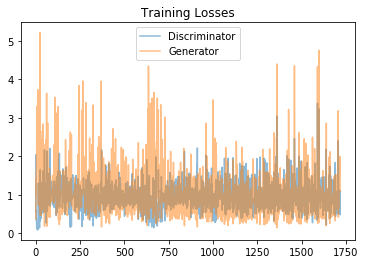

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

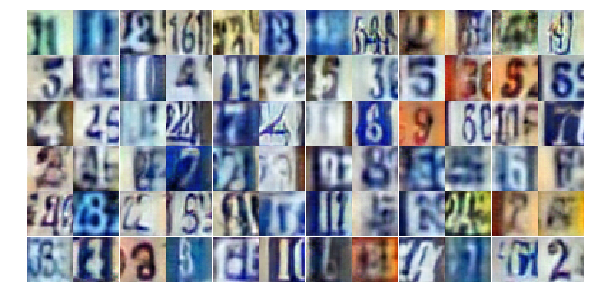

In [23]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))